In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.ticker as mtick
from matplotlib_inline.backend_inline import set_matplotlib_formats
import numpy as np
import seaborn as sns
from scipy import stats
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster
from sklearn.preprocessing import StandardScaler, OneHotEncoder, FunctionTransformer, MinMaxScaler
from sklearn.compose import ColumnTransformer
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.metrics import davies_bouldin_score
from sklearn.impute import SimpleImputer
from sklearn.metrics import adjusted_rand_score
from sklearn.metrics import calinski_harabasz_score
from typing import Dict, Optional, Tuple
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sentence_transformers import SentenceTransformer
from lightgbm import LGBMClassifier
from sklearn.metrics import roc_auc_score, average_precision_score, precision_recall_curve
from sklearn.metrics import precision_score
import lightgbm as lgb
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score, recall_score, f1_score, classification_report
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error, r2_score, root_mean_squared_error
from sklearn.inspection import permutation_importance
from scipy import stats
from collections import defaultdict
from math import log2
from scipy.sparse import coo_matrix
from sklearn.decomposition import TruncatedSVD
# import warnings
# warnings.filterwarnings('ignore')



In [2]:
# 한글 폰트
plt.rc("font", family = 'AppleGothic')
plt.rc("axes", unicode_minus = False)

# 글씨 선명하게
set_matplotlib_formats("retina")

In [3]:
ads_sch = pd.read_csv('/Users/t2023-m0052/Documents/GitHub/final_project/data/cv_goal.csv')
ads_sch.iloc[:, 1:]
print(f"데이터 수 : {ads_sch.shape}")
ads_sch.head()

데이터 수 : (527696, 12)


,Unnamed: 0,sch_idx,ads_idx,sch_type,mda_idx_arr,sch_sdatetime,sch_edatetime,sch_adv_pay,sch_ads_pay,sch_mda_pay,sch_clk_num,sch_turn_num
0,0,1257478,463989,M,"562,563",2025-09-11 09:42:03,9999-12-31 23:59:59,18,18,14,99999999,14
1,1,1257477,463989,A,NaN,2025-09-11 09:42:03,9999-12-31 23:59:59,18,18,12,99999999,14
2,2,1257476,463988,M,"562,563",2025-09-11 09:42:02,9999-12-31 23:59:59,18,18,14,99999999,18
3,3,1257475,463988,A,NaN,2025-09-11 09:42:02,9999-12-31 23:59:59,18,18,12,99999999,18
4,4,1257474,463987,M,"562,563",2025-09-11 09:41:55,9999-12-31 23:59:59,18,18,14,99999999,7


In [4]:
ads_sch.columns

Index(['Unnamed: 0', 'sch_idx', 'ads_idx', 'sch_type', 'mda_idx_arr',
       'sch_sdatetime', 'sch_edatetime', 'sch_adv_pay', 'sch_ads_pay',
       'sch_mda_pay', 'sch_clk_num', 'sch_turn_num'],
      dtype='object')

In [5]:
ads_time = pd.read_csv('/Users/t2023-m0052/Documents/GitHub/final_project/data/수정_시간별적립보고서.csv')
print(f"데이터 수 : {ads_time.shape}")
ads_time.head()

데이터 수 : (279916, 10)


,rpt_time_date,rpt_time_time,ads_idx,mda_idx,rpt_time_clk,rpt_time_turn,rpt_time_acost,rpt_time_earn,weekday,week_type
0,2025-07-27,0,11059,398,5,0,0,0,6,주말
1,2025-07-27,0,13209,583,3,0,0,0,6,주말
2,2025-07-27,0,13928,303,3,3,510,360,6,주말
3,2025-07-27,0,13928,324,3,3,510,360,6,주말
4,2025-07-27,0,13928,340,6,6,1020,720,6,주말


In [6]:
ads_time.columns

Index(['rpt_time_date', 'rpt_time_time', 'ads_idx', 'mda_idx', 'rpt_time_clk',
       'rpt_time_turn', 'rpt_time_acost', 'rpt_time_earn', 'weekday',
       'week_type'],
      dtype='object')

In [7]:
ads_domain = pd.read_csv('/Users/t2023-m0052/Documents/GitHub/final_project/Sehee/광고도메인리스트_1년치.csv')
print(f"데이터 수 : {ads_domain.shape}")
ads_domain.head()

데이터 수 : (233408, 24)


,Unnamed: 0,domain,row_id,ads_idx,ads_code,aff_idx,adv_idx,ads_type,ads_category,ads_name,...,ads_sdate,ads_edate,ads_age_min,ads_age_max,ads_os_type,ads_contract_price,ads_reward_price,ads_order,ads_rejoin_type,regdate
0,0,금융,153088,154946,KoM69LPFUB,8,50,3,7,어센틱금융그룹 내보험조회,...,2025-02-12 10:00:00,2029-11-29 00:00:00,0,100,7,800,640,2444400,NONE,2025-02-12 10:18:46
1,21,게임,135518,137375,RBjgpLVOmR,71,910,3,8,DK모바일 리본 사전예약,...,2025-01-10 18:00:00,2030-01-01 00:00:00,0,100,7,200,150,2431500,NONE,2025-01-10 18:48:52
2,23,게임,427141,429013,TUSVjcBYtK,76,1355,3,5,인생존망겜(레벨 67 달성),...,2025-07-11 16:23:32,9999-12-31 23:59:59,0,100,2,9600,7200,2460500,NONE,2025-07-11 16:23:32
3,31,게임,161321,163182,OLNpNxxGJm,76,1355,3,5,고블린 우드: 타이쿤 유휴 심,...,2025-02-27 16:00:00,9999-12-31 23:59:59,0,100,2,4480,3360,2451800,NONE,2025-02-26 17:05:49
4,34,게임,161392,163254,r78MSmvuQk,76,1355,3,5,Save the Pets,...,2025-02-27 16:00:00,2031-01-03 00:00:00,0,100,1,1440,1080,2450800,NONE,2025-02-26 17:57:33


In [8]:
ads_list = pd.read_csv('/Users/t2023-m0052/Documents/GitHub/final_project/Sehee/수정2_광고목록.csv')
print(f"데이터 수 : {ads_list.shape}")
ads_list.head()

데이터 수 : (445039, 21)


,ads_idx,ads_code,aff_idx,adv_idx,ads_type,ads_category,ads_name,ads_icon_img,ads_summary,ads_save_way,...,ads_sdate,ads_edate,ads_age_min,ads_age_max,ads_os_type,ads_contract_price,ads_reward_price,ads_order,ads_rejoin_type,regdate
0,160,tr71opm6C1,6,10,1,1,리니지레드나이츠,https://lh3.googleusercontent.com/oDGXxngO9oOP...,[앱설명]<br />[설치형] 매력만점 영웅들과 소환수들이 함께하는 취향저격 RPG...,받기,...,2016-12-01 00:00:00,9999-12-31 23:59:59,0,100,2,170,150,982800,NONE,2017-04-06 13:19:53
1,284,xlNpfkgtLX,6,10,1,1,강철의함대:Ocean Overlord,http://nextapps-nas.aws.appang.kr/icon/2016122...,"[앱설명]<br />[설치형] 한, 중, 일 아시아 유저들과 함께 대규모 해상 전투...",받기,...,2016-12-29 00:00:00,9999-12-31 23:59:59,0,100,2,180,160,987200,NONE,2017-01-10 10:37:22
2,292,7Hj8V5QKiy,6,10,1,1,스노우 SNOW,http://nextapps-nas.aws.appang.kr/icon/2016092...,"[앱설명]<br />[설치형] 셀카, 얼굴인식 스티커, 꿀잼 카메라<br /><br...",받기,...,2016-12-29 00:00:00,9999-12-31 23:59:59,0,100,2,160,160,987300,NONE,2017-01-02 12:51:34
3,304,1RfxHJcuEe,6,10,2,1,서머너즈 워: 천공의 아레나,http://nextapps-nas.aws.appang.kr/icon/EecpHzP...,[앱설명]<br />[실행형] 전 세계 5000만 소환사들을 사로잡은 명작 RPG<...,최초 오픈,...,2017-01-01 00:00:00,9999-12-31 23:59:59,0,100,2,230,210,931000,NONE,2017-03-30 17:05:23
4,306,l3GyilYEVk,6,10,1,1,하이마트,http://nextapps-nas.aws.appang.kr/icon/2016032...,새롭게 단장한 하이마트 쇼핑몰 앱!,받기,...,2017-01-01 00:00:00,2019-11-01 00:00:00,0,100,2,170,140,1155100,NONE,2017-06-12 15:24:46


In [9]:
ads_rwd = pd.read_csv('/Users/t2023-m0052/Documents/GitHub/final_project/data/수정_광고적립.csv')
print(f"데이터 수 : {ads_rwd.shape}")
ads_rwd.head()

데이터 수 : (1475031, 14)


,rwd_idx,ads_idx,ads_code,mda_idx,pub_sub_rel_id,dvc_idx,advid,click_key,adv_cost,earn_cost,click_date,regdate,ctit,cost_diff
0,238304818,413490,CFZ6lzEmeD,22,27496512,32947806,09b6a808-4f76-4584-87c5-626f21f472a0,b0e22dba943810794d25c993dff425c4e16d0744,190,120,2025-07-26 00:00:31,2025-07-26 00:05:02,271,70
1,238304829,413490,CFZ6lzEmeD,22,27496512,47387244,ba4fd0c8-4f06-4dfa-9c3f-c6b39ee7066e,0679ff4c6a14beba296e44d7ffdd88129f42ffbf,190,120,2025-07-26 00:00:32,2025-07-26 00:08:17,465,70
2,238304816,413490,CFZ6lzEmeD,22,27496512,32425124,64c675d0-8edd-4478-9906-a806651fdf92,68eb28d636724061da21e490a1afff6a39cd78f7,190,120,2025-07-26 00:00:42,2025-07-26 00:04:43,241,70
3,238304817,413490,CFZ6lzEmeD,22,27496513,34006545,a08ebb04-e70a-4492-89d4-17fa96bf8c75,37da42f12b6f732d8c8bf1a609c01e569b7f8a09,190,120,2025-07-26 00:00:54,2025-07-26 00:04:45,231,70
4,238304802,133653,rl8ud4uNQC,801,1,56867331,dbe54f40-41b5-4423-ae2f-048fd6ecf5af,624b1bbc57c9ea81005c74e1956d48e76d974816,260,195,2025-07-26 00:01:07,2025-07-26 00:02:04,57,65


In [10]:
ads_info = pd.read_csv('/Users/t2023-m0052/Documents/GitHub/final_project/data/수정2_광고참여정보.csv')
print(f"데이터 수 : {ads_info.shape}")
ads_info.head()

데이터 수 : (16854865, 14)


,click_key,ads_idx,dvc_idx,mda_idx,pub_sub_rel_id,contract_price,media_price,click_day,click_time,click_date,exp_day,network,user_ip,converted
0,000000d54b9faad47ee99d6cd3cf53894dd4baa5,313780,61906528,539,144350110,6000,4500,2025-08-17,21,2025-08-17 21:07:37,2025-09-16,0,16.184.28.219,0
1,000002b4d92f7648b455877c2676452efcd22a09,412426,34422806,58,46032732,180,170,2025-07-26,2,2025-07-26 02:18:24,2025-08-25,NaN,35.78.117.76,1
2,0000057e97361ff3d0263aaecee34cfaa3ba30fb,443660,38366075,808,1,170,120,2025-08-12,18,2025-08-12 18:17:59,2025-09-11,WIFI,39.7.55.192,1
3,00000607f60139015da3ee1dd5499db3faa100dc,360192,61894110,539,144350110,6000,4500,2025-08-17,3,2025-08-17 03:35:02,2025-09-16,0,211.252.100.157,0
4,0000066bc25d4a6d147c27326cf972a4de88024e,372307,61956954,539,144350110,15600,11700,2025-08-18,8,2025-08-18 08:01:26,2025-09-17,0,3.38.148.211,0


In [11]:
ads_join = pd.read_csv('/Users/t2023-m0052/Documents/GitHub/final_project/data/참여적립조인.csv')
print(f"데이터 수 : {ads_join.shape}")
ads_join.head()

데이터 수 : (16854865, 22)


,Unnamed: 0,click_key,ads_idx,dvc_idx,mda_idx,pub_sub_rel_id,contract_price,media_price,click_day,click_time,...,network,user_ip,rwd_idx,ads_code,advid,adv_cost,earn_cost,regdate,ctit,conversion
0,0,000000d54b9faad47ee99d6cd3cf53894dd4baa5,313780,61906528,539,144350110,6000,4500,2025-08-17,21,...,0,16.184.28.219,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
1,1,000002b4d92f7648b455877c2676452efcd22a09,412426,34422806,58,46032732,180,170,2025-07-26,2,...,NaN,35.78.117.76,238313226.0,yuRe4YoPuZ,40ceb01c-9b60-4452-bacd-0e061fb18ab4,180.0,170.0,2025-07-26 02:19:21,57.0,1
2,2,0000057e97361ff3d0263aaecee34cfaa3ba30fb,443660,38366075,808,1,170,120,2025-08-12,18,...,WIFI,39.7.55.192,239017177.0,WuIp8HKmt9,73793f44-a471-4351-ae1c-d09accaf223a,170.0,120.0,2025-08-12 18:19:21,82.0,1
3,3,00000607f60139015da3ee1dd5499db3faa100dc,360192,61894110,539,144350110,6000,4500,2025-08-17,3,...,0,211.252.100.157,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0
4,4,0000066bc25d4a6d147c27326cf972a4de88024e,372307,61956954,539,144350110,15600,11700,2025-08-18,8,...,0,3.38.148.211,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0


In [12]:
ads_total = pd.read_csv('/Users/t2023-m0052/Documents/GitHub/final_project/data/시간별적립보고서_1년치.csv')
print(f"데이터 수 : {ads_total.shape}")
ads_total.head()

데이터 수 : (6953146, 12)


,rpt_time_date,rpt_time_time,ads_idx,mda_idx,rpt_time_clk,rpt_time_turn,rpt_time_scost,rpt_time_acost,rpt_time_cost,rpt_time_earn,weekday,week_type
0,2024-07-27,0,4418,761,1,0,0,0,0,0,5,주말
1,2024-07-27,0,7377,213,1,0,0,0,0,0,5,주말
2,2024-07-27,0,7377,337,1,0,0,0,0,0,5,주말
3,2024-07-27,0,7377,496,1,1,230,230,180,180,5,주말
4,2024-07-27,0,7528,792,1,0,0,0,0,0,5,주말


In [13]:
ads_segment = pd.read_csv('/Users/t2023-m0052/Documents/GitHub/final_project/data/ads_segment.csv')
print(f"데이터 수 : {ads_segment.shape}")
ads_segment.head()

데이터 수 : (9517, 40)


,Unnamed: 0,ads_idx,media_count,user_count,total_clicks,total_conversions,ads_category,domain,ads_os_type,ads_order,...,performance_level,ads_level,media_score,conv_score,clicks_score,stability_score,cvr_score,total_score,ads_size,cluster
0,0,6508,1,1,2,0,10,금융,7,2381500,...,LOW,SMALL_LOW,1,0,0,0,0,1,SMALL,0
1,1,6985,2,30,46,0,7,금융,7,1201938,...,LOW,MEDIUM_LOW,2,0,0,3,0,5,MEDIUM,0
2,2,8327,1,6,11,0,10,미디어/컨텐츠,7,1673458,...,LOW,SMALL_LOW,1,0,0,3,0,4,SMALL,0
3,3,9264,1,1,1,0,10,금융,7,2372800,...,LOW,SMALL_LOW,1,0,0,0,0,1,SMALL,0
4,4,9716,2,4,6,1,8,생활,2,2699900,...,LOW,MEDIUM_LOW,2,0,1,1,0,4,SMALL,0


In [14]:
ads_segment.columns

Index(['Unnamed: 0', 'ads_idx', 'media_count', 'user_count', 'total_clicks',
       'total_conversions', 'ads_category', 'domain', 'ads_os_type',
       'ads_order', 'ctit_mean', 'ctit_median', 'ads_rejoin_type',
       'contract_price', 'media_price', 'first_click', 'last_click',
       'ads_name', 'ads_sdate', 'expire', 'days_active',
       'daily_avg_conversions', 'cvr', 'margin', 'roi', 'total_net_return',
       'ads_level_detailed', 'daily_clicks', 'daily_users', 'scale_level',
       'performance_level', 'ads_level', 'media_score', 'conv_score',
       'clicks_score', 'stability_score', 'cvr_score', 'total_score',
       'ads_size', 'cluster'],
      dtype='object')

In [15]:
media_portfolio = pd.read_csv('/Users/t2023-m0052/Documents/GitHub/final_project/data/media_portfolio.csv')
print(f"데이터 수 : {media_portfolio.shape}")
media_portfolio.head()

데이터 수 : (189, 50)


,Unnamed: 0,mda_idx,user_count,total_clicks,total_conversions,first_click,last_click,days_active,daily_avg_conversions,LARGE,...,domain_비영리/공공_pct,domain_생활_pct,domain_식당/카페_pct,domain_식음료_pct,domain_운동/스포츠_pct,domain_운세_pct,domain_의료/건강_pct,domain_채용_pct,domain_커머스_pct,expected_total_profit
0,0,12,75700,232438,82938,2025-07-26 00:00:02,2025-08-25 11:22:16,31,2675.419355,7,...,16.666667,12.500000,0.00000,16.666667,0.000000,0.000000,4.166667,0.000000,12.500000,3003668
1,1,14,31834,84763,22983,2025-07-26 00:01:22,2025-08-25 11:22:40,31,741.387097,31,...,0.000000,13.559322,0.00000,3.389831,0.000000,0.000000,3.389831,1.694915,5.084746,2733547
2,2,18,2825,5961,250,2025-07-26 00:00:49,2025-08-25 11:13:19,31,8.064516,19,...,0.000000,8.695652,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,4.347826,182366
3,3,22,37668,83355,35232,2025-07-26 00:00:31,2025-08-25 11:14:50,31,1136.516129,67,...,3.012048,11.445783,0.60241,4.216867,1.204819,7.831325,4.819277,1.204819,7.228916,2541770
4,4,26,402,678,70,2025-07-26 01:45:31,2025-08-25 10:22:36,31,2.258065,10,...,0.000000,10.526316,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,10.526316,2690


In [16]:
media_portfolio.columns

Index(['Unnamed: 0', 'mda_idx', 'user_count', 'total_clicks',
       'total_conversions', 'first_click', 'last_click', 'days_active',
       'daily_avg_conversions', 'LARGE', 'MEDIUM', 'MEGA', 'SMALL',
       'total_ads', 'MEGA_ratio', 'LARGE_ratio', 'MEDIUM_ratio', 'SMALL_ratio',
       'ads_category_0_pct', 'ads_category_1_pct', 'ads_category_2_pct',
       'ads_category_3_pct', 'ads_category_4_pct', 'ads_category_5_pct',
       'ads_category_6_pct', 'ads_category_7_pct', 'ads_category_8_pct',
       'ads_category_10_pct', 'ads_category_11_pct', 'ads_category_13_pct',
       'ads_os_type_1_pct', 'ads_os_type_2_pct', 'ads_os_type_3_pct',
       'ads_os_type_7_pct', 'domain_게임_pct', 'domain_교육_pct', 'domain_금융_pct',
       'domain_기타_pct', 'domain_미디어/컨텐츠_pct', 'domain_뷰티_pct',
       'domain_비영리/공공_pct', 'domain_생활_pct', 'domain_식당/카페_pct',
       'domain_식음료_pct', 'domain_운동/스포츠_pct', 'domain_운세_pct',
       'domain_의료/건강_pct', 'domain_채용_pct', 'domain_커머스_pct',
       'expected_tota

In [17]:
at = ads_time.copy()
at["rpt_time_turn"] = pd.to_numeric(at["rpt_time_turn"], errors="coerce").fillna(0)

# 광고별 전환수 합
ad_conv = (at.groupby("ads_idx", as_index=False)["rpt_time_turn"]
             .sum().rename(columns={"rpt_time_turn":"conv_total"}))

# 랭킹(내림차순, 1=최고)
ad_conv["rank_desc"] = ad_conv["conv_total"].rank(method="dense", ascending=False).astype(int)

# 백분위(상위일수록 1에 가까움)
ad_conv["percentile"] = ad_conv["conv_total"].rank(pct=True, ascending=True)  # 하위→0, 상위→1

# Top-K 라벨(예: 상위 20개=1)
K = 20
ad_conv["label_topK"] = (ad_conv["rank_desc"] <= K).astype(int)

# (선택) 10분위 라벨(1=최상위, 10=최하위) — qcut 안전 처리
try:
    ad_conv["decile"] = pd.qcut(ad_conv["conv_total"].rank(method="first"),
                                10, labels=list(range(10,0,-1))).astype(int)
except ValueError:
    # 유니크 값이 적을 때 대비: 동일값에 작은 잡음 추가
    tmp = ad_conv["conv_total"] + np.random.uniform(0, 1e-6, size=len(ad_conv))
    ad_conv["decile"] = pd.qcut(pd.Series(tmp).rank(method="first"),
                                10, labels=list(range(10,0,-1))).astype(int)

# (선택) 0~1 정규화 점수
mn, mx = ad_conv["conv_total"].min(), ad_conv["conv_total"].max()
ad_conv["conv_norm01"] = ((ad_conv["conv_total"] - mn) / (mx - mn)) if mx > mn else 0.0

# 원본에 매핑해서 붙이고 싶으면:
ads_time = ads_time.merge(ad_conv, on="ads_idx", how="left")


In [18]:
ads_time.head()

,rpt_time_date,rpt_time_time,ads_idx,mda_idx,rpt_time_clk,rpt_time_turn,rpt_time_acost,rpt_time_earn,weekday,week_type,conv_total,rank_desc,percentile,label_topK,decile,conv_norm01
0,2025-07-27,0,11059,398,5,0,0,0,6,주말,6,405,0.491479,0,6,0.000051
1,2025-07-27,0,13209,583,3,0,0,0,6,주말,160,251,0.946089,0,1,0.001362
2,2025-07-27,0,13928,303,3,3,510,360,6,주말,2748,46,0.995084,0,1,0.023393
3,2025-07-27,0,13928,324,3,3,510,360,6,주말,2748,46,0.995084,0,1,0.023393
4,2025-07-27,0,13928,340,6,6,1020,720,6,주말,2748,46,0.995084,0,1,0.023393


In [19]:
# try: LightGBM
try:
    from lightgbm import LGBMRegressor
except Exception as e:
    raise ImportError("lightgbm가 필요합니다: pip install lightgbm") from e

# ------------------------------
# 1) 사전 설정
# ------------------------------
DATE_COLS_CAND = ["first_click", "last_click", "ads_sdate", "expire"]
ID_LIKE = ["ads_idx", "ads_name"]  # 모델 입력에 불필요
LEAKY_FOR_TOTAL_SCORE = ["media_score","conv_score","clicks_score","stability_score","cvr_score","total_score"]

def _to_dt(s):
    return pd.to_datetime(s, errors="coerce")

def _to_num(s):
    return pd.to_numeric(s, errors="coerce")

def build_dataset_for_importance(df: pd.DataFrame, target_col: str = "total_conversions",
                                 drop_leaky: bool = True) -> tuple[pd.DataFrame, pd.Series, list, list]:
    """전처리: 날짜 파생 + 타입 분리 + (누수피처 제거 옵션)"""
    data = df.copy()

    # 1) 날짜 파생 (존재하는 것만)
    for c in DATE_COLS_CAND:
        if c in data.columns:
            data[c] = _to_dt(data[c])

    # 기준 날짜: 관측된 최신 날짜
    date_pool = [data[c].max() for c in DATE_COLS_CAND if c in data.columns]
    ref_date = pd.to_datetime(pd.Series(date_pool).max()) if date_pool else pd.Timestamp.utcnow().normalize()

    # 간단 파생: 일 수 단위 수치화
    if "first_click" in data.columns:
        data["first_click_days_ago"] = (ref_date - data["first_click"]).dt.days
    if "last_click" in data.columns:
        data["last_click_days_ago"]  = (ref_date - data["last_click"]).dt.days
    if {"first_click","last_click"}.issubset(data.columns):
        data["tenure_days"] = (data["last_click"] - data["first_click"]).dt.days
    if {"ads_sdate","expire"}.issubset(data.columns):
        data["campaign_days"] = (data["expire"] - data["ads_sdate"]).dt.days

    # 원래 날짜열은 제거(숫자 파생만 남김)
    data.drop(columns=[c for c in DATE_COLS_CAND if c in data.columns], inplace=True, errors="ignore")

    # 2) 타깃/피처 분리
    if target_col not in data.columns:
        raise ValueError(f"타깃 컬럼 {target_col} 이(가) 없습니다.")
    y = _to_num(data[target_col])
    X = data.drop(columns=[target_col])

    # 3) 불필요/ID/누수 피처 제거
    drop_cols = [c for c in ID_LIKE if c in X.columns]
    if drop_leaky and target_col == "total_score":
        drop_cols += [c for c in LEAKY_FOR_TOTAL_SCORE if c in X.columns]
    X = X.drop(columns=drop_cols, errors="ignore")

    # 4) 숫자/범주 판별
    num_cols = X.select_dtypes(include=[np.number, "float64", "int64", "float32", "int32"]).columns.tolist()
    cat_cols = [c for c in X.columns if c not in num_cols]

    return X, y, num_cols, cat_cols


def _make_ohe():
    """sklearn 버전 호환 OHE 생성자 (1.4+는 sparse_output, 구버전은 sparse)"""
    try:
        return OneHotEncoder(handle_unknown="ignore", sparse_output=False)  # sklearn >=1.2, 특히 1.4+
    except TypeError:
        return OneHotEncoder(handle_unknown="ignore", sparse=False)         # sklearn <1.2

def make_pipeline(num_cols, cat_cols):
    num_pipe = Pipeline([
        ("imp", SimpleImputer(strategy="median")),
        ("scaler", StandardScaler(with_mean=True, with_std=True)),
    ])
    cat_pipe = Pipeline([
        ("imp", SimpleImputer(strategy="most_frequent")),
        ("ohe", _make_ohe()),
    ])

    # cat_cols가 비어도 에러 없이 동작하도록 분기
    transformers = [("num", num_pipe, num_cols)]
    if len(cat_cols) > 0:
        transformers.append(("cat", cat_pipe, cat_cols))

    pre = ColumnTransformer(
        transformers,
        remainder="drop",
        verbose_feature_names_out=False
    )

    from lightgbm import LGBMRegressor
    model = LGBMRegressor(
        objective="regression",
        n_estimators=600,
        learning_rate=0.03,
        subsample=0.9,
        colsample_bytree=0.9,
        num_leaves=63,
        random_state=42
    )
    pipe = Pipeline([
        ("pre", pre),
        ("model", model)
    ])
    return pipe


def get_output_feature_names(pipe):
    """
    ColumnTransformer가 실제로 만들어낸 출력 컬럼명을 반환.
    최신 sklearn이면 get_feature_names_out() 사용, 아니면 수동 조립.
    """
    pre = pipe.named_steps["pre"]

    # 1) 최신 방식
    try:
        return pre.get_feature_names_out().tolist()
    except Exception:
        pass

    # 2) Fallback: transformers_로 수동 조립
    names = []
    try:
        for name, trans, cols in pre.transformers_:
            if name == "num":
                names += list(cols)
            elif name == "cat" and len(cols) > 0:
                ohe = trans.named_steps["ohe"]
                names += ohe.get_feature_names_out(cols).tolist()
    except Exception:
        pass
    return names


def plot_top_importances(names, importances, topn=20, title="Feature Importance (gain)"):
    idx = np.argsort(importances)[::-1][:topn]
    plt.figure(figsize=(8, max(4, topn*0.35)))
    plt.barh(np.array(names)[idx][::-1], np.array(importances)[idx][::-1])
    plt.title(title)
    plt.xlabel("importance")
    plt.tight_layout()
    plt.show()


# ------------------------------
# 2) 실행 예시
# ------------------------------
def run_feature_importance(df: pd.DataFrame, target_col: str = "total_conversions", topn: int = 20,
                           drop_leaky: bool = True):
    # A. 데이터셋 준비
    X, y, num_cols, cat_cols = build_dataset_for_importance(df, target_col, drop_leaky=drop_leaky)

    # B. split
    from sklearn.model_selection import train_test_split
    X_tr, X_te, y_tr, y_te = train_test_split(X, y, test_size=0.2, random_state=42)

    # C. 파이프라인 구성 & 학습
    pipe = make_pipeline(num_cols, cat_cols)
    pipe.fit(X_tr, y_tr)

    # 전처리 출력 특성명
    feat_names = get_output_feature_names(pipe)

    # D. 내장 중요도 (LightGBM gain)
    lgbm = pipe.named_steps["model"]
    gain_imp = lgbm.feature_importances_.astype(float)

    # 길이 맞추기
    n_g = min(len(feat_names), len(gain_imp))
    imp_df = (pd.DataFrame({"feature": feat_names[:n_g], "gain_importance": gain_imp[:n_g]})
                .sort_values("gain_importance", ascending=False))

    # E. Permutation Importance (검증셋)
    from sklearn.inspection import permutation_importance
    perm = permutation_importance(pipe, X_te, y_te, n_repeats=10, random_state=42, n_jobs=-1, scoring=None)

    n_p = min(len(feat_names), len(perm.importances_mean))
    perm_imp = (pd.DataFrame({
        "feature": feat_names[:n_p],
        "perm_importance_mean": perm.importances_mean[:n_p],
        "perm_importance_std":  perm.importances_std[:n_p],
    }).sort_values("perm_importance_mean", ascending=False))

    # F. 시각화 (원하면 사용)
    # plot_top_importances(imp_df["feature"].values, imp_df["gain_importance"].values, topn=topn,
    #                      title=f"LightGBM Gain Importance (target={target_col})")
    # plot_top_importances(perm_imp["feature"].values, perm_imp["perm_importance_mean"].values, topn=topn,
    #                      title=f"Permutation Importance (target={target_col})")

    return imp_df, perm_imp, pipe


# ------------------------------
# 3) (선택) SHAP 요약 플롯
# ------------------------------
def shap_summary(pipe, X_sample: pd.DataFrame, num_cols, cat_cols, max_display=20):
    """옵션: shap 설치 시 실행 (pip install shap)"""
    try:
        import shap
    except Exception as e:
        print("shap 라이브러리가 없어 summary를 건너뜁니다. pip install shap 로 설치하세요.")
        return None

    # 전처리부터 변환된 X 생성
    pre = pipe.named_steps["pre"]
    model = pipe.named_steps["model"]
    X_trans = pre.transform(X_sample)
    explainer = shap.TreeExplainer(model)
    shap_values = explainer.shap_values(X_trans)

    # 피처명
    pre_feat_names = get_feature_names(pipe, num_cols, cat_cols, X_sample)

    shap.summary_plot(shap_values, features=X_trans, feature_names=pre_feat_names, plot_type="bar", max_display=max_display)
    shap.summary_plot(shap_values, features=X_trans, feature_names=pre_feat_names, max_display=max_display)
    return shap_values


In [20]:
df_all = ads_segment.copy()

In [78]:
imp_gain, imp_perm, model = run_feature_importance(df_all, target_col="total_conversions", topn=25)

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3906
[LightGBM] [Info] Number of data points in the train set: 7613, number of used features: 74
[LightGBM] [Info] Start training from score 168.027059


/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/pyth

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000665 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3906
[LightGBM] [Info] Number of data points in the train set: 7613, number of used features: 74
[LightGBM] [Info] Start training from score 168.027059


/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/pyth


=== Top (Combined Rank) ===
              feature  gain_importance  perm_importance_mean  rank_mean
         total_clicks           2338.0          3.170731e-01        3.0
          daily_users           2474.0          2.766995e-01        3.5
               margin           2226.0          3.163646e-01        4.0
           user_count           2961.0          9.592402e-03        6.0
     total_net_return           4236.0          5.507130e-04        7.5
         daily_clicks           1485.0          5.791758e-02        7.5
            ctit_mean           1165.0          1.282447e-01        9.5
daily_avg_conversions           1500.0          6.618821e-03        9.5
       contract_price           1732.0          8.637645e-04       10.0
          media_count           1059.0          1.845704e-01       10.5
                  roi           1234.0          1.146026e-03       12.5
          days_active           1287.0          1.206535e-04       15.0
            ads_order           261

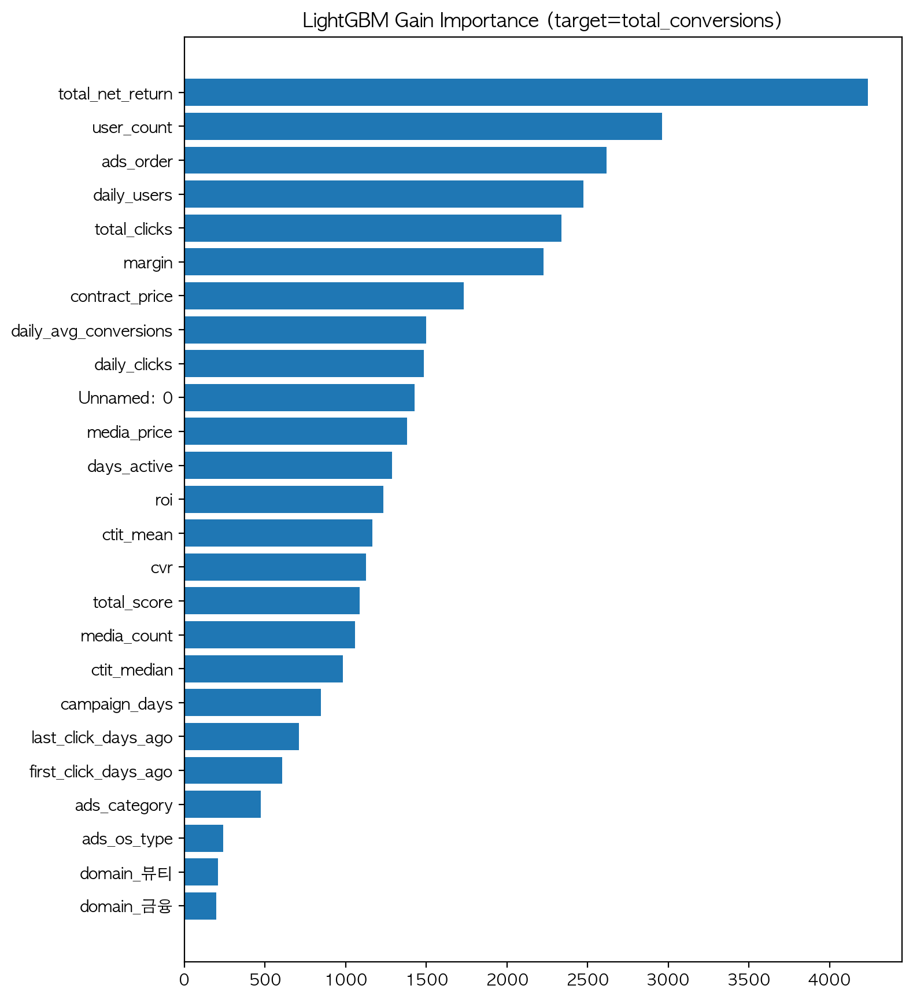

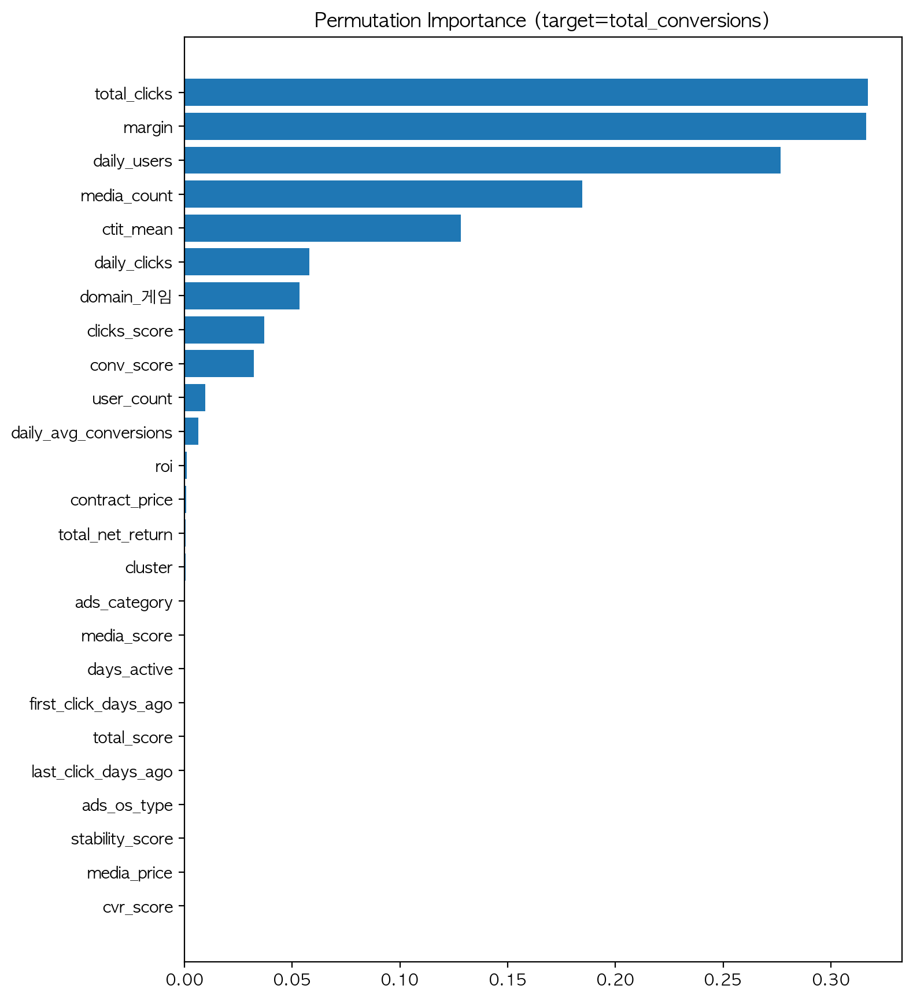

In [ ]:
# === 1) 전처리 출력 피처명 안전 획득 (패치 함수) ===
def get_output_feature_names(pipe):
    pre = pipe.named_steps["pre"]
    try:
        return pre.get_feature_names_out().tolist()  # 최신 sklearn
    except Exception:
        names = []
        for name, trans, cols in pre.transformers_:
            if name == "num":
                names += list(cols)
            elif name == "cat" and len(cols) > 0:
                ohe = trans.named_steps["ohe"]
                names += ohe.get_feature_names_out(cols).tolist()
        return names

# === 2) 한 번에 중요도 뽑는 함수 ===
def run_importance_quick(df, target_col="total_conversions", topn=20, drop_leaky=True):
    # 데이터 준비
    X, y, num_cols, cat_cols = build_dataset_for_importance(df, target_col, drop_leaky=drop_leaky)
    X_tr, X_te, y_tr, y_te = train_test_split(X, y, test_size=0.2, random_state=42)

    # 파이프라인 학습
    pipe = make_pipeline(num_cols, cat_cols)
    pipe.fit(X_tr, y_tr)

    # 피처명
    feat_names = get_output_feature_names(pipe)

    # (A) LGBM Gain 중요도
    lgbm = pipe.named_steps["model"]
    gain = lgbm.feature_importances_.astype(float)
    n_g = min(len(feat_names), len(gain))
    imp_gain = (pd.DataFrame({"feature": feat_names[:n_g], "gain_importance": gain[:n_g]})
                .sort_values("gain_importance", ascending=False))

    # (B) Permutation 중요도 (검증셋)
    perm = permutation_importance(pipe, X_te, y_te, n_repeats=10, random_state=42, n_jobs=-1)
    n_p = min(len(feat_names), len(perm.importances_mean))
    imp_perm = (pd.DataFrame({
        "feature": feat_names[:n_p],
        "perm_importance_mean": perm.importances_mean[:n_p],
        "perm_importance_std":  perm.importances_std[:n_p],
    }).sort_values("perm_importance_mean", ascending=False))

    # (C) 두 지표를 합쳐 Top-N 표 (순위 평균)
    rank_gain = imp_gain.assign(rank_gain=lambda d: d["gain_importance"].rank(ascending=False))
    rank_perm = imp_perm.assign(rank_perm=lambda d: d["perm_importance_mean"].rank(ascending=False))
    combo = (rank_gain[["feature","gain_importance","rank_gain"]]
             .merge(rank_perm[["feature","perm_importance_mean","rank_perm"]], on="feature", how="outer")
             .fillna({"rank_gain": 1e9, "rank_perm": 1e9}))  # 없는 항목은 꼴찌 취급
    combo["rank_mean"] = combo[["rank_gain","rank_perm"]].mean(axis=1)
    combo = combo.sort_values("rank_mean").head(topn)

    # 보기 좋게 출력
    print("\n=== Top (Combined Rank) ===")
    print(combo[["feature","gain_importance","perm_importance_mean","rank_mean"]].to_string(index=False))

    # 간단 막대그래프 (Gain 기준)
    plt.figure(figsize=(8, max(4, topn*0.35)))
    topg = imp_gain.head(topn)
    plt.barh(topg["feature"][::-1], topg["gain_importance"][::-1])
    plt.title(f"LightGBM Gain Importance (target={target_col})")
    plt.tight_layout()
    plt.show()

    # 간단 막대그래프 (Permutation 기준)
    plt.figure(figsize=(8, max(4, topn*0.35)))
    topp = imp_perm.head(topn)
    plt.barh(topp["feature"][::-1], topp["perm_importance_mean"][::-1])
    plt.title(f"Permutation Importance (target={target_col})")
    plt.tight_layout()
    plt.show()

    return imp_gain, imp_perm, combo, pipe

# === 3) 실행 ===
imp_gain, imp_perm, combo, pipe = run_importance_quick(df_all, target_col="total_conversions", topn=25, drop_leaky=True)


광고 34045 매체사 30번이랑 337추천 / 761 772 818 확인

In [ ]:
df_all.columns

Index(['Unnamed: 0', 'ads_idx', 'media_count', 'user_count', 'total_clicks',
       'total_conversions', 'ads_category', 'domain', 'ads_os_type',
       'ads_order', 'ctit_mean', 'ctit_median', 'ads_rejoin_type',
       'contract_price', 'media_price', 'first_click', 'last_click',
       'ads_name', 'ads_sdate', 'expire', 'days_active',
       'daily_avg_conversions', 'cvr', 'margin', 'roi', 'total_net_return',
       'ads_level_detailed', 'daily_clicks', 'daily_users', 'scale_level',
       'performance_level', 'ads_level', 'media_score', 'conv_score',
       'clicks_score', 'stability_score', 'cvr_score', 'total_score',
       'ads_size', 'cluster'],
      dtype='object')

# 확인

In [ ]:
x_34045, y_34045, num_cols_34045, cat_cols_34045  = build_dataset_for_importance(df_all[df_all['ads_idx'] == 761])[0:2]

In [ ]:
x_34045, y_34045, num_cols_34045, cat_cols_34045  = build_dataset_for_importance(df_all[df_all['ads_idx'] == 34045])

In [ ]:
pipe.predict(x_34045)

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(


array([1573.05931011])

In [ ]:
y_34045

227    727
Name: total_conversions, dtype: int64

In [ ]:
def _smape(y_true, y_pred, w=None, eps=1e-9):
    num = np.abs(y_pred - y_true)
    den = (np.abs(y_true) + np.abs(y_pred) + eps)
    val = 200.0 * (num / den)
    if w is None:
        return float(np.mean(val))
    w = np.asarray(w, dtype=float)
    return float(np.sum(val * w) / np.sum(w))

def run_importance_quick_with_metrics(df, target_col="total_conversions",
                                      topn=20, drop_leaky=True,
                                      use_weight_if="total_clicks",
                                      random_state=42):
    # A) 데이터 준비(당신이 가진 함수 재사용)
    X, y, num_cols, cat_cols = build_dataset_for_importance(df, target_col, drop_leaky=drop_leaky)

    # 샘플 가중치(옵션): total_clicks가 있으면 신뢰도 반영
    w_all = None
    if (use_weight_if is not None) and (use_weight_if in df.columns):
        w_all = pd.to_numeric(df[use_weight_if], errors="coerce").fillna(0)
        w_all = w_all.reindex(X.index)  # 인덱스 정렬

    X_tr, X_te, y_tr, y_te = train_test_split(X, y, test_size=0.2, random_state=random_state)

    if w_all is not None:
        w_tr = w_all.loc[X_tr.index].values
        w_te = w_all.loc[X_te.index].values
    else:
        w_tr = w_te = None

    # B) 파이프라인 학습
    pipe = make_pipeline(num_cols, cat_cols)
    if w_tr is not None:
        pipe.fit(X_tr, y_tr, model__sample_weight=w_tr)
    else:
        pipe.fit(X_tr, y_tr)

    # C) 피처명
    feat_names = get_output_feature_names(pipe)

    # D) LGBM Gain 중요도
    lgbm = pipe.named_steps["model"]
    gain = lgbm.feature_importances_.astype(float)
    n_g = min(len(feat_names), len(gain))
    imp_gain = (pd.DataFrame({"feature": feat_names[:n_g], "gain_importance": gain[:n_g]})
                .sort_values("gain_importance", ascending=False))

    # E) Permutation 중요도 (검증셋)
    perm = permutation_importance(pipe, X_te, y_te, n_repeats=10, random_state=random_state, n_jobs=-1)
    n_p = min(len(feat_names), len(perm.importances_mean))
    imp_perm = (pd.DataFrame({
        "feature": feat_names[:n_p],
        "perm_importance_mean": perm.importances_mean[:n_p],
        "perm_importance_std":  perm.importances_std[:n_p],
    }).sort_values("perm_importance_mean", ascending=False))

    # F) 성능지표 계산
    yhat_tr = pipe.predict(X_tr)
    yhat_te = pipe.predict(X_te)

    metrics = {}
    def _pack(y_true, y_pred, w=None, label="test"):
        out = {}
        out["R2"]   = r2_score(y_true, y_pred, sample_weight=w)
        out["MAE"]  = mean_absolute_error(y_true, y_pred, sample_weight=w)
        out["RMSE"] = root_mean_squared_error(y_true, y_pred, sample_weight=w, squared=False)
        # 로그 스케일(카운트 타깃 안정화) — 해석용
        out["RMSLE"] = root_mean_squared_error(np.log1p(y_true), np.log1p(np.maximum(y_pred, 0)),
                                          sample_weight=w, squared=False)
        out["sMAPE(%)"] = _smape(y_true, np.maximum(y_pred, 0), w=w)
        return out

    metrics["train"] = _pack(y_tr, yhat_tr, w_tr, "train")
    metrics["test"]  = _pack(y_te, yhat_te, w_te, "test")

    # 베이스라인(테스트셋에서 y_tr 평균으로 예측)
    base_pred = np.full_like(y_te, fill_value=float(np.mean(y_tr)))
    metrics["baseline_test"] = _pack(y_te, base_pred, w_te, "baseline")

    # G) Combined Rank (참고)
    rank_gain = imp_gain.assign(rank_gain=lambda d: d["gain_importance"].rank(ascending=False))
    rank_perm = imp_perm.assign(rank_perm=lambda d: d["perm_importance_mean"].rank(ascending=False))
    combo = (rank_gain[["feature","gain_importance","rank_gain"]]
             .merge(rank_perm[["feature","perm_importance_mean","rank_perm"]], on="feature", how="outer")
             .fillna({"rank_gain":1e9,"rank_perm":1e9}))
    combo["rank_mean"] = combo[["rank_gain","rank_perm"]].mean(axis=1)
    combo = combo.sort_values("rank_mean").head(topn)

    # H) 간단 출력
    print("\n=== Performance (weighted by total_clicks if available) ===")
    for k in ["train","test","baseline_test"]:
        print(f"{k:>13} | R2={metrics[k]['R2']:.4f} | MAE={metrics[k]['MAE']:.3f} | RMSE={metrics[k]['RMSE']:.3f} | RMSLE={metrics[k]['RMSLE']:.3f} | sMAPE={metrics[k]['sMAPE(%)']:.2f}%")

    # I) 중요도 플롯
    plt.figure(figsize=(8, max(4, topn*0.35)))
    topg = imp_gain.head(topn)
    plt.barh(topg["feature"][::-1], topg["gain_importance"][::-1])
    plt.title(f"LightGBM Gain Importance (target={target_col})")
    plt.tight_layout(); plt.show()

    plt.figure(figsize=(8, max(4, topn*0.35)))
    topp = imp_perm.head(topn)
    plt.barh(topp["feature"][::-1], topp["perm_importance_mean"][::-1])
    plt.title(f"Permutation Importance (target={target_col})")
    plt.tight_layout(); plt.show()

    return imp_gain, imp_perm, combo, pipe, metrics


In [ ]:
imp_gain, imp_perm, combo, pipe, metrics = run_importance_quick_with_metrics(
    df_all, target_col="total_conversions", topn=25, drop_leaky=True, use_weight_if="total_clicks"
)
# 딕셔너리로도 조회 가능
metrics["test"]


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000306 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3906
[LightGBM] [Info] Number of data points in the train set: 7613, number of used features: 74
[LightGBM] [Info] Start training from score 6741.279588


/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/sklearn/u

NameError: name 'mean_absolute_error' is not defined

[warn] missing columns: ['LARGE', 'LARGE_ratio', 'MEDIUM', 'MEDIUM_ratio', 'MEGA', 'MEGA_ratio', 'SMALL', 'SMALL_ratio', 'ads_category_0_pct', 'ads_category_10_pct', 'ads_category_11_pct', 'ads_category_13_pct', 'ads_category_1_pct', 'ads_category_2_pct', 'ads_category_3_pct', 'ads_category_4_pct', 'ads_category_5_pct', 'ads_category_6_pct', 'ads_category_7_pct', 'ads_category_8_pct', 'ads_os_type_1_pct', 'ads_os_type_2_pct', 'ads_os_type_3_pct', 'ads_os_type_7_pct', 'domain_게임_pct', 'domain_교육_pct', 'domain_금융_pct', 'domain_기타_pct', 'domain_미디어/컨텐츠_pct', 'domain_뷰티_pct', 'domain_비영리/공공_pct', 'domain_생활_pct', 'domain_식당/카페_pct', 'domain_식음료_pct', 'domain_운동/스포츠_pct', 'domain_운세_pct', 'domain_의료/건강_pct', 'domain_채용_pct', 'domain_커머스_pct', 'expected_total_profit', 'mda_idx', 'total_ads']
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000412 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 893
[LightGB

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/pyth


=== Top (Combined Rank) ===
              feature  gain_importance  perm_importance_mean  rank_mean
daily_avg_conversions           9068.0              0.792197        1.0
         total_clicks           7844.0              0.158492        2.5
           user_count           9020.0              0.046345        3.0
          days_active           5702.0              0.094809        3.5
  last_click_days_ago           2028.0              0.016220        5.5
 first_click_days_ago           2863.0             -0.023518        6.0
          tenure_days            675.0             -0.006795        6.5


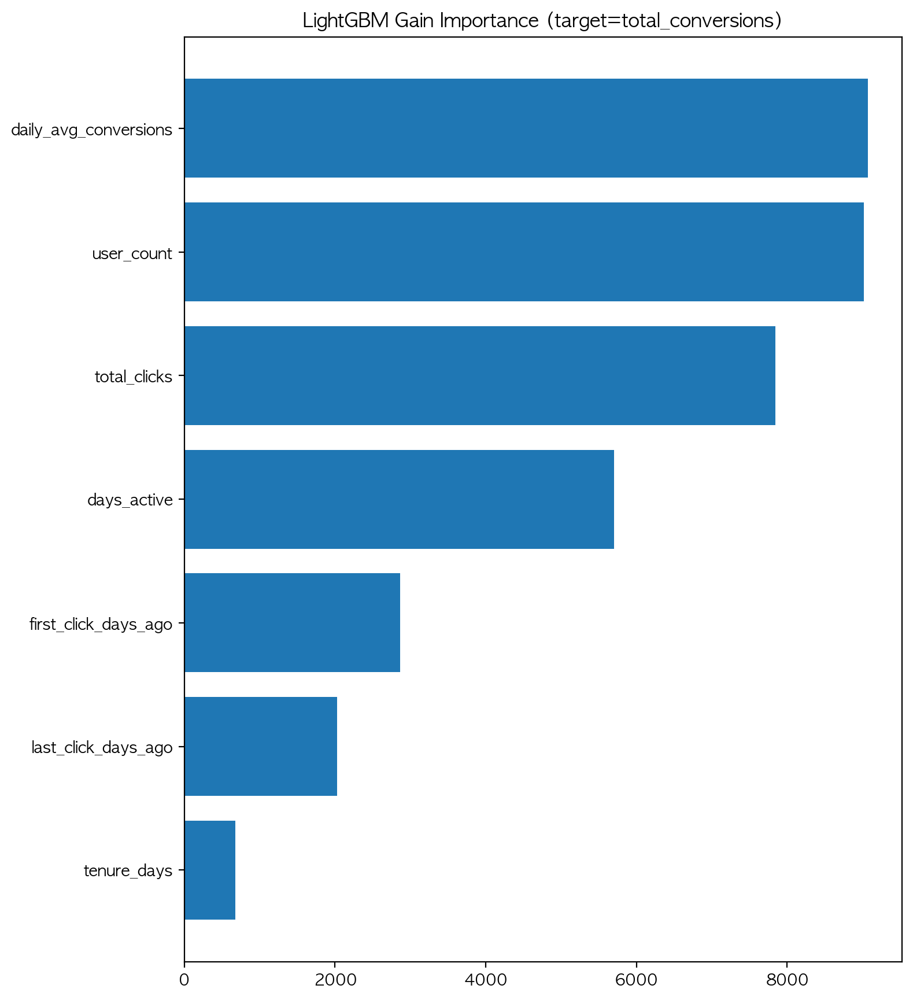

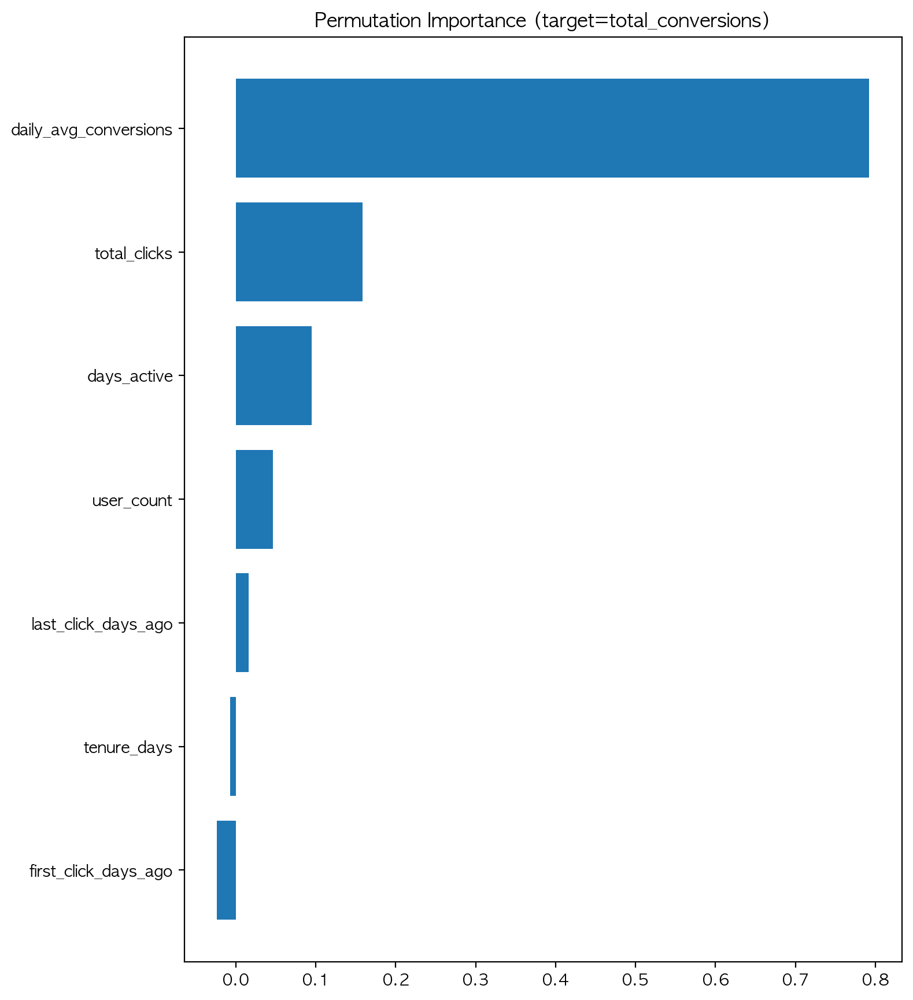

In [ ]:
# === 0) 사용할 컬럼 목록 ===
USE_COLS = [
    'mda_idx', 'user_count', 'total_clicks', 'total_conversions',
    'first_click', 'last_click', 'days_active', 'daily_avg_conversions',
    'LARGE', 'MEDIUM', 'MEGA', 'SMALL', 'total_ads', 'MEGA_ratio', 'LARGE_ratio',
    'MEDIUM_ratio', 'SMALL_ratio', 'ads_category_0_pct', 'ads_category_1_pct',
    'ads_category_2_pct', 'ads_category_3_pct', 'ads_category_4_pct',
    'ads_category_5_pct', 'ads_category_6_pct', 'ads_category_7_pct',
    'ads_category_8_pct', 'ads_category_10_pct', 'ads_category_11_pct',
    'ads_category_13_pct', 'ads_os_type_1_pct', 'ads_os_type_2_pct',
    'ads_os_type_3_pct', 'ads_os_type_7_pct', 'domain_게임_pct', 'domain_교육_pct',
    'domain_금융_pct', 'domain_기타_pct', 'domain_미디어/컨텐츠_pct', 'domain_뷰티_pct',
    'domain_비영리/공공_pct', 'domain_생활_pct', 'domain_식당/카페_pct', 'domain_식음료_pct',
    'domain_운동/스포츠_pct', 'domain_운세_pct', 'domain_의료/건강_pct', 'domain_채용_pct',
    'domain_커머스_pct', 'expected_total_profit'
]

# === 1) df_all에서 필요한 컬럼만 추출 (누락 컬럼 체크)
present = [c for c in USE_COLS if c in df_all.columns]
missing = sorted(set(USE_COLS) - set(present))
if missing:
    print("[warn] missing columns:", missing)

df_sel = df_all[present].copy()

# === 2) ID/그룹 식별자는 드롭(권장) — mda_idx를 그대로 쓰면 '숫자ID'가 수치 피처로 들어가 과적합 위험
if "mda_idx" in df_sel.columns:
    df_sel = df_sel.drop(columns=["mda_idx"])

# 주의: 날짜(first_click, last_click)는 build_dataset_for_importance 내부에서
# days_ago/tenure 같은 수치 파생으로 바뀌고 원래 날짜 컬럼은 제거됩니다. (그대로 두세요)

# === 3-A) 타깃: 전환수(total_conversions) 기준 중요도
imp_gain_conv, imp_perm_conv, combo_conv, pipe_conv = run_importance_quick(
    df_sel, target_col="total_conversions", topn=25, drop_leaky=True
)

# === 3-B) (선택) 타깃: 기대 이익(expected_total_profit) 기준 중요도
if "expected_total_profit" in df_sel.columns:
    imp_gain_profit, imp_perm_profit, combo_profit, pipe_profit = run_importance_quick(
        df_sel, target_col="expected_total_profit", topn=25, drop_leaky=False  # 수익은 누수피처 목록과 무관하니 False 가능
    )


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000523 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 3056
[LightGBM] [Info] Number of data points in the train set: 7613, number of used features: 63
[LightGBM] [Info] Start training from score 168.027059


/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/sklearn/utils/validation.py:2749: UserWarning: X does not have valid feature names, but LGBMRegressor was fitted with feature names
  warnings.warn(
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/sklearn/u


=== Top (Combined Rank) ===
              feature  gain_importance  perm_importance_mean  rank_mean
         total_clicks           3414.0              0.367634       2.50
          daily_users           2818.0              0.849527       3.00
           user_count           4671.0              0.072300       3.50
         daily_clicks           2833.0              0.039314       5.50
            ctit_mean           2081.0              0.084604       6.00
          media_count           1254.0              0.292987       7.00
daily_avg_conversions           4235.0              0.002909       7.00
  last_click_days_ago            951.0              0.125411       9.00
            ads_order           2684.0              0.001239      10.50
 first_click_days_ago            769.0              0.038760      11.50
       contract_price           1424.0              0.000605      13.00
        campaign_days           1622.0              0.000160      13.50
         ads_category            67

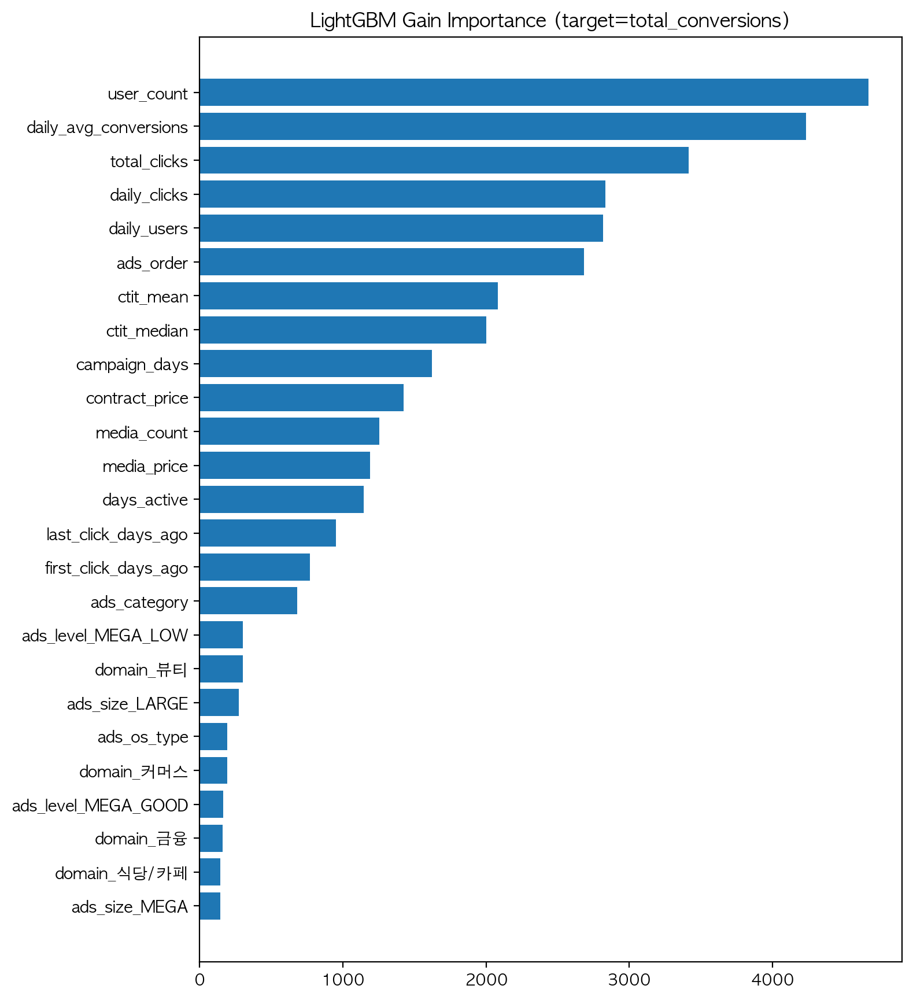

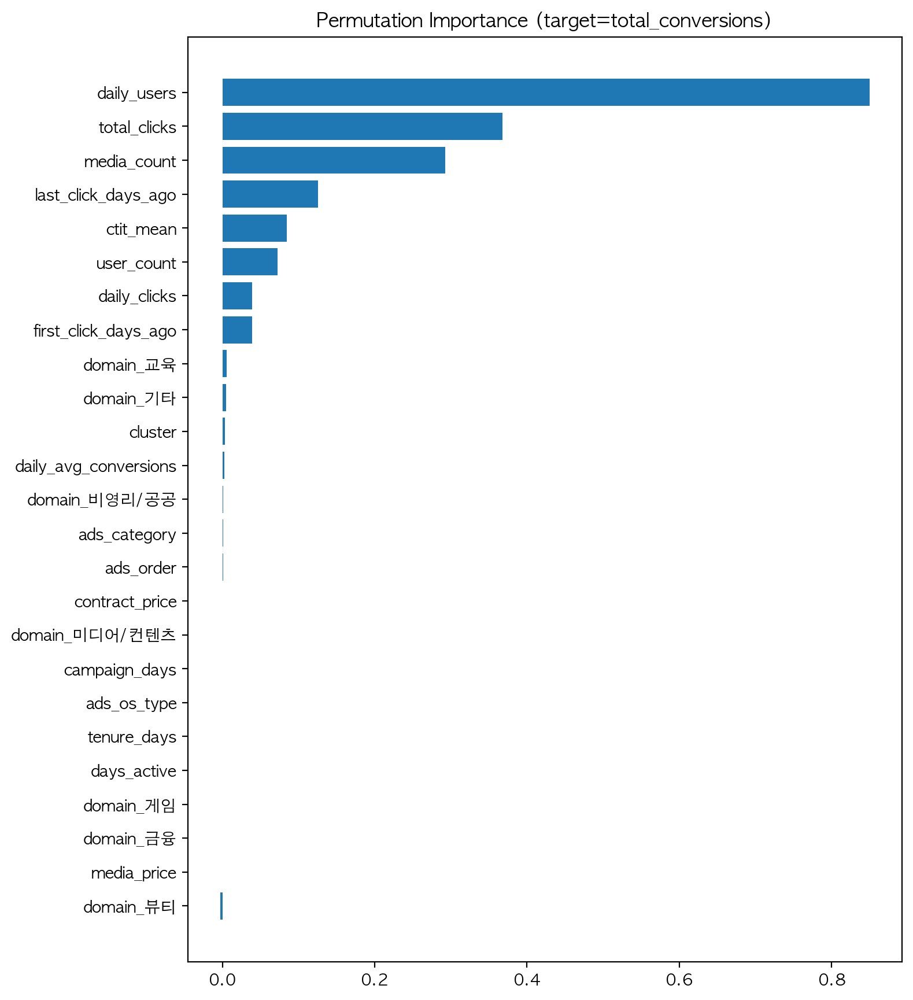

In [ ]:
leak_like = [
    "margin","roi","total_net_return","cvr",
    "total_score","conv_score","clicks_score","stability_score","media_score","cvr_score",
    "Unnamed: 0"
]
use_cols = [c for c in df_all.columns if c not in leak_like]
imp_gain2, imp_perm2, combo2, pipe2 = run_importance_quick(
    df_all[use_cols], target_col="total_conversions", topn=25, drop_leaky=True
)


In [ ]:
# ===== 0) 기간/스무딩 설정 =====
OBS_START, OBS_END = "2025-05-01", "2025-07-31"   # 관측(피처) 윈도우
TGT_START, TGT_END = "2025-08-01", "2025-08-29"   # 타깃(라벨) 윈도우
ALPHA, BETA = 1.0, 10.0   # CVR 라벨 스무딩

def _to_num(s): return pd.to_numeric(s, errors="coerce").fillna(0)
def logit(p, eps=1e-5): p=np.clip(p.astype(float), eps, 1-eps); return np.log(p/(1-p))
def inv_logit(z): return 1/(1+np.exp(-z))

def split_windows(df_time):
    d = df_time.copy()
    d["rpt_time_date"] = pd.to_datetime(d.get("rpt_time_date"), errors="coerce")
    obs = d[(d["rpt_time_date"] >= OBS_START) & (d["rpt_time_date"] <= OBS_END)]
    tgt = d[(d["rpt_time_date"] >= TGT_START) & (d["rpt_time_date"] <= TGT_END)]
    return obs, tgt

# ===== 1) 최소 피처 생성기 (ads_list + ads_time) =====
def build_ad_mda_features(ads_list, ads_time, one_hot=True):
    at = ads_time.copy()
    at["rpt_time_date"] = pd.to_datetime(at.get("rpt_time_date"), errors="coerce")
    at["clk"] = _to_num(at.get("rpt_time_clk"))

    # weekday/hour/daypart
    at["weekday"] = (pd.to_numeric(at.get("weekday"), errors="coerce")
                     .fillna(at["rpt_time_date"].dt.dayofweek))
    try:
        at["hour"] = pd.to_datetime(at.get("rpt_time_time"), errors="coerce").dt.hour
    except Exception:
        at["hour"] = pd.to_numeric(at.get("rpt_time_time"), errors="coerce")
    at["hour"] = at["hour"].fillna(-1).astype(int)
    def _daypart(h):
        if 6<=h<10: return "morning"
        if 10<=h<14: return "midday"
        if 14<=h<19: return "afternoon"
        if 19<=h<24: return "evening"
        return "night"
    at["daypart"] = at["hour"].apply(_daypart)

    # 분포 피처
    wdist = (at.groupby(["mda_idx","ads_idx","weekday"])["clk"].sum().unstack(fill_value=0))
    wdist = wdist.div(wdist.sum(axis=1).replace(0, np.nan), axis=0).fillna(0).add_prefix("wdist_")
    pdist = (at.groupby(["mda_idx","ads_idx","daypart"])["clk"].sum().unstack(fill_value=0))
    pdist = pdist.div(pdist.sum(axis=1).replace(0, np.nan), axis=0).fillna(0).add_prefix("pdist_")

    # 일 단위 활동 통계
    daily = (at.dropna(subset=["rpt_time_date"])
               .groupby(["mda_idx","ads_idx","rpt_time_date"])["clk"].sum().reset_index())
    def _median_gap_days(d):
        vals = pd.to_datetime(d, errors="coerce").dropna().values.astype("datetime64[D]").astype("int64")
        if len(vals)<=1: return np.nan
        return float(np.median(np.diff(np.sort(vals))))
    act = (daily.groupby(["mda_idx","ads_idx"])
                 .agg(active_days=("rpt_time_date","nunique"),
                      mean_log1p_clk=("clk", lambda s: float(np.log1p(s).mean()) if len(s) else 0.0),
                      std_log1p_clk=("clk",  lambda s: float(np.log1p(s).std())  if len(s) else 0.0),
                      median_gap_days=("rpt_time_date", _median_gap_days))
                 .reset_index())

    # 광고 메타
    al = ads_list.copy()
    for c in ["ads_contract_price","ads_reward_price","ads_age_min","ads_age_max"]:
        al[c] = _to_num(al.get(c))
    al["ads_sdate"] = pd.to_datetime(al.get("ads_sdate"), errors="coerce")
    al["ads_edate"] = pd.to_datetime(al.get("ads_edate"), errors="coerce")
    ads_meta = al[["ads_idx","ads_category","ads_type","ads_os_type",
                   "ads_contract_price","ads_reward_price","ads_age_min","ads_age_max",
                   "ads_sdate","ads_edate"]].drop_duplicates("ads_idx")
    ads_meta["reward_contract_ratio"] = (ads_meta["ads_reward_price"]/ads_meta["ads_contract_price"])\
                                          .replace([np.inf,-np.inf], np.nan).fillna(0)
    ads_meta["age_range"] = (ads_meta["ads_age_max"]-ads_meta["ads_age_min"]).clip(lower=0)
    ads_meta["ad_duration_days"] = (ads_meta["ads_edate"]-ads_meta["ads_sdate"]).dt.days.clip(lower=0)
    ref_date = max([x for x in [at["rpt_time_date"].max(), ads_meta["ads_edate"].max()] if pd.notnull(x)]) \
               if len(at) else pd.Timestamp.utcnow().normalize()
    ads_meta["ad_age_days"] = (pd.to_datetime(ref_date).normalize()-ads_meta["ads_sdate"]).dt.days

    pairs = at[["mda_idx","ads_idx"]].drop_duplicates()
    feats = (pairs
        .merge(ads_meta, on="ads_idx", how="left")
        .merge(wdist.reset_index(), on=["mda_idx","ads_idx"], how="left")
        .merge(pdist.reset_index(), on=["mda_idx","ads_idx"], how="left")
        .merge(act, on=["mda_idx","ads_idx"], how="left"))

    # NaN 처리
    num_cols = feats.select_dtypes(include=[np.number]).columns
    feats[num_cols] = feats[num_cols].replace([np.inf,-np.inf], np.nan).fillna(0)

    # 범주 원핫
    if one_hot:
        for c in ["ads_category","ads_type","ads_os_type"]:
            if c in feats.columns:
                d = pd.get_dummies(feats[c], prefix=c, dummy_na=True)
                feats = pd.concat([feats.drop(columns=[c]), d], axis=1)
    return feats.fillna(0)

# ===== 2) CVR 기준 피처 중요도 =====
def importance_future_cvr(ads_list, ads_time, topn=25, drop_volume=False):
    # 윈도우 분리
    obs_time, tgt_time = split_windows(ads_time)

    # 관측 구간 피처
    X_obs = build_ad_mda_features(ads_list, obs_time, one_hot=True)

    # 타깃 구간 CVR 라벨(스무딩) + 가중치(클릭)
    tgt_agg = (tgt_time.assign(
                    clk=_to_num(tgt_time["rpt_time_clk"]),
                    trn=_to_num(tgt_time["rpt_time_turn"]))
               .groupby(["mda_idx","ads_idx"], as_index=False)
               .agg(clicks=("clk","sum"), turns=("trn","sum")))
    tgt_agg["y_cvr"] = (tgt_agg["turns"]+ALPHA) / (tgt_agg["clicks"]+BETA)
    tgt_agg["w"] = tgt_agg["clicks"].clip(lower=1)

    # 결합
    df = (X_obs.merge(tgt_agg, on=["mda_idx","ads_idx"], how="inner")
               .replace([np.inf,-np.inf], np.nan).fillna(0))

    # 학습 세트
    drop_cols = ["mda_idx","ads_idx","y_cvr","w"]
    X = df.drop(columns=[c for c in drop_cols if c in df.columns])

    # 볼륨 피처 제외 옵션
    if drop_volume:
        vol_cols = ["mean_log1p_clk","std_log1p_clk","active_days"]  # 필요시 확장
        X = X.drop(columns=[c for c in vol_cols if c in X.columns], errors="ignore")

    # 1) 숫자/불리언 이외 타입(특히 datetime, object) 제거
    non_numeric = X.select_dtypes(exclude=[np.number, "bool"]).columns.tolist()
    if non_numeric:
        print("[info] dropping non-numeric columns:", non_numeric)
        X = X.drop(columns=non_numeric)

    # 2) cat egory → 코드
    cat_cols = X.select_dtypes(include=["category"]).columns
    for c in cat_cols:
        X[c] = X[c].cat.codes

    # 3) bool → uint8
    bool_cols = X.select_dtypes(include=["bool"]).columns
    if len(bool_cols):
        X[bool_cols] = X[bool_cols].astype("uint8")

    # 4) 무한/결측 처리
    X = X.replace([np.inf, -np.inf], np.nan).fillna(0)

    # 타깃/가중치
    y = logit(df["y_cvr"].astype(float))
    w = df["w"].astype(float)

    # split
    X_tr, X_te, y_tr, y_te, w_tr, w_te = train_test_split(X, y, w, test_size=0.2, random_state=42)

    # 모델
    model = lgb.LGBMRegressor(
        objective="regression",
        n_estimators=3000,
        learning_rate=0.03,
        num_leaves=31,
        min_data_in_leaf=80,
        subsample=0.9,
        colsample_bytree=0.9,
        reg_lambda=1.0,
        force_row_wise=True
    )
    model.fit(
        X_tr, y_tr, sample_weight=w_tr,
        eval_set=[(X_te, y_te)],
        eval_sample_weight=[w_te],
        callbacks=[lgb.early_stopping(100), lgb.log_evaluation(100)]
    )

    # 중요도 (Gain)
    imp_gain = (pd.DataFrame({"feature": X.columns,
                              "gain_importance": model.feature_importances_.astype(float)})
                .sort_values("gain_importance", ascending=False))

    # Permutation (y_logit 기준 R^2 감소)
    perm = permutation_importance(model, X_te, y_te, n_repeats=10, random_state=42, n_jobs=-1)
    imp_perm = (pd.DataFrame({
        "feature": X.columns[:len(perm.importances_mean)],
        "perm_importance_mean": perm.importances_mean,
        "perm_importance_std":  perm.importances_std
    }).sort_values("perm_importance_mean", ascending=False))

    # 결합 순위 (평균)
    g = imp_gain.assign(rank_gain=lambda d: d["gain_importance"].rank(ascending=False))
    p = imp_perm.assign(rank_perm=lambda d: d["perm_importance_mean"].rank(ascending=False))
    combo = (g[["feature","gain_importance","rank_gain"]]
             .merge(p[["feature","perm_importance_mean","rank_perm"]], on="feature", how="outer")
             .fillna({"rank_gain":1e9,"rank_perm":1e9}))
    combo["rank_mean"] = combo[["rank_gain","rank_perm"]].mean(axis=1)
    combo = combo.sort_values("rank_mean").head(topn)

    return imp_gain, imp_perm, combo, model, (X_te, y_te, w_te)

# ===== 3) 실행 =====
imp_gain_cvr, imp_perm_cvr, combo_cvr, model_cvr, _ = importance_future_cvr(
    ads_list, ads_time, topn=25, drop_volume=False  # 볼륨 피처 영향 줄이려면 True로 비교해보세요
)

print("\n=== [CVR 기준] Top (Combined Rank) ===")
print(combo_cvr[["feature","gain_importance","perm_importance_mean","rank_mean"]].to_string(index=False))


/var/folders/h_/w4rld_6j5l13g0td8v__qc7r0000gn/T/ipykernel_32992/3216589617.py:64: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  al["ads_edate"] = pd.to_datetime(al.get("ads_edate"), errors="coerce")


[info] dropping non-numeric columns: ['ads_sdate', 'ads_edate']
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Info] Total Bins 4037
[LightGBM] [Info] Number of data points in the train set: 2972, number of used features: 38
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Info] Start training from score -11.050298
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 100 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

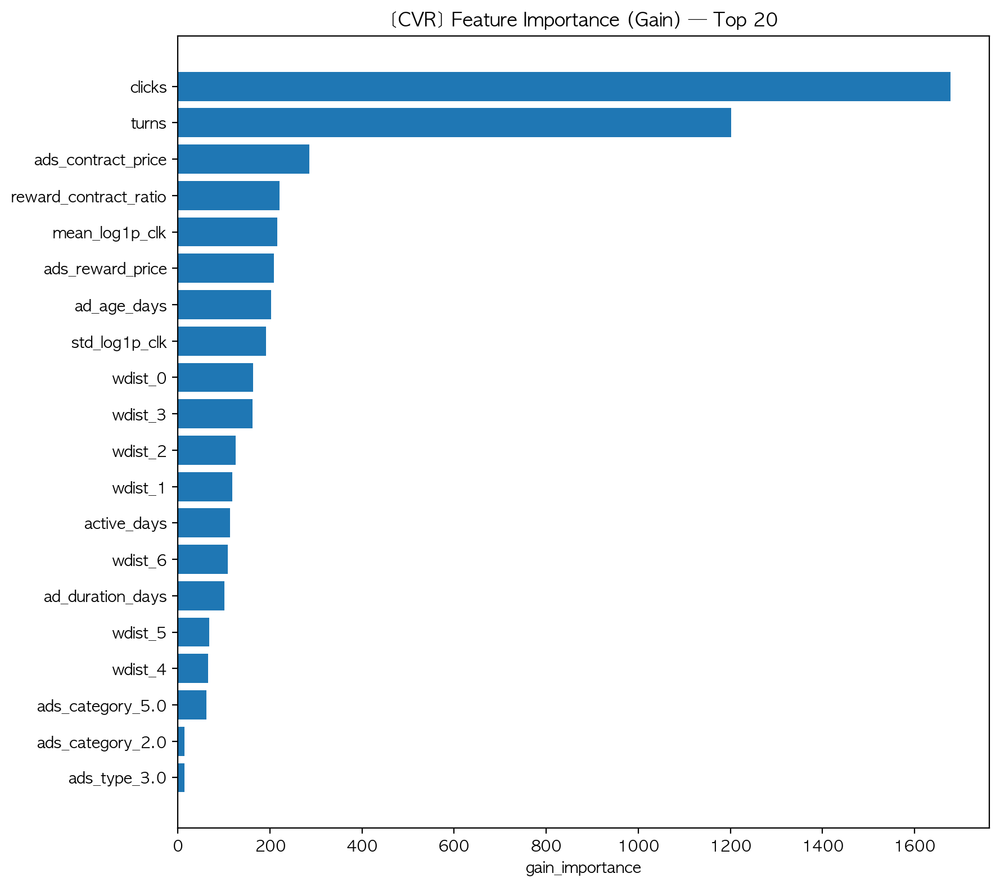

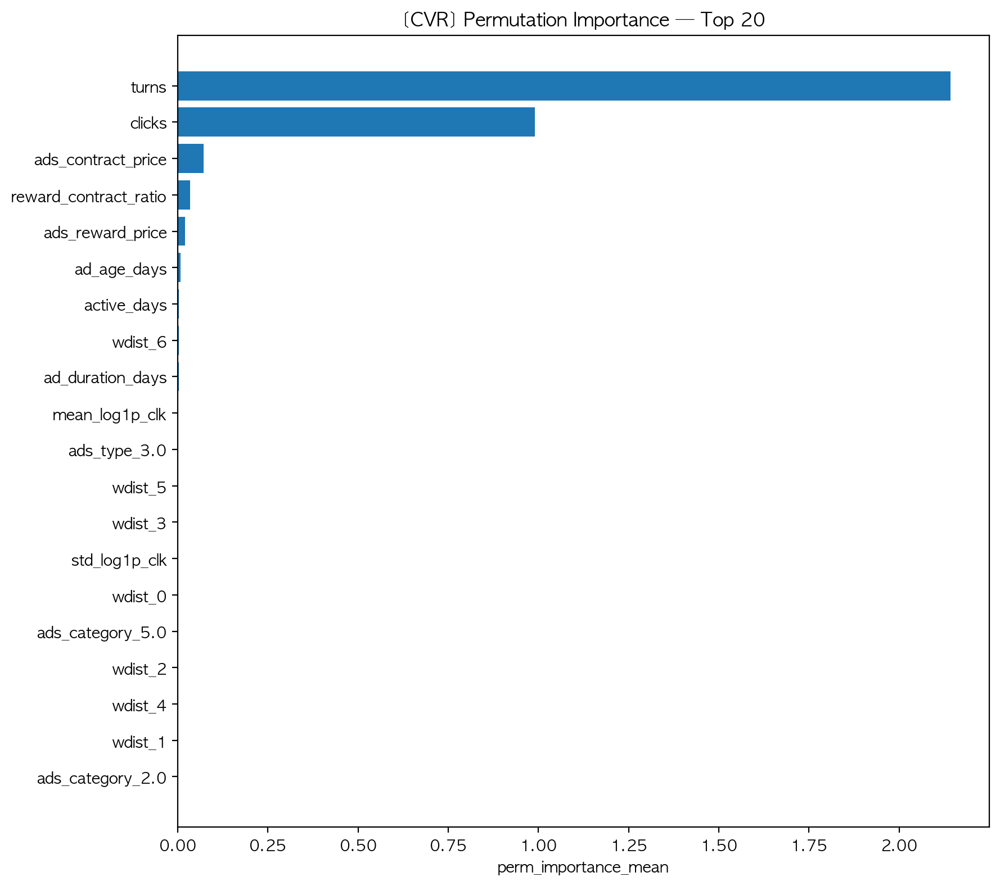

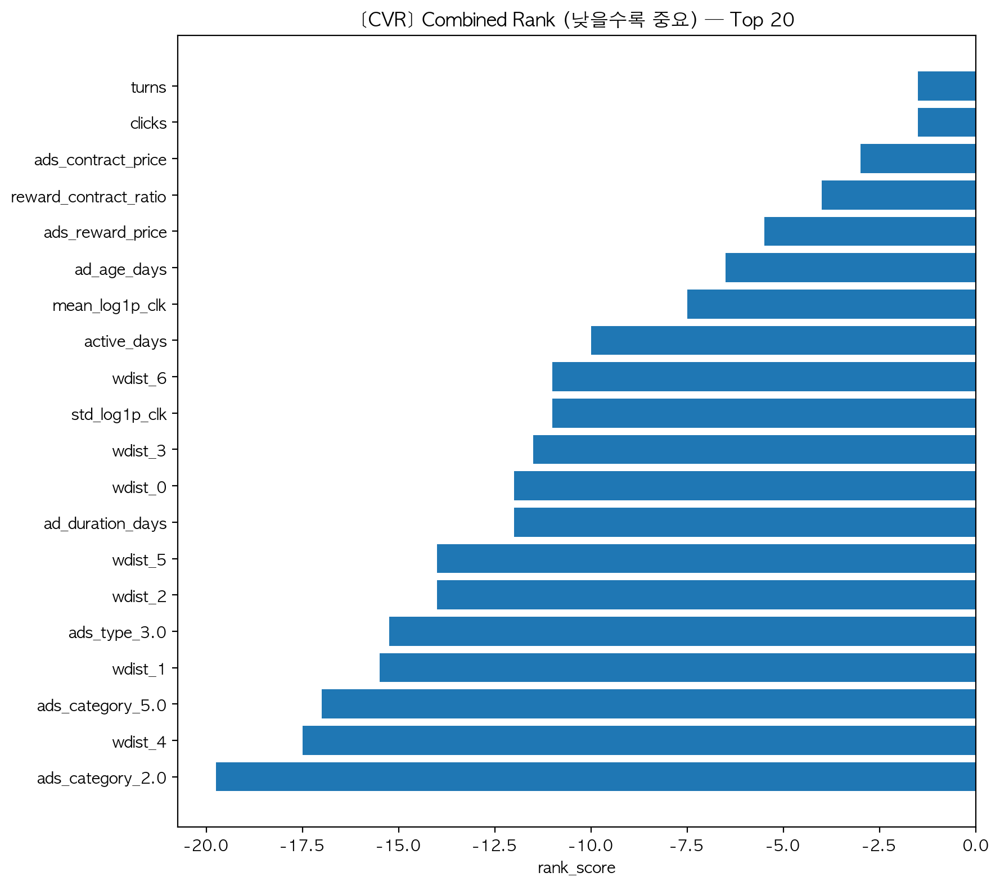

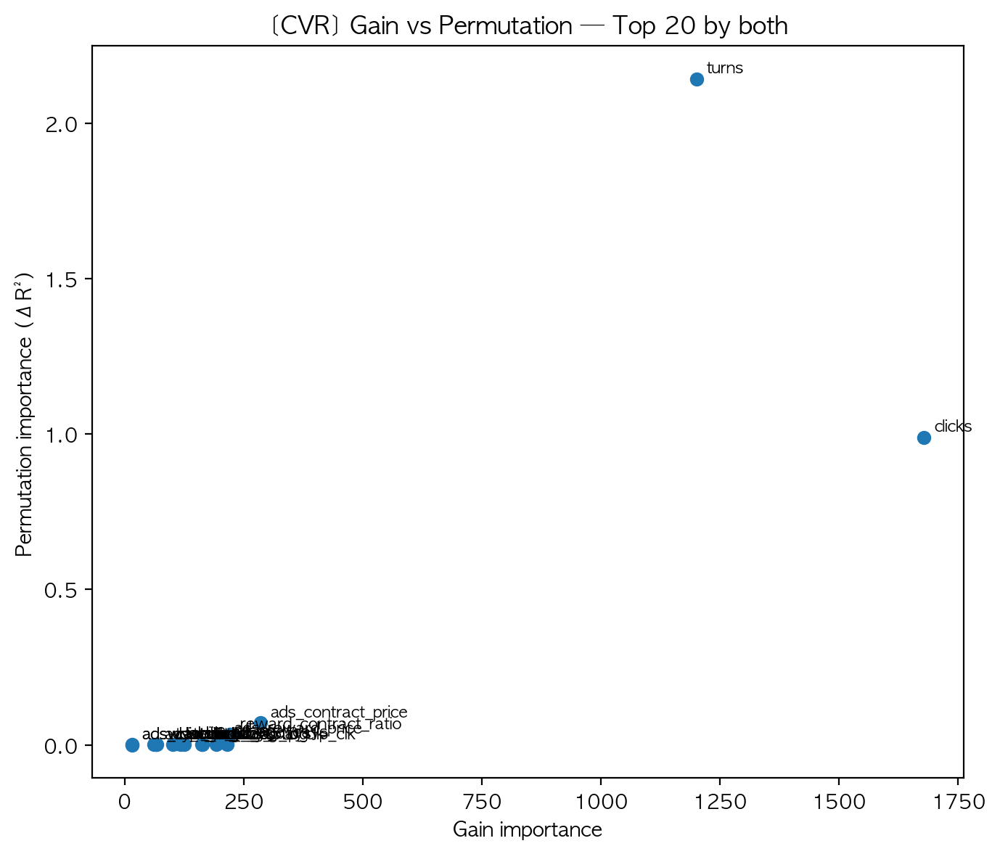

In [ ]:
TOPN = 20  # 상위 몇 개를 그릴지

# imp_*가 없으면 자동 계산
if 'imp_gain_cvr' not in globals() or 'imp_perm_cvr' not in globals() or 'combo_cvr' not in globals():
    # 중요도 계산 함수가 앞서 정의되어 있어야 합니다: importance_future_cvr(...)
    imp_gain_cvr, imp_perm_cvr, combo_cvr, model_cvr, _ = importance_future_cvr(
        ads_list, ads_time, topn=50, drop_volume=False
    )

def _barh(df, value_col, title, topn=TOPN):
    d = df.copy().head(topn)
    plt.figure(figsize=(9, max(4, len(d)*0.4)))
    plt.barh(d["feature"][::-1], d[value_col][::-1])
    plt.title(title)
    plt.xlabel(value_col)
    plt.tight_layout()
    plt.show()

# 1) LightGBM Gain 중요도 (상위 TOPN)
imp_gain_sorted = imp_gain_cvr.sort_values("gain_importance", ascending=False)
_barh(imp_gain_sorted, "gain_importance", f"[CVR] Feature Importance (Gain) — Top {TOPN}")

# 2) Permutation 중요도 (상위 TOPN)
imp_perm_sorted = imp_perm_cvr.sort_values("perm_importance_mean", ascending=False)
_barh(imp_perm_sorted, "perm_importance_mean", f"[CVR] Permutation Importance — Top {TOPN}")

# 3) Combined Rank (Gain/Permutation 평균 순위) — 순위가 낮을수록 중요
combo_sorted = combo_cvr.sort_values("rank_mean", ascending=True).head(TOPN).copy()
# 보기 좋게 'rank_score' = -rank_mean 로 막대가 클수록 중요하게 표시
combo_sorted["rank_score"] = -combo_sorted["rank_mean"]
_barh(combo_sorted, "rank_score", f"[CVR] Combined Rank (낮을수록 중요) — Top {TOPN}")

# (선택) Gain vs Permutation 스캐터: 두 지표가 모두 높은 '진짜 핵심'을 한눈에
cmp = (imp_gain_cvr[["feature","gain_importance"]]
       .merge(imp_perm_cvr[["feature","perm_importance_mean"]], on="feature", how="inner"))
top_cmp = cmp.sort_values(["gain_importance","perm_importance_mean"], ascending=False).head(TOPN)

plt.figure(figsize=(7,6))
plt.scatter(top_cmp["gain_importance"], top_cmp["perm_importance_mean"])
for _, r in top_cmp.iterrows():
    plt.annotate(r["feature"], (r["gain_importance"], r["perm_importance_mean"]), xytext=(5,3), textcoords="offset points", fontsize=8)
plt.title(f"[CVR] Gain vs Permutation — Top {TOPN} by both")
plt.xlabel("Gain importance")
plt.ylabel("Permutation importance (ΔR²)")
plt.tight_layout()
plt.show()


/var/folders/h_/w4rld_6j5l13g0td8v__qc7r0000gn/T/ipykernel_32992/3216589617.py:64: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  al["ads_edate"] = pd.to_datetime(al.get("ads_edate"), errors="coerce")


[info] dropping non-numeric columns: ['ads_sdate', 'ads_edate']
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Info] Total Bins 4037
[LightGBM] [Info] Number of data points in the train set: 2972, number of used features: 38
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Info] Start training from score -11.050298
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 100 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

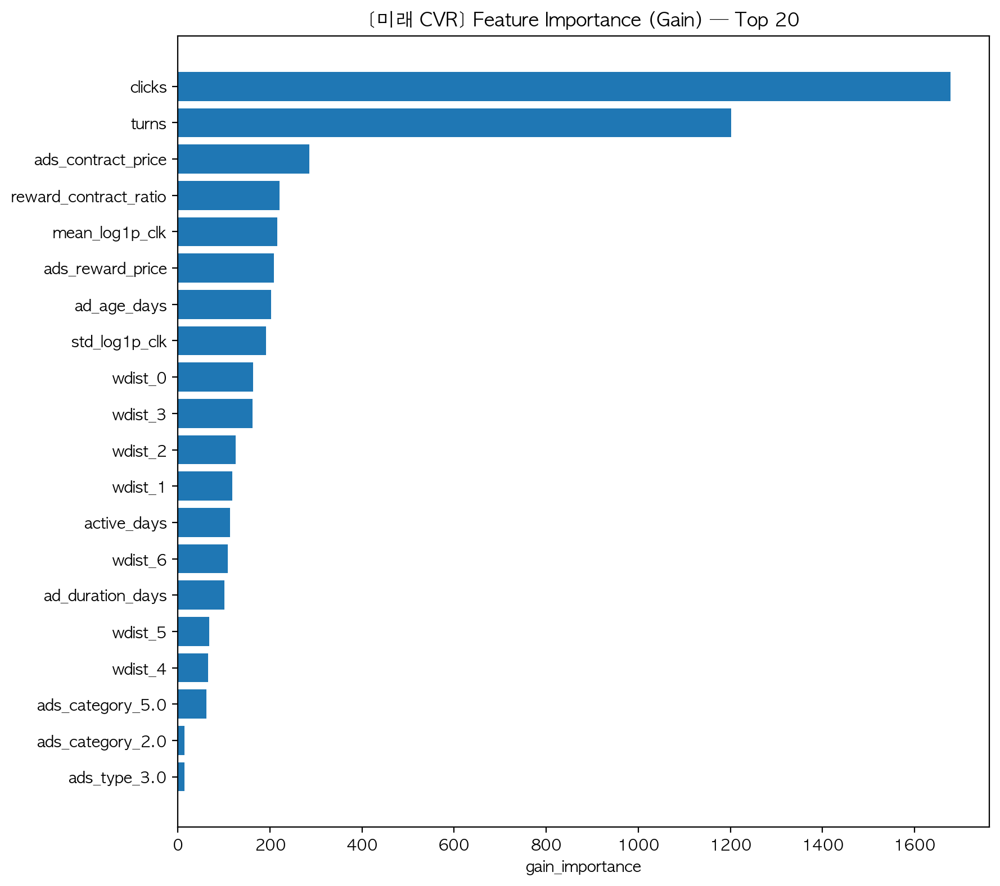

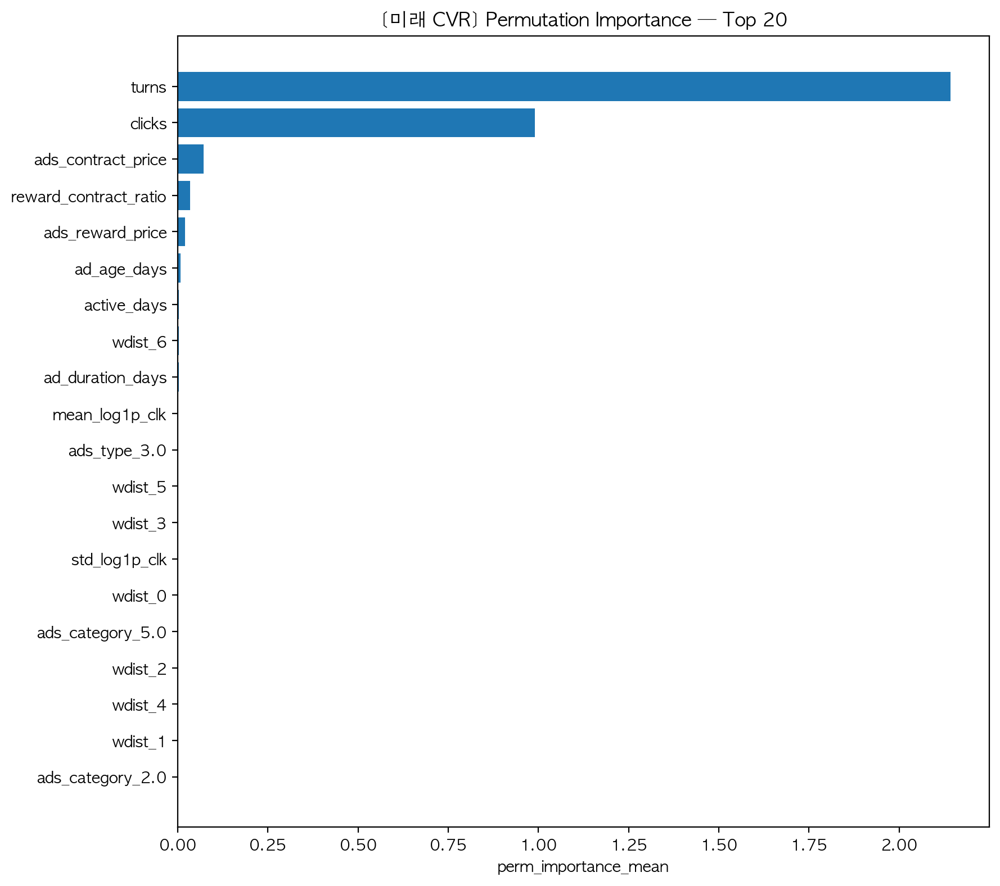

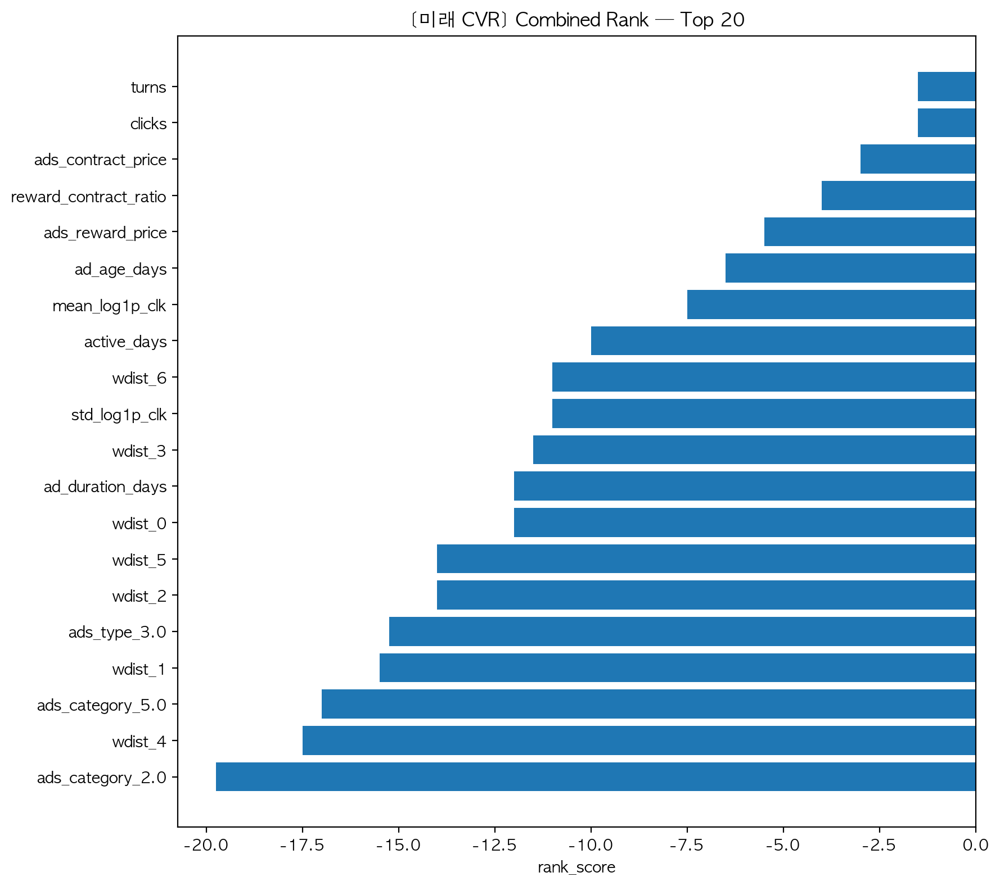

/var/folders/h_/w4rld_6j5l13g0td8v__qc7r0000gn/T/ipykernel_32992/3216589617.py:64: UserWarning: Could not infer format, so each element will be parsed individually, falling back to `dateutil`. To ensure parsing is consistent and as-expected, please specify a format.
  al["ads_edate"] = pd.to_datetime(al.get("ads_edate"), errors="coerce")


[info] dropping non-numeric columns: ['ads_sdate', 'ads_edate']
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Info] Total Bins 3434
[LightGBM] [Info] Number of data points in the train set: 2972, number of used features: 35
[LightGBM] [Warning] min_data_in_leaf is set=80, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=80
[LightGBM] [Info] Start training from score -11.050298
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Training until validation scores don't improve for 100 rounds
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No fur

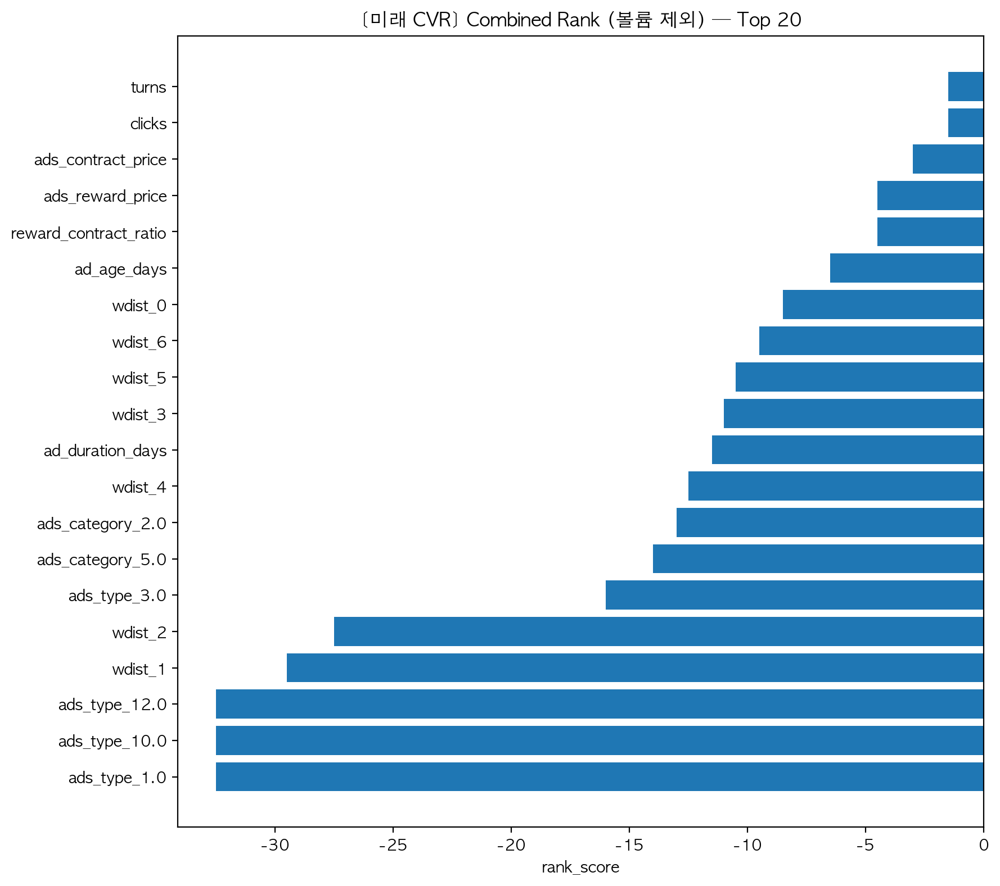

In [ ]:
# ===== 1) 기간 설정: 관측 3개월 → 타깃 최근 1개월 =====
OBS_START, OBS_END = "2025-05-01", "2025-07-31"   # 관측(피처)
TGT_START, TGT_END = "2025-08-01", "2025-08-29"   # 타깃(미래 CVR)

# ===== 2) 미래 CVR 기준 중요도 계산 (볼륨 포함) =====
imp_gain_cvr, imp_perm_cvr, combo_cvr, model_cvr, _ = importance_future_cvr(
    ads_list, ads_time, topn=50, drop_volume=False
)

# ===== 3) 그래프 (TOPN 조절 가능) =====
import matplotlib.pyplot as plt
TOPN = 20

def _barh(df, value_col, title, topn=TOPN):
    d = df.sort_values(value_col, ascending=False).head(topn)
    plt.figure(figsize=(9, max(4, len(d)*0.4)))
    plt.barh(d["feature"][::-1], d[value_col][::-1])
    plt.title(title)
    plt.xlabel(value_col); plt.tight_layout(); plt.show()

# (A) Gain
_barh(imp_gain_cvr, "gain_importance", f"[미래 CVR] Feature Importance (Gain) — Top {TOPN}")
# (B) Permutation
_barh(imp_perm_cvr, "perm_importance_mean", f"[미래 CVR] Permutation Importance — Top {TOPN}")
# (C) Combined Rank (낮을수록 중요 → 보기 쉽게 음수변환)
combo_plot = combo_cvr.copy().sort_values("rank_mean").head(TOPN)
combo_plot["rank_score"] = -combo_plot["rank_mean"]
_barh(combo_plot, "rank_score", f"[미래 CVR] Combined Rank — Top {TOPN}")

# ===== 4) (비교 권장) 볼륨 피처 제외 버전 =====
imp_gain_cvr_nv, imp_perm_cvr_nv, combo_cvr_nv, _, _ = importance_future_cvr(
    ads_list, ads_time, topn=50, drop_volume=True
)
_barh(combo_cvr_nv.assign(rank_score=lambda d: -d["rank_mean"]),
      "rank_score", f"[미래 CVR] Combined Rank (볼륨 제외) — Top {TOPN}")


In [ ]:
# 데이터 범위: 2024-07-27 ~ 2025-08-29
# 권장: TGT=최근 1개월, OBS=직전 3개월
OBS_START, OBS_END = "2025-05-01", "2025-07-31"   # 관측
TGT_START, TGT_END = "2025-08-01", "2025-08-29"   # 타깃

ALPHA, BETA = 1.0, 20.0  # CVR 스무딩
def _to_num(s): return pd.to_numeric(s, errors="coerce").fillna(0)

# 날짜 정리
t = ads_time.copy()
t["rpt_time_date"] = pd.to_datetime(t["rpt_time_date"], errors="coerce")
t["clk"] = _to_num(t["rpt_time_clk"])
t["trn"] = _to_num(t["rpt_time_turn"])

obs = t[(t["rpt_time_date"]>=OBS_START) & (t["rpt_time_date"]<=OBS_END)].copy()
tgt = t[(t["rpt_time_date"]>=TGT_START) & (t["rpt_time_date"]<=TGT_END)].copy()

print("OBS rows:", len(obs), "| TGT rows:", len(tgt))


OBS rows: 1321820 | TGT rows: 270479


In [ ]:
al = ads_list.copy()
for c in ["ads_contract_price","ads_reward_price"]:  # 계약단가(광고주지불) / 리워드(매체지급) 가정
    al[c] = _to_num(al.get(c))

ad_meta = al[["ads_idx","ads_category","ads_os_type","ads_contract_price","ads_reward_price"]].drop_duplicates("ads_idx")
ad_meta["margin_per_conv"] = (ad_meta["ads_contract_price"] - ad_meta["ads_reward_price"]).clip(lower=0).fillna(0)


In [ ]:
ad_tgt = (tgt.groupby("ads_idx", as_index=False)
            .agg(clicks=("clk","sum"), conv=("trn","sum")))
ad_tgt["cvr_global"] = (ad_tgt["conv"]+ALPHA)/(ad_tgt["clicks"]+BETA)
ad_tgt["hotness"] = ad_tgt["clicks"]  # 인기 보정용


In [ ]:
ad_tgt = (tgt.groupby("ads_idx", as_index=False)
            .agg(clicks=("clk","sum"), conv=("trn","sum")))
ad_tgt["cvr_global"] = (ad_tgt["conv"]+ALPHA)/(ad_tgt["clicks"]+BETA)
ad_tgt["hotness"] = ad_tgt["clicks"]  # 인기 보정용


In [ ]:
import pandas as pd, numpy as np
from collections import defaultdict
from math import log2

# ==== 0) 파라미터 & 기간 ====
MONTH_START, MONTH_END = "2025-08-01", "2025-08-29"  # 테스트하고 싶은 달
# OBS=앞 3주, TGT=마지막 1주 (경계 자동 계산)
month_dates = pd.date_range(MONTH_START, MONTH_END, freq="D")
cut = month_dates[-7]  # 마지막 7일을 TGT
OBS_START, OBS_END = str(month_dates[0].date()), str((cut - pd.Timedelta(days=1)).date())
TGT_START, TGT_END = str(cut.date()), str(month_dates[-1].date())

ALPHA, BETA = 1.0, 20.0  # CVR 스무딩
TOP_PER_MDA = 50         # co-vis 생성 시 mda별 상위 광고만 사용
TOPN_SIM = 50            # 광고별 유사 이웃 수
TOPK = 20                # mda별 추천 Top-K

def _to_num(s): return pd.to_numeric(s, errors="coerce").fillna(0)

# ==== 1) 데이터 자르기 ====
t = ads_time.copy()
t["rpt_time_date"] = pd.to_datetime(t["rpt_time_date"], errors="coerce")
t["clk"] = _to_num(t["rpt_time_clk"])
t["trn"] = _to_num(t["rpt_time_turn"])

obs = t[(t["rpt_time_date"]>=OBS_START) & (t["rpt_time_date"]<=OBS_END)].copy()
tgt = t[(t["rpt_time_date"]>=TGT_START) & (t["rpt_time_date"]<=TGT_END)].copy()
print(f"OBS {OBS_START}~{OBS_END}: {len(obs)} rows | TGT {TGT_START}~{TGT_END}: {len(tgt)} rows")

# ==== 2) 광고 메타 → 전환당 마진 ====
al = ads_list.copy()
al["ads_contract_price"] = _to_num(al.get("ads_contract_price"))
al["ads_reward_price"]  = _to_num(al.get("ads_reward_price"))
ad_meta = al[["ads_idx","ads_contract_price","ads_reward_price"]].drop_duplicates("ads_idx")
ad_meta["margin_per_conv"] = (ad_meta["ads_contract_price"] - ad_meta["ads_reward_price"]).clip(lower=0).fillna(0)

# ==== 3) OBS에서 co-vis 유사도(메모리 안전) ====
ui = (obs.groupby(["mda_idx","ads_idx"], as_index=False).agg(clk=("clk","sum")))
ui = ui[ui["clk"]>0].copy()

pop = (ui.groupby("ads_idx", as_index=False)["clk"].sum()
         .rename(columns={"clk":"clk_pop"})).set_index("ads_idx")["clk_pop"]

pairs_counter = defaultdict(float)
for mda, g in ui.groupby("mda_idx", sort=False):
    g = g.sort_values("clk", ascending=False).head(TOP_PER_MDA)
    ads = g["ads_idx"].to_numpy(); clk = g["clk"].to_numpy(); L = len(ads)
    for i in range(L):
        ai, ci = ads[i], clk[i]
        for j in range(i+1, L):
            aj, cj = ads[j], clk[j]
            w = ci if ci < cj else cj
            pairs_counter[(ai, aj)] += w
            pairs_counter[(aj, ai)] += w

sim_top = pd.DataFrame(columns=["ads_idx_x","ads_idx_y","sim"])
if pairs_counter:
    sim_raw = pd.DataFrame(((i,j,w) for (i,j),w in pairs_counter.items()),
                           columns=["ads_idx_x","ads_idx_y","w"])
    sim = sim_raw.copy()
    sim["clk_pop_x"] = sim["ads_idx_x"].map(pop).fillna(0)
    sim["clk_pop_y"] = sim["ads_idx_y"].map(pop).fillna(0)
    sim["sim"] = sim["w"] / np.sqrt((sim["clk_pop_x"]+1e-9)*(sim["clk_pop_y"]+1e-9))
    sim_top = (sim.sort_values(["ads_idx_x","sim"], ascending=[True,False])
                  .groupby("ads_idx_x").head(TOPN_SIM)[["ads_idx_x","ads_idx_y","sim"]])

similar_ads = sim_top.groupby("ads_idx_x")["ads_idx_y"].apply(list).to_dict()
sim_lookup = sim_top.set_index(["ads_idx_x","ads_idx_y"])["sim"].to_dict()

# ==== 4) OBS에서 seed & 후보 생성 ====
SEED_K = 20
seeds = (ui.sort_values(["mda_idx","clk"], ascending=[True,False])
           .groupby("mda_idx").head(SEED_K))
used = ui.groupby("mda_idx")["ads_idx"].apply(set).to_dict()
seed_map = seeds.groupby("mda_idx")["ads_idx"].apply(list).to_dict()

def gen_candidates_for_mda(mda):
    seed_ads = seed_map.get(mda, [])
    cand = []
    for a in seed_ads:
        cand += similar_ads.get(a, [])
    cand = pd.Index(cand).drop_duplicates().tolist()
    seen = used.get(mda, set())
    cand = [a for a in cand if a not in seen]
    return cand[:200]

mda_list = ui["mda_idx"].unique().tolist()
cands = [(m,a) for m in mda_list for a in gen_candidates_for_mda(m)]
cands = pd.DataFrame(cands, columns=["mda_idx","ads_idx"])

# ==== 5) OBS에서 스코어(유휴 모델 없이도 가능): EPC_margin = CVR_obs × 마진 ====
ad_obs = (obs.groupby("ads_idx", as_index=False)
            .agg(clicks=("clk","sum"), conv=("trn","sum")))
ad_obs["cvr_obs"] = (ad_obs["conv"]+ALPHA)/(ad_obs["clicks"]+BETA)

# 유사도 가산치
def sim_score(mda, ad):
    s_ads = seed_map.get(mda, [])
    if not s_ads: return 0.0
    return sum(sim_lookup.get((a, ad), 0.0) for a in s_ads)

cands["sim_score"] = cands.apply(lambda r: sim_score(r["mda_idx"], r["ads_idx"]), axis=1)
cands["sim_score_norm"] = cands.groupby("mda_idx")["sim_score"]\
                               .transform(lambda s: (s - s.mean())/(s.std()+1e-9)).clip(-2,5)

score_df = (cands.merge(ad_obs[["ads_idx","cvr_obs"]], on="ads_idx", how="left")
                 .merge(ad_meta[["ads_idx","margin_per_conv"]], on="ads_idx", how="left"))
score_df["cvr_obs"] = score_df["cvr_obs"].fillna(ALPHA/BETA)
score_df["margin_per_conv"] = score_df["margin_per_conv"].fillna(0)
gamma = 0.3
score_df["epc_margin"] = score_df["cvr_obs"] * score_df["margin_per_conv"]
score_df["score"] = score_df["epc_margin"] * (1 + gamma*score_df["sim_score_norm"])

reco = (score_df.sort_values(["mda_idx","score"], ascending=[True,False])
               .groupby("mda_idx").head(TOPK)[["mda_idx","ads_idx","score"]])

# ==== 6) TGT에서 그라운드트루스 생성 ====
pair_tgt = (tgt.groupby(["mda_idx","ads_idx"], as_index=False)
              .agg(tgt_clicks=("clk","sum"), tgt_conv=("trn","sum")))
pair_tgt["tgt_gain"] = pair_tgt["tgt_conv"]  # NDCG gain으로 전환수 사용(수익이면 마진 곱해도 됨)

# ==== 7) 랭킹 평가: Recall@K, NDCG@K, MAP@K ====
def recall_at_k(gt_set, pred_list, k):
    pred_k = pred_list[:k]
    return len([a for a in pred_k if a in gt_set]) / max(1, len(gt_set))

def dcg_at_k(gains, k):
    return sum(g / log2(i+2) for i, g in enumerate(gains[:k]))

def ndcg_at_k(gains, k):
    dcg = dcg_at_k(gains, k)
    ideal = dcg_at_k(sorted(gains, reverse=True), k)
    return dcg / ideal if ideal > 0 else 0.0

def average_precision_at_k(gt_set, pred_list, k):
    hits = 0; ap = 0.0
    for i, a in enumerate(pred_list[:k], start=1):
        if a in gt_set:
            hits += 1
            ap += hits / i
    return ap / max(1, min(len(gt_set), k))

rows=[]
for m, g in reco.groupby("mda_idx"):
    rec_ads = g.sort_values("score", ascending=False)["ads_idx"].tolist()
    gtt = pair_tgt.loc[pair_tgt["mda_idx"]==m]
    gt_set = set(gtt.loc[gtt["tgt_conv"]>0, "ads_idx"])  # binary relevance for Recall/MAP
    # NDCG용 gains (추천 순서에 맞춰 매핑)
    gain_map = gtt.set_index("ads_idx")["tgt_gain"].to_dict()
    gains = [gain_map.get(a, 0.0) for a in rec_ads]

    rows.append({
        "mda_idx": m,
        f"Recall@{TOPK}": recall_at_k(gt_set, rec_ads, TOPK),
        f"MAP@{TOPK}":    average_precision_at_k(gt_set, rec_ads, TOPK),
        f"NDCG@{TOPK}":   ndcg_at_k(gains, TOPK),
        "gt_pairs": len(gt_set)
    })

eval_df = pd.DataFrame(rows)
print("\n[Offline 1-Month Evaluation]")
print(eval_df[[f"Recall@{TOPK}", f"MAP@{TOPK}", f"NDCG@{TOPK}"]].mean().to_string())
print("MDA count:", len(eval_df), "| mean gt_pairs:", eval_df["gt_pairs"].mean().round(2))


OBS 2025-08-01~2025-08-22: 203187 rows | TGT 2025-08-23~2025-08-29: 67292 rows

[Offline 1-Month Evaluation]
Recall@20    0.005870
MAP@20       0.001095
NDCG@20      0.018732
MDA count: 178 | mean gt_pairs: 24.39


In [ ]:
def _to_num(s): 
    return pd.to_numeric(s, errors="coerce").fillna(0)

# 가중치/출력 개수
W_POP, W_CAT = 0.2, 0.3
TOPK = 20

# ==== 1) 기간 자동 세팅: ads_time 한 달 전체를 관측(OBS)으로 ====
d = pd.to_datetime(ads_time["rpt_time_date"], errors="coerce").dropna()
MONTH_START = str(d.min().normalize().date())
MONTH_END   = str(d.max().normalize().date())
OBS_START, OBS_END = MONTH_START, MONTH_END
print(f"[OBS window] {OBS_START} → {OBS_END}")

# ==== 2) 관측 윈도우 집계: ad–mda 전환수 ====
t = ads_time.copy()
t["rpt_time_date"] = pd.to_datetime(t["rpt_time_date"], errors="coerce")
t["turn"] = _to_num(t["rpt_time_turn"])
obs = t[(t["rpt_time_date"]>=OBS_START) & (t["rpt_time_date"]<=OBS_END)].copy()

pair = (obs.groupby(["ads_idx","mda_idx"], as_index=False)
          .agg(conv=("turn","sum")))
pair = pair[pair["conv"] > 0].reset_index(drop=True)
if pair.empty:
    raise ValueError("이 한 달 기간에 전환이 없습니다. (pair가 비어있습니다)")

# ==== 3) 희소행렬 & SVD 임베딩 ====
ad_ids  = np.sort(pair["ads_idx"].unique())
mda_ids = np.sort(pair["mda_idx"].unique())
ad2row  = {a:i for i,a in enumerate(ad_ids)}
mda2col = {m:i for i,m in enumerate(mda_ids)}

rows = pair["ads_idx"].map(ad2row).to_numpy()
cols = pair["mda_idx"].map(mda2col).to_numpy()
vals = pair["conv"].astype(float).to_numpy()

X = coo_matrix(
    (np.log1p(vals), (rows, cols)),
    shape=(len(ad_ids), len(mda_ids)),
    dtype=np.float32
).tocsr()

k_max  = max(1, min(X.shape) - 1)
N_FACT = min(64, k_max) if k_max >= 2 else 1

if N_FACT >= 2:
    svd = TruncatedSVD(n_components=N_FACT, random_state=42)
    US = svd.fit_transform(X)        # (n_ad x k)
    V  = svd.components_             # (k x n_mda)
    s  = svd.singular_values_
    S_sqrt = np.sqrt(s)

    ad_emb  = US / (S_sqrt + 1e-12)  # (n_ad x k)
    mda_emb = (S_sqrt[:,None] * V).T # (n_mda x k)
else:
    # 전환 데이터가 극히 작아 SVD 차원을 만들기 어려운 경우 백오프만 사용
    ad_emb = None
    mda_emb = None
print(f"SVD factors: {N_FACT}")

# ==== 4) 보조 신호: mda 인기 & 카테고리 적합 ====
# (a) mda 인기 (OBS 전환 합의 z-score)
mda_pop = pair.groupby("mda_idx")["conv"].sum().reindex(mda_ids, fill_value=0).astype(float).values
mda_pop_norm = (mda_pop - mda_pop.mean()) / (mda_pop.std() + 1e-9)

# (b) 카테고리 적합
al = ads_list[["ads_idx","ads_name","ads_category"]].drop_duplicates("ads_idx").copy()
ad_cat  = al.set_index("ads_idx")["ads_category"].to_dict()
id2name = al.set_index("ads_idx")["ads_name"].to_dict()
name2ids = ads_list.groupby("ads_name")["ads_idx"].apply(list).to_dict()

obs_cat = (obs.merge(al, on="ads_idx", how="left")
             .groupby(["mda_idx","ads_category"])["turn"].sum().reset_index())
cat_pivot = {(r["ads_category"], int(r["mda_idx"])): float(r["turn"])
             for _, r in obs_cat.iterrows()}

def _cat_fit_vector(category):
    v = np.array([cat_pivot.get((category, int(m)), 0.0) for m in mda_ids], dtype=float)
    sd = v.std()
    return (v - v.mean()) / (sd + 1e-9) if sd > 0 else np.zeros_like(v)

# ==== 5) 입력(광고 ID 또는 이름)으로 추천하는 함수 ====
def _pick_ad_id(ad):
    """ads_idx(정수/숫자문자열) 또는 광고명(문자열) → ads_idx 하나 선택"""
    if isinstance(ad, (int, np.integer)):
        return int(ad)
    if isinstance(ad, str) and ad.isdigit():
        return int(ad)
    if isinstance(ad, str):
        if ad in name2ids:                 # 정확 매칭
            cands = name2ids[ad]
        else:                               # 부분 매칭
            partial = [n for n in name2ids.keys() if ad in str(n)]
            cands = name2ids[partial[0]] if partial else []
        if cands:
            # 관측기간 전환 합이 가장 큰 ads_idx 선택
            conv_map = pair.groupby("ads_idx")["conv"].sum().to_dict()
            return int(max(cands, key=lambda i: conv_map.get(i, 0)))
    raise ValueError(f"'{ad}' 에 해당하는 광고를 찾지 못했습니다.")

def recommend_media_for_ad(ad, topk=TOPK):
    """입력: ads_idx(정수) 또는 광고명(문자열) → 출력: 매체사 추천 TOPK DataFrame"""
    ad_id   = _pick_ad_id(ad)
    ad_name = id2name.get(ad_id, str(ad))
    category = ad_cat.get(ad_id, None)
    cat_fit  = _cat_fit_vector(category)

    # 잠재요인 점수 (관측기간에 이 광고의 행이 존재할 때만)
    if (ad_emb is not None) and (ad_id in ad2row):
        r = ad2row[ad_id]
        latent = mda_emb @ ad_emb[r]   # (n_mda,)
    else:
        latent = np.zeros_like(mda_pop_norm)

    final = latent + W_POP*mda_pop_norm + W_CAT*cat_fit

    idx = np.argsort(-final)[:min(topk, len(mda_ids))]
    out = pd.DataFrame({
        "ads_idx":  ad_id,
        "ads_name": ad_name,
        "mda_idx":  mda_ids[idx],
        "score":    final[idx],
        "latent":   latent[idx],
        "mda_pop":  mda_pop_norm[idx],
        "cat_fit":  cat_fit[idx]
    })

    # 참고: 관측기간 ad–mda 전환수(있으면 표시)
    obs_map = pair.set_index(["ads_idx","mda_idx"])["conv"].to_dict()
    out["obs_conv"] = [obs_map.get((ad_id, int(m)), 0.0) for m in out["mda_idx"]]
    return out.reset_index(drop=True)


[OBS window] 2025-07-27 → 2025-08-25
SVD factors: 64


In [ ]:
recommend_media_for_ad(446909, topk=20).head(20)

,ads_idx,ads_name,mda_idx,score,latent,mda_pop,cat_fit,obs_conv
0,446909,정답 미션 180239,563,8.155773,2.302592e+00,9.572124,13.129185,9.0
1,446909,정답 미션 180239,562,1.227127,1.098591e+00,0.120136,0.348363,2.0
2,446909,정답 미션 180239,342,1.018397,-1.044106e-04,5.219783,-0.084850,0.0
3,446909,정답 미션 180239,58,0.944600,4.595518e-05,4.850046,-0.084850,0.0
4,446909,정답 미션 180239,396,0.526359,-3.251992e-05,2.759231,-0.084850,0.0
5,446909,정답 미션 180239,343,0.520318,-4.258379e-05,2.729078,-0.084850,0.0
6,446909,정답 미션 180239,12,0.459065,6.198511e-05,2.422291,-0.084850,0.0
7,446909,정답 미션 180239,371,0.187911,7.748604e-07,0.137639,0.534608,0.0
8,446909,정답 미션 180239,344,0.154583,1.575183e-04,0.899401,-0.084850,0.0
9,446909,정답 미션 180239,270,0.148857,5.494803e-06,0.718214,0.017363,0.0


In [ ]:
ads_info[ads_info['ads_idx'] == 446909]

,click_key,ads_idx,dvc_idx,mda_idx,pub_sub_rel_id,contract_price,media_price,click_day,click_time,click_date,exp_day,network,user_ip,converted
766935,0ba358ecf34ef5bd6ea3fe5c26be66d56dd93c0c,446909,61933006,563,1,18,14,2025-08-25,10,2025-08-25 10:51:46,2025-09-24,NaN,175.126.208.146,0
896541,0d9a1c25638a569e38a20cd8470c61e29e81b614,446909,51394143,563,1,18,14,2025-08-25,11,2025-08-25 11:13:29,2025-09-24,NaN,175.126.208.146,0
1290759,139897017c576b99d250a348425ca0d1d79f7c3d,446909,62076575,563,1,18,14,2025-08-25,11,2025-08-25 11:21:06,2025-09-24,NaN,175.126.208.146,0
1454579,161632c357545075384e10793b5f65e293e96cbd,446909,44150788,563,1,18,14,2025-08-25,10,2025-08-25 10:49:48,2025-09-24,NaN,175.126.208.146,0
2158801,20c97f2f34b375d82cbd15ff2c72347dc2663948,446909,54479014,563,1,18,14,2025-08-25,10,2025-08-25 10:55:11,2025-09-24,NaN,175.126.208.146,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15803655,f011be64123a7ad9b17c7530fb98c2d6b2118029,446909,52932928,563,1,18,14,2025-08-25,10,2025-08-25 10:50:27,2025-09-24,NaN,175.126.208.146,0
15819224,f04dec5611251c3670fd6a393c55280bb086f84c,446909,60711777,563,1,18,14,2025-08-25,11,2025-08-25 11:09:01,2025-09-24,NaN,175.126.208.146,0
16159735,f575aa1b5e05aea108ddabad59a0ac18e356f3c1,446909,42739025,563,1,18,14,2025-08-25,11,2025-08-25 11:15:27,2025-09-24,NaN,175.126.208.146,0
16279696,f745d595c41c527a1681bff94c95798df8887ea9,446909,53166181,563,1,18,14,2025-08-25,10,2025-08-25 10:47:44,2025-09-24,NaN,175.126.208.146,0


In [ ]:
여기서부터 --

In [ ]:
# ===========================================================
# LambdaMART 랭킹 파이프라인 (광고 → 매체사 Top-K 품질 향상)
#  - 입력: ads_time[rpt_time_date, ads_idx, mda_idx, rpt_time_clk, rpt_time_turn, (weekday optional)]
#          ads_list[ads_idx, ads_name, ads_category]
#  - 출력: 랭킹 성과(Precision/Recall/MAP/NDCG/HitRate) + 예측 함수
# ===========================================================

import numpy as np, pandas as pd, lightgbm as lgb
from math import log2
from scipy.sparse import coo_matrix
from sklearn.decomposition import TruncatedSVD

# ===== 공용 유틸 =====
def _to_num(s): return pd.to_numeric(s, errors="coerce").fillna(0)
def _z(v):
    v = np.asarray(v, dtype=float)
    return (v - v.mean()) / (v.std()+1e-9) if v.size and v.std() > 0 else np.zeros_like(v)

# ----- 평가 지표 (Precision 분모=K 고정) -----
def precision_at_k(gt_set, pred_list, k):
    if k <= 0: return np.nan
    hits = sum(1 for a in pred_list[:k] if a in gt_set)
    return hits / k
def recall_at_k(gt_set, pred_list, k):
    if len(gt_set)==0: return np.nan
    return sum(1 for a in pred_list[:k] if a in gt_set)/len(gt_set)
def average_precision_at_k(gt_set, pred_list, k):
    if len(gt_set)==0: return np.nan
    hits, ap = 0, 0.0
    for i,a in enumerate(pred_list[:k], start=1):
        if a in gt_set:
            hits += 1; ap += hits/i
    return ap / min(len(gt_set), k)
def ndcg_at_k_from_gains(gains_in_pred_order, k):
    k = min(k, len(gains_in_pred_order))
    dcg  = sum(g/log2(i+2) for i,g in enumerate(gains_in_pred_order[:k]))
    idcg = sum(g/log2(i+2) for i,g in enumerate(sorted(gains_in_pred_order, reverse=True)[:k]))
    return dcg/idcg if idcg>0 else 0.0
def ndcg_at_k(gt_gain_map, pred_list, k):
    gains = [gt_gain_map.get(a, 0.0) for a in pred_list[:k]]
    return ndcg_at_k_from_gains(gains, k)
def hit_rate_at_k(gt_set, pred_list, k):
    if len(gt_set)==0: return np.nan
    return 1.0 if any(a in gt_set for a in pred_list[:k]) else 0.0
def evaluate_rankings(pred_dict, gt_dict, ks=(5,10,20), use_gain=True):
    rows=[]
    for ad, preds in pred_dict.items():
        if ad not in gt_dict or len(preds)==0: continue
        gt = gt_dict[ad]
        gt_set = set(gt.keys()) if isinstance(gt, dict) else set(gt)
        gt_gain_map = gt if isinstance(gt, dict) else {m:1.0 for m in gt_set}
        row={"ads_idx":ad, "gt_size":len(gt_set)}
        for k in ks:
            row[f"Precision@{k}"]=precision_at_k(gt_set, preds, k)
            row[f"Recall@{k}"]   =recall_at_k(gt_set, preds, k)
            row[f"MAP@{k}"]      =average_precision_at_k(gt_set, preds, k)
            row[f"NDCG@{k}"]     =ndcg_at_k(gt_gain_map, preds, k)
            row[f"HitRate@{k}"]  =hit_rate_at_k(gt_set, preds, k)
        rows.append(row)
    per_ad=pd.DataFrame(rows)
    summary={"n_ads_eval":int(per_ad.shape[0])}
    for k in ks:
        for m in ["Precision","Recall","MAP","NDCG","HitRate"]:
            col=f"{m}@{k}"
            summary[col]=float(per_ad[col].mean(skipna=True)) if col in per_ad else np.nan
    summary["avg_gt_size"]=float(per_ad["gt_size"].mean(skipna=True)) if "gt_size" in per_ad else np.nan
    return summary, per_ad

# ===== 1) OBS/TGT 분리 (마지막 7일을 TGT) =====
def split_obs_tgt_month(ads_time, tgt_days=7):
    t = ads_time.copy()
    t["rpt_time_date"]=pd.to_datetime(t["rpt_time_date"], errors="coerce")
    t["rpt_time_clk"] =_to_num(t.get("rpt_time_clk", 0))
    t["rpt_time_turn"]=_to_num(t.get("rpt_time_turn",0))
    d=t["rpt_time_date"].dropna().sort_values()
    if d.empty: raise ValueError("rpt_time_date가 비어있습니다.")
    start,end=d.iloc[0].normalize(), d.iloc[-1].normalize()
    dates=pd.date_range(start,end,freq="D")
    cut=dates[-min(tgt_days,len(dates))]
    obs=t[(t["rpt_time_date"]>=start) & (t["rpt_time_date"]<cut)].copy()
    tgt=t[(t["rpt_time_date"]>=cut)   & (t["rpt_time_date"]<=end)].copy()
    return obs,tgt,start,end,cut

# ===== 2) OBS 피처 (ad×mda) =====
def build_features_from_obs(obs, ads_list):
    tmp=obs.copy()
    if "weekday" not in tmp.columns:
        tmp["weekday"]=tmp["rpt_time_date"].dt.weekday
    g=(tmp.groupby(["ads_idx","mda_idx"])
          .agg(obs_clk=("rpt_time_clk","sum"),
               obs_turn=("rpt_time_turn","sum"),
               days_active=("rpt_time_date","nunique"),
               last_seen=("rpt_time_date","max"))
          .reset_index())
    g["obs_cvr"]=np.where(g["obs_clk"]>0, g["obs_turn"]/g["obs_clk"], 0.0)
    ref_date=pd.to_datetime(tmp["rpt_time_date"].max())
    g["recency_days"]=(ref_date-g["last_seen"]).dt.days.astype("float64")
    g.drop(columns=["last_seen"], inplace=True)

    # 요일 분포(클릭 비중)
    w=(tmp.groupby(["ads_idx","mda_idx","weekday"])["rpt_time_clk"].sum().reset_index())
    w_piv=(w.pivot_table(index=["ads_idx","mda_idx"], columns="weekday", values="rpt_time_clk", fill_value=0)
             .rename(columns=lambda x:f"wd_clk_{int(x)}").reset_index())
    wd=[c for c in w_piv.columns if c.startswith("wd_clk_")]
    w_sum=w_piv[wd].sum(axis=1).replace(0,np.nan)
    w_piv[wd]=w_piv[wd].div(w_sum,axis=0).fillna(0)
    g=g.merge(w_piv,on=["ads_idx","mda_idx"],how="left")

    # mda 인기(z)
    mda_pop=(tmp.groupby("mda_idx")["rpt_time_turn"].sum().rename("mda_pop").reset_index())
    mda_pop["mda_pop_z"]=_z(mda_pop["mda_pop"].values)
    g=g.merge(mda_pop[["mda_idx","mda_pop_z"]], on="mda_idx", how="left").fillna({"mda_pop_z":0.0})

    # 카테고리 적합(z): mda×category 전환 합(OBS) → ad의 카테고리 기준 z-score
    al=ads_list[["ads_idx","ads_category"]].drop_duplicates("ads_idx")
    obs_cat=(tmp.merge(al,on="ads_idx",how="left")
               .groupby(["mda_idx","ads_category"])["rpt_time_turn"].sum().reset_index())
    g=g.merge(al,on="ads_idx",how="left")
    g=g.merge(obs_cat.rename(columns={"rpt_time_turn":"mda_cat_turn"}),
              on=["mda_idx","ads_category"], how="left")
    g["mda_cat_turn"]=g["mda_cat_turn"].fillna(0.0)
    g["cat_fit_z"]=0.0
    for mda, idxs in g.groupby("mda_idx").groups.items():
        sel=g.index.isin(idxs)
        g.loc[sel,"cat_fit_z"]=_z(g.loc[sel,"mda_cat_turn"].values)
    g.drop(columns=["mda_cat_turn"], inplace=True)

    # 안정 스케일 파생
    g["log_obs_clk"]=np.log1p(g["obs_clk"])
    g["log_obs_turn"]=np.log1p(g["obs_turn"])
    g["obs_cvr_sqrt"]=np.sqrt(g["obs_cvr"])
    return g

# ===== 3) SVD 임베딩(OBS) + 하이브리드 점수(후보 생성용) =====
def svd_hybrid_scores(obs, ads_list, W_POP=0.2, W_CAT=0.3):
    # ad-mda 전환 합
    pair=(obs.groupby(["ads_idx","mda_idx"])["rpt_time_turn"].sum().reset_index().rename(columns={"rpt_time_turn":"conv"}))
    pair=pair[pair["conv"]>0]
    if pair.empty:
        raise ValueError("OBS에 전환이 없습니다.")

    ad_ids=np.sort(pair["ads_idx"].unique()); mda_ids=np.sort(pair["mda_idx"].unique())
    ad2row={a:i for i,a in enumerate(ad_ids)}; mda2col={m:i for i,m in enumerate(mda_ids)}
    rows=pair["ads_idx"].map(ad2row).to_numpy()
    cols=pair["mda_idx"].map(mda2col).to_numpy()
    vals=pair["conv"].astype(float).to_numpy()
    X=coo_matrix((np.log1p(vals),(rows,cols)), shape=(len(ad_ids),len(mda_ids)), dtype=np.float32).tocsr()

    k_max=max(1, min(X.shape)-1); n_fact=min(64,k_max) if k_max>=2 else 1
    if n_fact>=2:
        svd=TruncatedSVD(n_components=n_fact, random_state=42)
        US=svd.fit_transform(X); V=svd.components_; s=svd.singular_values_; S=np.sqrt(s)
        ad_emb=US/(S+1e-12); mda_emb=(S[:,None]*V).T
    else:
        ad_emb=None; mda_emb=None

    # priors
    mda_pop = pair.groupby("mda_idx")["conv"].sum().reindex(mda_ids, fill_value=0).astype(float).values
    mda_pop_z = (mda_pop - mda_pop.mean())/(mda_pop.std()+1e-9)
    al=ads_list[["ads_idx","ads_category"]].drop_duplicates("ads_idx")
    ad_cat=al.set_index("ads_idx")["ads_category"].to_dict()
    obs_cat=(obs.merge(al,on="ads_idx",how="left")
               .groupby(["mda_idx","ads_category"])["rpt_time_turn"].sum().reset_index())
    cat_pivot={(r["ads_category"], int(r["mda_idx"])): float(r["rpt_time_turn"]) for _,r in obs_cat.iterrows()}
    def _cat_fit_vec(category):
        v=np.array([cat_pivot.get((category,int(m)),0.0) for m in mda_ids], dtype=float)
        sd=v.std()
        return (v-v.mean())/(sd+1e-9) if sd>0 else np.zeros_like(v)

    # 광고별 전 mda 점수표
    scores={}
    for ad in ad_ids:
        cat=ad_cat.get(ad, None)
        cat_fit=_cat_fit_vec(cat)
        if ad_emb is not None and ad in ad2row:
            latent = mda_emb @ ad_emb[ad2row[ad]]
        else:
            latent = np.zeros_like(mda_pop_z)
        final = latent + W_POP*mda_pop_z + W_CAT*cat_fit
        scores[int(ad)]=pd.DataFrame({"mda_idx":mda_ids, "score":final})
    return scores  # {ads_idx: DataFrame(mda_idx, score)}

# ===== 4) 후보 생성 + 랭커 학습 데이터셋 =====
def build_ranker_dataset(obs, tgt, ads_list, topC=200, add_random=100):
    # 피처(OBS)
    X_obs = build_features_from_obs(obs, ads_list)  # (ads_idx, mda_idx)별
    # 후보 점수(OBS SVD 하이브리드)
    svd_scores = svd_hybrid_scores(obs, ads_list)

    # TGT 정답(gain)
    gt=(tgt.groupby(["ads_idx","mda_idx"])["rpt_time_turn"].sum().reset_index().rename(columns={"rpt_time_turn":"tgt_turn"}))
    gt_map = {int(a): dict(zip(g["mda_idx"], g["tgt_turn"])) for a,g in gt.groupby("ads_idx")}

    # 전체 mda 우주
    mda_all = sorted(pd.Index(obs["mda_idx"]).unique())

    rows=[]
    for ad, df_score in svd_scores.items():
        # 후보: OBS 하이브리드 상위 topC + (옵션) 랜덤 add_random
        df_score = df_score.sort_values("score", ascending=False)
        cand = df_score["mda_idx"].head(topC).tolist()
        # 모든 정답 포함(누락 방지)
        cand = set(cand) | set(gt_map.get(ad, {}).keys())
        # 랜덤 음성 보강
        if add_random>0:
            miss=[m for m in mda_all if m not in cand]
            if miss:
                rng=np.random.RandomState(42+ad%10000)
                extra=list(rng.choice(miss, size=min(add_random, len(miss)), replace=False))
                cand = cand | set(extra)
        cand=list(cand)

        # 라벨/피처 결합
        sub = pd.DataFrame({"ads_idx":ad, "mda_idx":cand})
        sub = sub.merge(X_obs, on=["ads_idx","mda_idx"], how="left")
        sub["tgt_turn"] = sub.apply(lambda r: gt_map.get(ad, {}).get(r["mda_idx"], 0.0), axis=1)
        rows.append(sub)

    df_rank = pd.concat(rows, ignore_index=True).fillna(0.0)
    # 랭킹 라벨: log1p(gain) (heavy-tail 안정)
    df_rank["label_gain"] = np.log1p(df_rank["tgt_turn"])
    return df_rank

def make_relevance_from_turn(df_rank, pos_bins=(0.5, 0.8, 0.95)):
    """
    df_rank: build_ranker_dataset에서 만든 DataFrame (tgt_turn 포함)
    pos_bins: 양성에 대한 log1p 분할 분위수 (예: 50%, 80%, 95%)
    return: df_rank에 'relevance' 정수열 추가 (0=무관, 1..B=상위 등급)
    """
    df = df_rank.copy()
    y = df["tgt_turn"].astype(float)
    rel = np.zeros(len(df), dtype=int)

    pos = y > 0
    if pos.sum() > 0:
        ylog = np.log1p(y[pos])
        qs = np.quantile(ylog, q=[b for b in pos_bins if 0 < b < 1])
        qs = np.unique(qs)  # 경계 중복 방지
        rel[pos] = np.digitize(ylog, bins=qs, right=True) + 1  # 1..n+1

    df["relevance"] = rel  # int
    return df


# ===== 5) 랭커 학습(LambdaMART) =====
def train_lambdamart_ranker(df_rank, valid_ratio=0.2, random_state=42):
    # (NEW) 등급 라벨 생성
    df_rank = make_relevance_from_turn(df_rank, pos_bins=(0.50, 0.80, 0.95))

    # 광고 단위 그룹 분할
    ads_all = df_rank["ads_idx"].unique()
    rng = np.random.RandomState(random_state)
    rng.shuffle(ads_all)
    n_valid = max(1, int(len(ads_all)*valid_ratio))
    valid_ads = set(ads_all[:n_valid])
    df_rank["is_valid"] = df_rank["ads_idx"].isin(valid_ads)

    drop_cols = ["tgt_turn","label_gain","is_valid","ads_category"]  # label_gain은 더이상 안씀
    base_cols = ["ads_idx","mda_idx"]
    feat_cols = [c for c in df_rank.columns if c not in set(drop_cols+base_cols+["relevance"])]

    def _group_sizes(df):
        return df.groupby("ads_idx").size().astype(int).tolist()

    tr = df_rank[~df_rank["is_valid"]].copy().sort_values(["ads_idx"])
    va = df_rank[ df_rank["is_valid"]].copy().sort_values(["ads_idx"])
    group_tr = _group_sizes(tr)
    group_va = _group_sizes(va)

    w_tr = np.clip(tr.get("obs_clk", pd.Series(1.0, index=tr.index)), 1.0, None)
    w_va = np.clip(va.get("obs_clk", pd.Series(1.0, index=va.index)), 1.0, None)

    # 등급 → 게인 매핑(등급 0..4 가정) : 필요시 조정
    # 인덱스 = 등급값, 원소 = 그 등급의 gain
    label_gain = [0.0, 1.0, 3.0, 7.0, 15.0]

    ranker = lgb.LGBMRanker(
        objective="lambdarank",
        metric="ndcg",
        eval_at=[5,10,20],
        learning_rate=0.05,
        num_leaves=63,
        n_estimators=3000,
        subsample=0.9, colsample_bytree=0.9,
        min_data_in_leaf=20,
        random_state=random_state,
        # (NEW) 등급 게인 매핑
        label_gain=label_gain
    )

    ranker.fit(
        tr[feat_cols], tr["relevance"],                # (CHG) 정수 등급
        sample_weight=w_tr,
        group=group_tr,
        eval_set=[(va[feat_cols], va["relevance"])],   # (CHG) 정수 등급
        eval_group=[group_va],
        eval_sample_weight=[w_va],
        callbacks=[lgb.early_stopping(100), lgb.log_evaluation(100)]
    )
    return ranker, feat_cols, va, tr


# ===== 6) 랭커로 "모든 mda" 스코어링 → Top-K 예측 =====
def predict_all_mda_with_ranker_cf(ranker, feat_cols, obs, ads_list, K=20, W_POP=0.2, W_CAT=0.3):
    """예측 단계에서도 cf_score / cf_score_z를 동일하게 주입"""
    X_obs = build_features_from_obs(obs, ads_list)
    mda_all = sorted(pd.Index(X_obs["mda_idx"]).unique())
    ads_all = sorted(pd.Index(X_obs["ads_idx"]).unique())

    # cf 점수표(광고별 mda 전체 스코어)
    cf_scores = svd_hybrid_scores(obs, ads_list, W_POP=W_POP, W_CAT=W_CAT)  # {ad: DataFrame[mda_idx, score]}

    preds = {}
    for ad in ads_all:
        have = X_obs[X_obs["ads_idx"] == ad][["mda_idx"]].copy()
        have["ads_idx"] = ad
        miss = [m for m in mda_all if m not in set(have["mda_idx"])]
        full = pd.concat([have, pd.DataFrame({"ads_idx": ad, "mda_idx": miss})], ignore_index=True) if miss else have

        feat = full.merge(X_obs, on=["ads_idx","mda_idx"], how="left")

        # cf_score 주입
        df_score = cf_scores.get(ad)
        if df_score is not None:
            cfs = df_score.rename(columns={"score":"cf_score"})
            feat = feat.merge(cfs, on="mda_idx", how="left")
            feat["cf_score"] = feat["cf_score"].fillna(0.0)
            m = feat["cf_score"].mean(); s = feat["cf_score"].std()
            feat["cf_score_z"] = (feat["cf_score"] - m) / (s + 1e-9) if s > 0 else 0.0
        else:
            feat["cf_score"] = 0.0
            feat["cf_score_z"] = 0.0

        # 누락 피처 0 채움 (훈련 스키마와 동일하게)
        for c in feat_cols:
            if c not in feat.columns:
                feat[c] = 0.0
        feat = feat.fillna(0.0)

        s = ranker.predict(feat[feat_cols], num_iteration=getattr(ranker, "best_iteration_", None))
        feat["rank_score"] = s
        preds[int(ad)] = feat.sort_values("rank_score", ascending=False)["mda_idx"].head(K).tolist()

    return preds


# ===== 7) GT(다음 7일) 생성 =====
def gts_gain_from_tgt(tgt):
    g=(tgt.groupby(["ads_idx","mda_idx"])["rpt_time_turn"].sum().reset_index().query("rpt_time_turn>0"))
    return {int(a): dict(zip(sub["mda_idx"], sub["rpt_time_turn"])) for a,sub in g.groupby("ads_idx")}

# ================= 실행 (끝까지 한 번에) =================
K = 20
obs, tgt, start, end, cut = split_obs_tgt_month(ads_time, tgt_days=7)
df_rank = build_ranker_dataset(obs, tgt, ads_list, topC=200, add_random=100)
ranker, feat_cols, va, tr = train_lambdamart_ranker(df_rank, valid_ratio=0.2, random_state=42)
preds = predict_all_mda_with_ranker(ranker, feat_cols, obs, ads_list, K=K)
gts   = gts_gain_from_tgt(tgt)

# 평가: 정답이 있는 광고 교집합만
ads_eval = sorted(set(preds.keys()) & set(gts.keys()))
preds_eval = {a: preds[a] for a in ads_eval}
gts_eval   = {a: gts[a]   for a in ads_eval}

summary, per_ad = evaluate_rankings(preds_eval, gts_eval, ks=(5,10,20), use_gain=True)
print("[LambdaMART Offline Evaluation Summary]")
for k,v in summary.items():
    print(f"{k}: {v}")
print("\n[샘플 per-ad 지표]")
display(per_ad.head(10))


/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")


Training until validation scores don't improve for 100 rounds
[100]	valid_0's ndcg@5: 0.71729	valid_0's ndcg@10: 0.79149	valid_0's ndcg@20: 0.791484
Early stopping, best iteration is:
[4]	valid_0's ndcg@5: 0.822141	valid_0's ndcg@10: 0.822872	valid_0's ndcg@20: 0.823142


/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' a

[LambdaMART Offline Evaluation Summary]
n_ads_eval: 844
Precision@5: 0.2862559241706162
Recall@5: 0.8725417785192817
MAP@5: 0.8711137440758294
NDCG@5: 0.9344805868326315
HitRate@5: 0.9620853080568721
Precision@10: 0.15995260663507113
Recall@10: 0.8892085128799639
MAP@10: 0.8707357923641635
NDCG@10: 0.9337020194694283
HitRate@10: 0.9632701421800948
Precision@20: 0.08755924170616114
Recall@20: 0.8972969298725029
MAP@20: 0.8697036711327157
NDCG@20: 0.9333962321555928
HitRate@20: 0.9632701421800948
avg_gt_size: 2.3933649289099526

[샘플 per-ad 지표]


/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")


,ads_idx,gt_size,Precision@5,Recall@5,MAP@5,NDCG@5,HitRate@5,Precision@10,Recall@10,MAP@10,NDCG@10,HitRate@10,Precision@20,Recall@20,MAP@20,NDCG@20,HitRate@20
0,9935,3,0.4,0.666667,0.666667,1.000000,1.0,0.3,1.000000,0.777778,0.965468,1.0,0.15,1.000000,0.777778,0.965468,1.0
1,9982,22,1.0,0.227273,1.000000,0.828924,1.0,0.9,0.409091,0.900000,0.860690,1.0,0.85,0.772727,0.782814,0.861829,1.0
2,11059,2,0.4,1.000000,1.000000,0.859719,1.0,0.2,1.000000,1.000000,0.859719,1.0,0.10,1.000000,1.000000,0.859719,1.0
3,11123,1,0.2,1.000000,1.000000,1.000000,1.0,0.1,1.000000,1.000000,1.000000,1.0,0.05,1.000000,1.000000,1.000000,1.0
4,11124,1,0.2,1.000000,1.000000,1.000000,1.0,0.1,1.000000,1.000000,1.000000,1.0,0.05,1.000000,1.000000,1.000000,1.0
5,12923,2,0.4,1.000000,1.000000,0.717361,1.0,0.2,1.000000,1.000000,0.717361,1.0,0.10,1.000000,1.000000,0.717361,1.0
6,13209,3,0.4,0.666667,0.666667,1.000000,1.0,0.3,1.000000,0.809524,0.994030,1.0,0.15,1.000000,0.809524,0.994030,1.0
7,13927,2,0.4,1.000000,1.000000,1.000000,1.0,0.2,1.000000,1.000000,1.000000,1.0,0.10,1.000000,1.000000,1.000000,1.0
8,13928,66,1.0,0.075758,1.000000,0.926114,1.0,1.0,0.151515,1.000000,0.883382,1.0,1.00,0.303030,1.000000,0.872980,1.0
9,14074,3,0.4,0.666667,0.555556,0.971727,1.0,0.2,0.666667,0.555556,0.971727,1.0,0.10,0.666667,0.555556,0.971727,1.0


In [ ]:
def build_ranker_dataset_cf(obs, tgt, ads_list, topC=300, add_random=300, W_POP=0.2, W_CAT=0.3):
    """
    - OBS로 만든 협업필터링 점수(cf_score)를 랭커 피처에 포함
    - 후보 풀: SVD 하이브리드 상위 topC + 랜덤 음성 add_random + TGT 정답 강제포함
    """
    # (a) OBS 피처
    X_obs = build_features_from_obs(obs, ads_list)  # (ads_idx, mda_idx)별 피처

    # (b) SVD 하이브리드 점수 (ad별 mda 전체 점수표)
    cf_scores = svd_hybrid_scores(obs, ads_list, W_POP=W_POP, W_CAT=W_CAT)  # {ad: DataFrame[mda_idx, score]}

    # (c) TGT 정답(gain)
    gt = (tgt.groupby(["ads_idx","mda_idx"])["rpt_time_turn"]
             .sum().reset_index().rename(columns={"rpt_time_turn":"tgt_turn"}))
    gt_map = {int(a): dict(zip(g["mda_idx"], g["tgt_turn"])) for a, g in gt.groupby("ads_idx")}

    mda_all = sorted(pd.Index(obs["mda_idx"]).unique())
    rows = []

    for ad, df_score in cf_scores.items():
        # cf 상위 후보
        df_score = df_score.sort_values("score", ascending=False)
        top = df_score.head(topC)["mda_idx"].tolist()

        # 정답 강제 포함
        cand = set(top) | set(gt_map.get(ad, {}).keys())

        # 랜덤 음성 보강
        if add_random > 0:
            miss = [m for m in mda_all if m not in cand]
            if len(miss) > 0:
                rng = np.random.RandomState(42 + ad % 10000)
                extra = list(rng.choice(miss, size=min(add_random, len(miss)), replace=False))
                cand |= set(extra)

        cand = list(cand)
        sub = pd.DataFrame({"ads_idx": ad, "mda_idx": cand})

        # 피처 merge
        sub = sub.merge(X_obs, on=["ads_idx","mda_idx"], how="left")

        # cf_score merge (raw + per-ad z정규화)
        cfs = df_score.rename(columns={"score":"cf_score"})
        sub = sub.merge(cfs, on="mda_idx", how="left")
        sub["cf_score"] = sub["cf_score"].fillna(0.0)

        # per-ad z-score
        m = sub["cf_score"].mean()
        s = sub["cf_score"].std()
        sub["cf_score_z"] = (sub["cf_score"] - m) / (s + 1e-9) if s > 0 else 0.0

        # 라벨
        sub["tgt_turn"] = sub["mda_idx"].map(gt_map.get(ad, {})).fillna(0.0)
        rows.append(sub)

    df_rank = pd.concat(rows, ignore_index=True).fillna(0.0)
    return df_rank


In [ ]:
def make_relevance_from_turn(df_rank, pos_bins=(0.5, 0.8, 0.95)):
    df = df_rank.copy()
    y = df["tgt_turn"].astype(float)
    rel = np.zeros(len(df), dtype=int)
    pos = y > 0
    if pos.sum() > 0:
        ylog = np.log1p(y[pos])
        qs = np.unique(np.quantile(ylog, q=[b for b in pos_bins if 0 < b < 1]))
        rel[pos] = np.digitize(ylog, bins=qs, right=True) + 1  # 1..n+1
    df["relevance"] = rel
    return df


In [ ]:
def train_lambdamart_ranker(df_rank, valid_ratio=0.2, random_state=42):
    # 정수 등급 라벨
    df_rank = make_relevance_from_turn(df_rank, pos_bins=(0.50, 0.80, 0.95))

    # 광고 단위 그룹 분할
    ads_all = df_rank["ads_idx"].unique()
    rng = np.random.RandomState(random_state)
    rng.shuffle(ads_all)
    n_valid = max(1, int(len(ads_all) * valid_ratio))
    valid_ads = set(ads_all[:n_valid])
    df_rank["is_valid"] = df_rank["ads_idx"].isin(valid_ads)

    # 피처 선택 (cf_score, cf_score_z 포함)
    drop_cols = ["tgt_turn","label_gain","is_valid","ads_category","relevance"]
    base_cols = ["ads_idx","mda_idx"]
    feat_cols = [c for c in df_rank.columns if c not in set(drop_cols + base_cols)]

    # 그룹 사이즈
    def _group_sizes(df):
        return df.groupby("ads_idx").size().astype(int).tolist()

    tr = df_rank[~df_rank["is_valid"]].copy().sort_values(["ads_idx"])
    va = df_rank[ df_rank["is_valid"]].copy().sort_values(["ads_idx"])
    group_tr = _group_sizes(tr)
    group_va = _group_sizes(va)

    # 가중치(클릭 기반)
    w_tr = np.clip(tr.get("obs_clk", pd.Series(1.0, index=tr.index)), 1.0, None)
    w_va = np.clip(va.get("obs_clk", pd.Series(1.0, index=va.index)), 1.0, None)

    # 등급→게인 매핑 (원하면 상위 등급 가중 더 키워도 됨)
    label_gain = [0.0, 1.0, 3.0, 7.0, 15.0]

    ranker = lgb.LGBMRanker(
        objective="lambdarank",
        metric="ndcg",
        eval_at=[5,10,20],            # 여기에만 지정(중복 경고 방지)
        learning_rate=0.03,           # ↓ 느리게, 더 깊게
        n_estimators=4000,            # ↑ 충분한 트리
        num_leaves=63,
        min_data_in_leaf=50,          # ↑ 과적합 억제
        lambda_l2=1.0,                # ↑ 규제
        subsample=0.85, colsample_bytree=0.85,
        bagging_freq=1,
        feature_fraction=0.85,        # (=colsample_bytree)
        random_state=random_state,
        label_gain=label_gain
    )

    ranker.fit(
        tr[feat_cols], tr["relevance"].astype(int),
        sample_weight=w_tr,
        group=group_tr,
        eval_set=[(va[feat_cols], va["relevance"].astype(int))],
        eval_group=[group_va],
        eval_sample_weight=[w_va],
        callbacks=[lgb.early_stopping(200), lgb.log_evaluation(50)]
    )
    return ranker, feat_cols, va, tr


In [ ]:
# === OBS/TGT 분리
obs, tgt, start, end, cut = split_obs_tgt_month(ads_time, tgt_days=7)

# === (중요) 학습 데이터는 cf_score 포함 버전 사용
df_rank = build_ranker_dataset_cf(obs, tgt, ads_list, topC=300, add_random=300, W_POP=0.2, W_CAT=0.3)

# === 랭커 학습
ranker, feat_cols, va, tr = train_lambdamart_ranker(df_rank, valid_ratio=0.2, random_state=42)

# === (중요) 예측도 cf 버전 사용
preds = predict_all_mda_with_ranker_cf(ranker, feat_cols, obs, ads_list, K=20, W_POP=0.2, W_CAT=0.3)

# === GT & 평가
gts = gts_gain_from_tgt(tgt)
ads_eval   = sorted(set(preds.keys()) & set(gts.keys()))
preds_eval = {a: preds[a] for a in ads_eval}
gts_eval   = {a: gts[a]   for a in ads_eval}
summary, per_ad = evaluate_rankings(preds_eval, gts_eval, ks=(5,10,20), use_gain=True)
print(summary)


/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")


Training until validation scores don't improve for 200 rounds
[50]	valid_0's ndcg@5: 0.818405	valid_0's ndcg@10: 0.818477	valid_0's ndcg@20: 0.818602
[100]	valid_0's ndcg@5: 0.808121	valid_0's ndcg@10: 0.808423	valid_0's ndcg@20: 0.80854
[150]	valid_0's ndcg@5: 0.808757	valid_0's ndcg@10: 0.808567	valid_0's ndcg@20: 0.808673
[200]	valid_0's ndcg@5: 0.808569	valid_0's ndcg@10: 0.808558	valid_0's ndcg@20: 0.808664
Early stopping, best iteration is:
[7]	valid_0's ndcg@5: 0.940251	valid_0's ndcg@10: 0.940628	valid_0's ndcg@20: 0.940659


/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' a

{'n_ads_eval': 844, 'Precision@5': 0.3075829383886256, 'Recall@5': 0.924732238796235, 'MAP@5': 0.9086621248025277, 'NDCG@5': 0.9490419047730444, 'HitRate@5': 0.9798578199052133, 'Precision@10': 0.1722748815165877, 'Recall@10': 0.9499959276594874, 'MAP@10': 0.9097955952171988, 'NDCG@10': 0.9481868271247806, 'HitRate@10': 0.9845971563981043, 'Precision@20': 0.09348341232227489, 'Recall@20': 0.9573877582284044, 'MAP@20': 0.9081418910896538, 'NDCG@20': 0.9477027958272167, 'HitRate@20': 0.9845971563981043, 'avg_gt_size': 2.3933649289099526}


/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' a

In [ ]:
# cf 피처가 학습에 실제로 들어갔는지
assert "cf_score" in feat_cols and "cf_score_z" in feat_cols, feat_cols


In [ ]:
print("train:", tr["relevance"].value_counts().sort_index())
print("valid:", va["relevance"].value_counts().sort_index())


train: relevance
0    1006661
1        811
2        476
3        263
4         93
Name: count, dtype: int64
valid: relevance
0    251584
1       196
2        76
3        30
4         4
Name: count, dtype: int64


In [ ]:
def make_relevance_balanced(df_rank, n_bins=3):
    df = df_rank.copy()
    y  = df["tgt_turn"].astype(float)
    rel = np.zeros(len(df), dtype=int)

    pos = y > 0
    if pos.sum() == 0:
        df["relevance"] = rel
        return df

    # 양성만 log1p 후 균등분할 등급 1..n_bins
    ylog = np.log1p(y[pos])
    try:
        bins = pd.qcut(ylog, q=n_bins, labels=False, duplicates="drop")  # 0..(n_bins-1)
        rel[pos] = bins.astype(int) + 1                                  # 1..n_bins
    except ValueError:
        # 분포가 너무 뾰족하면 이진으로 fallback
        rel[pos] = 1
    df["relevance"] = rel
    return df


In [ ]:
def downsample_negatives_per_ad(df, ratio=10, hard_top=50, hard_by="cf_score_z", max_neg=300, random_state=42):
    out = []
    rng = np.random.RandomState(random_state)
    for ad, g in df.groupby("ads_idx", sort=False):
        pos = g[g["tgt_turn"] > 0]
        neg = g[g["tgt_turn"] <= 0]

        if len(pos) == 0:
            # 양성 전혀 없는 광고는 학습에서 제외(원하면 유지 가능)
            continue

        # 하드네거티브 우선
        if hard_by in neg.columns:
            hard = neg.sort_values(hard_by, ascending=False).head(hard_top)
            rest = neg.drop(hard.index)
        else:
            hard = pd.DataFrame([], columns=neg.columns)
            rest = neg

        # 남은 네거티브 무작위 샘플
        cap = min(max_neg, ratio * len(pos))
        need_rand = max(0, cap - len(hard))
        if need_rand > 0 and len(rest) > 0:
            rand = rest.sample(n=min(need_rand, len(rest)), random_state=rng)
            neg_keep = pd.concat([hard, rand], ignore_index=True)
        else:
            neg_keep = hard

        out.append(pd.concat([pos, neg_keep], ignore_index=True))
    return pd.concat(out, ignore_index=True) if out else df


In [ ]:
LABEL_GAIN = [0.0, 1.0, 3.0, 9.0]   # rel=0,1,2,3 (n_bins=3 기준)

def make_sample_weight(df):
    # 클릭/노출 기반 활성도 가중 + 등급 가중
    base = np.clip(df.get("obs_clk", pd.Series(1.0, index=df.index)), 1.0, None)
    rel  = df.get("relevance", pd.Series(0, index=df.index)).astype(int)
    gain = np.array([LABEL_GAIN[min(r, len(LABEL_GAIN)-1)] for r in rel])
    return base * (1.0 + 0.5 * gain)  # 상위 등급일수록 더 큰 가중


In [ ]:
# 1) 랭킹 데이터 생성 (cf_score 포함 버전 권장)
df_rank = build_ranker_dataset_cf(obs, tgt, ads_list, topC=300, add_random=300, W_POP=0.2, W_CAT=0.3)

# 2) 정수 등급 라벨(균등)로 변환
df_rank = make_relevance_balanced(df_rank, n_bins=3)

# 3) 광고 단위로 train/valid 분리 (지금 쓰시던 방식 그대로)
ads_all  = df_rank["ads_idx"].unique()
rng      = np.random.RandomState(42)
rng.shuffle(ads_all)
valid_ads = set(ads_all[: int(len(ads_all)*0.2)])
df_rank["is_valid"] = df_rank["ads_idx"].isin(valid_ads)

tr = df_rank[~df_rank["is_valid"]].copy().sort_values(["ads_idx"])
va = df_rank[ df_rank["is_valid"]].copy().sort_values(["ads_idx"])

# 4) (중요) train에만 네거티브 다운샘플링 + 하드네거티브
tr = downsample_negatives_per_ad(tr, ratio=10, hard_top=50, hard_by="cf_score_z", max_neg=300)

# 5) 그룹 사이즈
group_tr = tr.groupby("ads_idx").size().astype(int).tolist()
group_va = va.groupby("ads_idx").size().astype(int).tolist()

# 6) 피처 셋
drop_cols = ["tgt_turn","is_valid","ads_category","relevance"]  # 라벨은 별도로 넘김
base_cols = ["ads_idx","mda_idx"]
feat_cols = [c for c in df_rank.columns if c not in set(drop_cols + base_cols)]

# 7) 샘플 가중
w_tr = make_sample_weight(tr)
w_va = np.clip(va.get("obs_clk", pd.Series(1.0, index=va.index)), 1.0, None)  # 검증은 단순

# 8) 랭커 (eval_at는 생성자에만)
ranker = lgb.LGBMRanker(
    objective="lambdarank",
    metric="ndcg",
    eval_at=[5,10,20],
    learning_rate=0.03,
    n_estimators=4000,
    num_leaves=63,
    min_data_in_leaf=80,
    lambda_l2=2.0,
    subsample=0.85,
    colsample_bytree=0.85,
    bagging_freq=1,
    feature_fraction=0.85,
    label_gain=LABEL_GAIN,
    random_state=42
)
ranker.fit(
    tr[feat_cols], tr["relevance"].astype(int),
    sample_weight=w_tr,
    group=group_tr,
    eval_set=[(va[feat_cols], va["relevance"].astype(int))],
    eval_group=[group_va],
    eval_sample_weight=[w_va],
    callbacks=[lgb.early_stopping(200), lgb.log_evaluation(50)]
)


/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")


Training until validation scores don't improve for 200 rounds
[50]	valid_0's ndcg@5: 0.84812	valid_0's ndcg@10: 0.848866	valid_0's ndcg@20: 0.848921
[100]	valid_0's ndcg@5: 0.762272	valid_0's ndcg@10: 0.762459	valid_0's ndcg@20: 0.76255
[150]	valid_0's ndcg@5: 0.761948	valid_0's ndcg@10: 0.762391	valid_0's ndcg@20: 0.762478
[200]	valid_0's ndcg@5: 0.848553	valid_0's ndcg@10: 0.848998	valid_0's ndcg@20: 0.849091
[250]	valid_0's ndcg@5: 0.848477	valid_0's ndcg@10: 0.84895	valid_0's ndcg@20: 0.849057
[300]	valid_0's ndcg@5: 0.848537	valid_0's ndcg@10: 0.848973	valid_0's ndcg@20: 0.849085
[350]	valid_0's ndcg@5: 0.848553	valid_0's ndcg@10: 0.848966	valid_0's ndcg@20: 0.849066
Early stopping, best iteration is:
[193]	valid_0's ndcg@5: 0.84862	valid_0's ndcg@10: 0.849053	valid_0's ndcg@20: 0.849135


,boosting_type,'gbdt'
,num_leaves,63
,max_depth,-1
,learning_rate,0.03
,n_estimators,4000
,subsample_for_bin,200000
,objective,'lambdarank'
,class_weight,None
,min_split_gain,0.0
,min_child_weight,0.001
,min_child_samples,20


In [ ]:
# 예측 (cf 버전)
preds = predict_all_mda_with_ranker_cf(ranker, feat_cols, obs, ads_list, K=20, W_POP=0.2, W_CAT=0.3)

# GT (gain=미래 전환수)
gts = gts_gain_from_tgt(tgt)

# 공통 ad로 정렬
ads_eval   = sorted(set(preds.keys()) & set(gts.keys()))
preds_eval = {a: preds[a] for a in ads_eval}
gts_eval   = {a: gts[a]   for a in ads_eval}

# 평가
summary, per_ad = evaluate_rankings(preds_eval, gts_eval, ks=(5,10,20), use_gain=True)
print("[Offline Evaluation]\n", summary)


/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' a

[Offline Evaluation]
 {'n_ads_eval': 844, 'Precision@5': 0.2670616113744076, 'Recall@5': 0.821812765943487, 'MAP@5': 0.8293101632438126, 'NDCG@5': 0.9302586496401754, 'HitRate@5': 0.9478672985781991, 'Precision@10': 0.15106635071090052, 'Recall@10': 0.8479125361819202, 'MAP@10': 0.8292060801633275, 'NDCG@10': 0.9324439351075926, 'HitRate@10': 0.9597156398104265, 'Precision@20': 0.08412322274881516, 'Recall@20': 0.8631480870615121, 'MAP@20': 0.8289947556252178, 'NDCG@20': 0.9323394150218426, 'HitRate@20': 0.9644549763033176, 'avg_gt_size': 2.3933649289099526}


/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' a

In [ ]:
print("train:", tr["relevance"].value_counts().sort_index())
print("valid:", va["relevance"].value_counts().sort_index())


train: relevance
0    33011
1      540
2      524
3      579
Name: count, dtype: int64
valid: relevance
0    251584
1       136
2       102
3        68
Name: count, dtype: int64


In [ ]:
# 1) 네거티브 다운샘플 (train에만)
tr = downsample_negatives_per_ad(
    tr, ratio=8, hard_top=80, hard_by="cf_score_z", max_neg=400
)

# 2) 라벨 게인 상향
LABEL_GAIN = [0.0, 1.0, 4.0, 12.0]

def make_sample_weight(df):
    base = np.clip(df.get("obs_clk", pd.Series(1.0, index=df.index)), 1.0, None)
    rel  = df.get("relevance", pd.Series(0, index=df.index)).astype(int)
    gain = np.array([LABEL_GAIN[min(r, len(LABEL_GAIN)-1)] for r in rel])
    return base * (1.0 + 0.5 * gain)

# 3) 랭커 파라미터는 이전과 동일(또는 learning_rate=0.02, n_estimators=6000로 더 천천히)


In [ ]:
# ===== 0) 사전 체크 =====
assert {"cf_score","cf_score_z"}.issubset(set(feat_cols)), "cf 피처가 feat_cols에 없습니다."
print("train size(before):", len(tr), "valid size:", len(va))

# ===== 1) (이미 적용) train 네거티브 다운샘플 + 라벨 게인 상향 =====
# tr = downsample_negatives_per_ad(tr, ratio=8, hard_top=80, hard_by="cf_score_z", max_neg=400)
# LABEL_GAIN = [0.0, 1.0, 4.0, 12.0]
# def make_sample_weight(...): ...

# 분포/샘플 수 확인
print("train relevance dist:\n", tr["relevance"].value_counts().sort_index())
print("valid relevance dist:\n", va["relevance"].value_counts().sort_index())

# ===== 2) 그룹 사이즈 재계산 (중요: 다운샘플 이후엔 다시 만들어야 함) =====
tr = tr.sort_values(["ads_idx"])
va = va.sort_values(["ads_idx"])
group_tr = tr.groupby("ads_idx").size().astype(int).tolist()
group_va = va.groupby("ads_idx").size().astype(int).tolist()

# 혹시 빈 광고 그룹 제거(안전장치)
non_empty_ads = set(tr["ads_idx"].unique())
va = va[va["ads_idx"].isin(non_empty_ads)]
group_va = va.groupby("ads_idx").size().astype(int).tolist()

# ===== 3) 피처 행렬/라벨/가중치 만들기 =====
drop_cols = ["tgt_turn","is_valid","ads_category","relevance"]  # 라벨은 따로 넘김
base_cols = ["ads_idx","mda_idx"]
feat_cols = [c for c in tr.columns if c not in set(drop_cols + base_cols)]

w_tr = make_sample_weight(tr)  # 패치한 가중치
w_va = np.clip(va.get("obs_clk", pd.Series(1.0, index=va.index)), 1.0, None)

# ===== 4) 랭커 재학습 =====
import lightgbm as lgb
ranker = lgb.LGBMRanker(
    objective="lambdarank", metric="ndcg",
    eval_at=[5,10,20],      # ← constructor에만
    learning_rate=0.03,     # 필요하면 0.02로 낮추고 n_estimators↑
    n_estimators=4000,
    num_leaves=63,
    min_data_in_leaf=80,
    lambda_l2=2.0,
    subsample=0.85,
    colsample_bytree=0.85,
    bagging_freq=1,
    feature_fraction=0.85,
    label_gain=LABEL_GAIN,
    random_state=42
)
ranker.fit(
    tr[feat_cols], tr["relevance"].astype(int),
    group=group_tr,
    eval_set=[(va[feat_cols], va["relevance"].astype(int))],
    eval_group=[group_va],
    # eval_at 인자 넣지 말기!
    callbacks=[lgb.early_stopping(200), lgb.log_evaluation(50)]
)

# ===== 5) 예측(전 mda 대상) — cf 버전 함수 사용 필수 =====
preds = predict_all_mda_with_ranker_cf(
    ranker, feat_cols, obs, ads_list, K=20, W_POP=0.2, W_CAT=0.3
)

# ===== 6) GT 만들고 오프라인 평가 =====
gts = gts_gain_from_tgt(tgt)  # {ads_idx: {mda_idx: 미래 전환수}}
ads_eval   = sorted(set(preds.keys()) & set(gts.keys()))
preds_eval = {a: preds[a] for a in ads_eval}
gts_eval   = {a: gts[a]   for a in ads_eval}

summary, per_ad = evaluate_rankings(preds_eval, gts_eval, ks=(5,10,20), use_gain=True)
print("[Offline Evaluation]", summary)

# (선택) P@5 낮은 광고만 살펴보기
bad = per_ad.sort_values("Precision@5").head(10)[["ads_idx","gt_size","Precision@5","NDCG@5"]]
display(bad)


train size(before): 34400 valid size: 0
train relevance dist:
 relevance
0    32757
1      540
2      524
3      579
Name: count, dtype: int64
valid relevance dist:
 Series([], Name: count, dtype: int64)


/Users/sparta/Documents/GitHub/final_project/venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")


ValueError: Input data must be 2 dimensional and non empty.

In [ ]:
# --- 개별 지표 ---
def precision_at_k(gt_set, pred_list, k):
    """Top-k 예측 중 실제 관련(mda)이 차지하는 비율"""
    if k <= 0: return np.nan
    k = min(k, len(pred_list))
    hits = sum(1 for a in pred_list[:k] if a in gt_set)
    return hits / max(1, k)

def recall_at_k(gt_set, pred_list, k):
    """실제 관련(mda) 중 Top-k에 포함된 비율"""
    if len(gt_set) == 0: return np.nan
    return sum(1 for a in pred_list[:k] if a in gt_set) / len(gt_set)

def average_precision_at_k(gt_set, pred_list, k):
    """MAP@K 계산에 쓰이는 AP@K (순서 고려 정밀도 평균)"""
    if len(gt_set) == 0: return np.nan
    hits, ap = 0, 0.0
    for i, a in enumerate(pred_list[:k], start=1):
        if a in gt_set:
            hits += 1
            ap += hits / i
    return ap / min(len(gt_set), k)

def ndcg_at_k_from_gains(gains_in_pred_order, k):
    """예측 순서에 맞춘 gain 리스트를 받아 NDCG@K 계산"""
    k = min(k, len(gains_in_pred_order))
    dcg  = sum(g / log2(i+2) for i, g in enumerate(gains_in_pred_order[:k]))
    ideal_gains = sorted(gains_in_pred_order, reverse=True)[:k]
    idcg = sum(g / log2(i+2) for i, g in enumerate(ideal_gains))
    return dcg / idcg if idcg > 0 else 0.0

def ndcg_at_k(gt_gain_map, pred_list, k):
    """gt_gain_map: {mda: gain(전환수 등)} 를 받아 NDCG@K 계산"""
    gains = [gt_gain_map.get(a, 0.0) for a in pred_list[:k]]
    return ndcg_at_k_from_gains(gains, k)

def hit_rate_at_k(gt_set, pred_list, k):
    """Top-k 내에 한 개라도 맞추면 1, 아니면 0"""
    if len(gt_set) == 0: return np.nan
    return 1.0 if any(a in gt_set for a in pred_list[:k]) else 0.0

# --- 배치 평가: 광고별 예측/정답 딕셔너리를 받아 평균 지표 산출 ---
def evaluate_rankings(pred_dict, gt_dict, ks=(5,10,20), use_gain=True):
    """
    pred_dict: {ads_idx: [mda_idx1, mda_idx2, ...]}  예측 랭킹
    gt_dict  : {ads_idx: set({mda,..})} 또는 {ads_idx: {mda: gain, ...}}  그라운드트루스
               - use_gain=True면 dict 형태를 권장(전환수 등 gain으로 NDCG 계산)
               - use_gain=False면 set로 주고 NDCG는 binary gain으로 계산
    ks       : 튜닝할 K 값들 튜플
    """
    rows = []
    for ad, preds in pred_dict.items():
        if ad not in gt_dict: 
            continue
        gt = gt_dict[ad]
        if isinstance(gt, dict):
            gt_set = set(gt.keys())
            gt_gain_map = gt
        else:
            gt_set = set(gt)
            gt_gain_map = {x: 1.0 for x in gt_set}  # binary gain

        if len(preds) == 0:
            continue

        row = {"ads_idx": ad, "gt_size": len(gt_set)}
        for k in ks:
            row[f"Precision@{k}"] = precision_at_k(gt_set, preds, k)
            row[f"Recall@{k}"]    = recall_at_k(gt_set, preds, k)
            row[f"MAP@{k}"]       = average_precision_at_k(gt_set, preds, k)
            row[f"NDCG@{k}"]      = ndcg_at_k(gt_gain_map if use_gain else {m:1.0 for m in gt_set}, preds, k)
            row[f"HitRate@{k}"]   = hit_rate_at_k(gt_set, preds, k)
        rows.append(row)

    per_ad = pd.DataFrame(rows)
    # 평균 요약(NA 제외)
    summary = {"n_ads_eval": int(per_ad.shape[0])}
    for k in ks:
        for m in ["Precision", "Recall", "MAP", "NDCG", "HitRate"]:
            col = f"{m}@{k}"
            summary[col] = float(per_ad[col].mean(skipna=True)) if col in per_ad else np.nan
    summary["avg_gt_size"] = float(per_ad["gt_size"].mean(skipna=True)) if "gt_size" in per_ad else np.nan
    return summary, per_ad

# --- 사용 예시 ---
# preds = { 446909: [563,562,342,58,396, ...], ... }
# gts   = { 446909: {563: 9, 562: 2, ...}, ... }  # 전환수 기반 NDCG (use_gain=True)
# summary, per_ad = evaluate_rankings(preds, gts, ks=(5,10,20), use_gain=True)
# print(summary); per_ad.head()


In [ ]:
print(summary); per_ad.head()

NameError: name 'summary' is not defined

In [ ]:
K = 10  # 평가에서도 같은 K를 씁니다

In [ ]:
# 한 달 전체에서 관측된 광고 목록
d = pd.to_datetime(ads_time["rpt_time_date"], errors="coerce").dropna().sort_values()
MONTH_START, MONTH_END = d.iloc[0].normalize(), d.iloc[-1].normalize()
t = ads_time.copy()
t["rpt_time_date"] = pd.to_datetime(t["rpt_time_date"], errors="coerce")
obs = t[(t["rpt_time_date"]>=MONTH_START) & (t["rpt_time_date"]<=MONTH_END)]

ads_list_eval = sorted(obs["ads_idx"].unique())

preds = {}
for ad in ads_list_eval:
    try:
        preds[int(ad)] = recommend_media_for_ad(int(ad), topk=K)["mda_idx"].tolist()
    except Exception:
        # 추천 불가(콜드/데이터 없음 등)는 스킵
        pass


In [ ]:
dates = pd.date_range(MONTH_START, MONTH_END, freq="D")
cut = dates[-7]

tgt = t[(t["rpt_time_date"]>=cut) & (t["rpt_time_date"]<=MONTH_END)].copy()
tgt["turn"] = pd.to_numeric(tgt["rpt_time_turn"], errors="coerce").fillna(0)

gt_df = (tgt.groupby(["ads_idx","mda_idx"], as_index=False)["turn"].sum()
            .query("turn > 0"))

gts_gain = {int(a): g.set_index("mda_idx")["turn"].to_dict()
            for a, g in gt_df.groupby("ads_idx")}


In [ ]:
ads_eval = sorted(set(preds.keys()) & set(gts_gain.keys()))
preds_eval = {a: preds[a] for a in ads_eval}
gts_eval   = {a: gts_gain[a] for a in ads_eval}


In [ ]:
summary, per_ad = evaluate_rankings(preds_eval, gts_eval, ks=(5,10,20), use_gain=True)

print("[Summary]")
for k, v in summary.items():
    print(f"{k}: {v}")

# 광고별 상세 지표 확인
per_ad.head()


[Summary]
n_ads_eval: 2109
Precision@5: 0.29369369369369375
Recall@5: 0.9470879418114851
MAP@5: 0.8126763605710975
NDCG@5: 0.8841914546862003
HitRate@5: 0.9848269321953532
Precision@10: 0.16235182550972027
Recall@10: 0.9785464329316004
MAP@10: 0.8202481404157469
NDCG@10: 0.8876724237876948
HitRate@10: 0.9962067330488383
Precision@20: 0.16235182550972027
Recall@20: 0.9785464329316004
MAP@20: 0.8143730219595628
NDCG@20: 0.8876724237876948
HitRate@20: 0.9962067330488383
avg_gt_size: 2.0502607871028924


,ads_idx,gt_size,Precision@5,Recall@5,MAP@5,NDCG@5,HitRate@5,Precision@10,Recall@10,MAP@10,NDCG@10,HitRate@10,Precision@20,Recall@20,MAP@20,NDCG@20,HitRate@20
0,9935,3,0.4,0.666667,0.666667,1.0,1.0,0.2,0.666667,0.666667,1.000000,1.0,0.2,0.666667,0.666667,1.000000,1.0
1,9982,22,1.0,0.227273,1.000000,1.0,1.0,1.0,0.454545,1.000000,1.000000,1.0,1.0,0.454545,0.500000,1.000000,1.0
2,11059,2,0.0,0.000000,0.000000,0.0,0.0,0.2,1.000000,0.183333,0.380656,1.0,0.2,1.000000,0.183333,0.380656,1.0
3,11123,1,0.2,1.000000,1.000000,1.0,1.0,0.1,1.000000,1.000000,1.000000,1.0,0.1,1.000000,1.000000,1.000000,1.0
4,11124,1,0.2,1.000000,1.000000,1.0,1.0,0.1,1.000000,1.000000,1.000000,1.0,0.1,1.000000,1.000000,1.000000,1.0


In [ ]:
ad = ads_eval[0]
pred_list = preds_eval[ad]
gt_map = gts_eval[ad]
gt_set = set(gt_map.keys())

print("Precision@20:", precision_at_k(gt_set, pred_list, 20))
print("Recall@20   :", recall_at_k(gt_set, pred_list, 20))
print("MAP@20      :", average_precision_at_k(gt_set, pred_list, 20))
print("NDCG@20     :", ndcg_at_k(gt_map, pred_list, 20))
print("HitRate@20  :", hit_rate_at_k(gt_set, pred_list, 20))


Precision@20: 0.2
Recall@20   : 0.6666666666666666
MAP@20      : 0.6666666666666666
NDCG@20     : 1.0
HitRate@20  : 1.0


In [ ]:
# === 0) 유틸 ===
def _to_num(s): return pd.to_numeric(s, errors="coerce").fillna(0)
def _z(v):
    v = np.asarray(v, dtype=float)
    return (v - v.mean()) / (v.std() + 1e-9) if v.size and v.std() > 0 else np.zeros_like(v)

# === 1) OBS/TGT 분리 (한 달 데이터 가정: 마지막 7일 = TGT) ===
def split_obs_tgt_month(ads_time, tgt_days=7):
    t = ads_time.copy()
    t["rpt_time_date"] = pd.to_datetime(t["rpt_time_date"], errors="coerce")
    t["clk"]  = _to_num(t.get("rpt_time_clk", 0))
    t["turn"] = _to_num(t.get("rpt_time_turn", 0))
    d = t["rpt_time_date"].dropna().sort_values()
    if d.empty: raise ValueError("rpt_time_date가 비어있습니다.")
    start, end = d.iloc[0].normalize(), d.iloc[-1].normalize()
    dates = pd.date_range(start, end, freq="D")
    cut = dates[-min(tgt_days, len(dates))]
    obs = t[(t["rpt_time_date"] >= start) & (t["rpt_time_date"] <  cut)].copy()
    tgt = t[(t["rpt_time_date"] >= cut)   & (t["rpt_time_date"] <= end)].copy()
    return obs, tgt, start, end, cut

# === 2) 관측(OBS) 피처 만들기: (ads_idx, mda_idx) 단위 ===
def build_features_from_obs(obs, ads_list):
    # 기본 집계
    g = (obs.groupby(["ads_idx","mda_idx"])
             .agg(obs_clk=("clk","sum"),
                  obs_turn=("turn","sum"),
                  days_active=("rpt_time_date","nunique"),
                  last_seen=("rpt_time_date","max"))
             .reset_index())
    g["obs_cvr"] = np.where(g["obs_clk"]>0, g["obs_turn"]/g["obs_clk"], 0.0)
    ref_date = pd.to_datetime(obs["rpt_time_date"].max())
    g["recency_days"] = (ref_date - g["last_seen"]).dt.days.astype("float64")
    g.drop(columns=["last_seen"], inplace=True)

    # 요일 분포(클릭 비중)
    if "weekday" in obs.columns:
        w = (obs.groupby(["ads_idx","mda_idx","weekday"])["clk"]
               .sum().reset_index())
        w_piv = (w.pivot_table(index=["ads_idx","mda_idx"], columns="weekday",
                               values="clk", fill_value=0)
                   .rename(columns=lambda x: f"wd_clk_{int(x)}")
                   .reset_index())
        wd_cols = [c for c in w_piv.columns if c.startswith("wd_clk_")]
        w_sum = w_piv[wd_cols].sum(axis=1).replace(0, np.nan)
        w_piv[wd_cols] = w_piv[wd_cols].div(w_sum, axis=0).fillna(0)
        g = g.merge(w_piv, on=["ads_idx","mda_idx"], how="left")
    else:
        # 요일 없으면 0 채움
        for k in range(7): g[f"wd_clk_{k}"]=0.0

    # 매체 인기(z): OBS 전환 합
    mda_pop = (obs.groupby("mda_idx")["turn"].sum()
                 .rename("mda_pop").reset_index())
    mda_pop["mda_pop_z"] = _z(mda_pop["mda_pop"].values)
    g = g.merge(mda_pop[["mda_idx","mda_pop_z"]], on="mda_idx", how="left").fillna({"mda_pop_z":0.0})

    # 카테고리 적합(z): mda×category 전환 합 → z
    al = ads_list[["ads_idx","ads_category"]].drop_duplicates("ads_idx")
    obs_cat = (obs.merge(al, on="ads_idx", how="left")
                 .groupby(["mda_idx","ads_category"])["turn"].sum().reset_index())
    # ad마다 자신의 카테고리에 대한 mda 성과를 붙임
    g = g.merge(al, on="ads_idx", how="left")
    cat_fit = obs_cat.rename(columns={"turn":"mda_cat_turn"})
    g = g.merge(cat_fit, on=["mda_idx","ads_category"], how="left")
    # mda별로 z-score
    g["mda_cat_turn"] = g["mda_cat_turn"].fillna(0.0)
    g["cat_fit_z"] = 0.0
    for mda, idxs in g.groupby("mda_idx").groups.items():
        sel = g.index.isin(idxs)
        g.loc[sel, "cat_fit_z"] = _z(g.loc[sel, "mda_cat_turn"].values)
    g.drop(columns=["mda_cat_turn"], inplace=True)

    # 안정적 스케일
    g["log_obs_clk"]  = np.log1p(g["obs_clk"])
    g["log_obs_turn"] = np.log1p(g["obs_turn"])
    g["obs_cvr_sqrt"] = np.sqrt(g["obs_cvr"])

    return g  # (ads_idx, mda_idx) + 특징들

# === 3) 타깃(TGT) 만들기 ===
def build_target_from_tgt(tgt):
    gt = (tgt.groupby(["ads_idx","mda_idx"])
            .agg(tgt_clk=("rpt_time_clk","sum"),
                 tgt_turn=("rpt_time_turn","sum"))
            .reset_index())
    gt["tgt_clk"]  = _to_num(gt["tgt_clk"])
    gt["tgt_turn"] = _to_num(gt["tgt_turn"])
    gt["tgt_cvr"]  = np.where(gt["tgt_clk"]>0, gt["tgt_turn"]/gt["tgt_clk"], 0.0)
    return gt

# === 4) 학습/예측 파이프라인 (미래 전환수: Poisson GBM) ===
def train_predict_future_conv(ads_time, ads_list, tgt_days=7, valid_ratio=0.2, random_state=42):
    obs, tgt, start, end, cut = split_obs_tgt_month(ads_time, tgt_days=tgt_days)

    X = build_features_from_obs(obs, ads_list)
    y = build_target_from_tgt(tgt)

    df = X.merge(y, on=["ads_idx","mda_idx"], how="left").fillna({"tgt_turn":0, "tgt_clk":0, "tgt_cvr":0})
    # 학습/검증 분리: 광고 단위로 분할(누수 방지)
    rng = np.random.RandomState(random_state)
    ads_all = X["ads_idx"].unique()
    rng.shuffle(ads_all)
    n_valid = int(len(ads_all)*valid_ratio)
    valid_ads = set(ads_all[:n_valid])
    df["is_valid"] = df["ads_idx"].isin(valid_ads)

    drop_cols = ["tgt_turn","tgt_clk","tgt_cvr","ads_category","is_valid"]
    feat_cols = [c for c in df.columns if c not in (["ads_idx","mda_idx"]+drop_cols)]

    tr = df[~df["is_valid"]]
    va = df[df["is_valid"]]

    train_set = lgb.Dataset(tr[feat_cols], label=tr["tgt_turn"], weight=np.clip(tr["obs_clk"], 1.0, None))
    valid_set = lgb.Dataset(va[feat_cols], label=va["tgt_turn"], weight=np.clip(va["obs_clk"], 1.0, None))

    params = dict(
        objective="poisson",
        metric=["rmse","mae"],
        learning_rate=0.05,
        num_leaves=63,
        feature_fraction=0.9,
        bagging_fraction=0.9,
        bagging_freq=1,
        min_data_in_leaf=20,
        max_bin=255,
        verbose=-1,
        seed=random_state,
        force_row_wise=True,
    )

    model = lgb.train(
        params,
        train_set,
        num_boost_round=3000,
        valid_sets=[train_set, valid_set],
        valid_names=["train","valid"],
        callbacks=[lgb.early_stopping(100), lgb.log_evaluation(100)]
    )

    # 예측
    df["pred_turn"] = model.predict(df[feat_cols], num_iteration=model.best_iteration)

    return model, df, feat_cols

# === 5) (옵션) 예측값으로 랭킹 평가 (기존 evaluate_rankings 재사용) ===
def preds_dict_from_df(df, K=20):
    # 광고별로 pred_turn 기준 상위 K mda 추출
    out = {}
    for ad, sub in df.groupby("ads_idx"):
        sub = sub.sort_values("pred_turn", ascending=False)
        out[int(ad)] = sub["mda_idx"].head(K).tolist()
    return out

def gts_gain_from_df(df):
    # 광고별 실제 TGT 전환수 맵
    out = {}
    for ad, sub in df.groupby("ads_idx"):
        m = sub[["mda_idx","tgt_turn"]].query("tgt_turn > 0")
        if len(m):
            out[int(ad)] = dict(zip(m["mda_idx"], m["tgt_turn"]))
    return out


In [ ]:
# 1) 학습 + 예측
model, df_pred, feat_cols = train_predict_future_conv(ads_time, ads_list, tgt_days=7)

# 2) 예측 기반 랭킹 만들기
preds = preds_dict_from_df(df_pred, K=20)

# 3) 그라운드트루스(다음 7일 실제 전환) 만들기
gts   = gts_gain_from_df(df_pred)

# 4) 성과지표 (Precision/Recall/MAP/NDCG/HitRate)
summary, per_ad = evaluate_rankings(preds, gts, ks=(5,10,20), use_gain=True)
print(summary)


Training until validation scores don't improve for 100 rounds
[100]	train's rmse: 22.1006	train's l1: 3.86743	valid's rmse: 124.474	valid's l1: 18.9787
[200]	train's rmse: 5.59865	train's l1: 0.72474	valid's rmse: 128.586	valid's l1: 18.1921
Early stopping, best iteration is:
[134]	train's rmse: 11.4262	train's l1: 1.88618	valid's rmse: 123.382	valid's l1: 18.0053
{'n_ads_eval': 813, 'Precision@5': 0.7104961049610496, 'Recall@5': 0.9654278734516002, 'MAP@5': 0.9307055487221538, 'NDCG@5': 0.9567535300431218, 'HitRate@5': 0.998769987699877, 'Precision@10': 0.6907900388527695, 'Recall@10': 0.9864778793150006, 'MAP@10': 0.9349981905431299, 'NDCG@10': 0.9558326121309052, 'HitRate@10': 1.0, 'Precision@20': 0.6844112070063997, 'Recall@20': 0.9931246453671536, 'MAP@20': 0.9350680484249335, 'NDCG@20': 0.9559356947474729, 'HitRate@20': 1.0, 'avg_gt_size': 2.15990159901599}


In [ ]:
# (A) Precision 상한 검증: 모든 광고에서 Precision@K ≤ min(gt_size, K)/K 여야 함
def check_precision_upper_bound(per_ad, ks=(5,10,20)):
    rep = {}
    for k in ks:
        maxP = np.minimum(per_ad["gt_size"], k) / k
        ok = (per_ad[f"Precision@{k}"] <= maxP + 1e-12).all()
        rep[k] = ok
        if not ok:
            bad = per_ad.loc[per_ad[f"Precision@{k}"] > maxP, ["ads_idx", f"Precision@{k}", "gt_size"]]
            print(f"[WARN] Violations for P@{k}:\n", bad.head(10))
    return rep

check_precision_upper_bound(per_ad)  # per_ad는 evaluate_rankings가 내놓은 테이블


[WARN] Violations for P@5:
     ads_idx  Precision@5  gt_size
3     11123     1.000000        1
5     12923     1.000000        2
7     13927     1.000000        2
11    16485     1.000000        1
15    16730     0.333333        1
16    17234     1.000000        1
17    17245     1.000000        1
19    19247     1.000000        1
21    19853     1.000000        1
22    19953     1.000000        1
[WARN] Violations for P@10:
     ads_idx  Precision@10  gt_size
2     11059      0.250000        2
3     11123      1.000000        1
5     12923      1.000000        2
7     13927      1.000000        2
10    14405      0.375000        3
11    16485      1.000000        1
12    16523      0.400000        2
14    16529      0.125000        1
15    16730      0.333333        1
16    17234      1.000000        1
[WARN] Violations for P@20:
     ads_idx  Precision@20  gt_size
0      9935      0.300000        3
2     11059      0.250000        2
3     11123      1.000000        1
4     11124    

{5: np.False_, 10: np.False_, 20: np.False_}

In [ ]:
# ============================================
# End-to-end: 전처리 → 학습 → 예측 → 후보확장 → 평가
# (필요 입력: ads_time[rpt_time_date, ads_idx, mda_idx, rpt_time_clk, rpt_time_turn],
#            ads_list[ads_idx, ads_name, ads_category])
# ============================================

# ---------- 유틸 ----------
def _to_num(s): 
    return pd.to_numeric(s, errors="coerce").fillna(0)

def _z(v):
    v = np.asarray(v, dtype=float)
    return (v - v.mean()) / (v.std() + 1e-9) if v.size and v.std() > 0 else np.zeros_like(v)

# ---------- 1) OBS/TGT 분리 (월 데이터 가정: 마지막 7일 = TGT) ----------
def split_obs_tgt_month(ads_time, tgt_days=7):
    t = ads_time.copy()
    t["rpt_time_date"] = pd.to_datetime(t["rpt_time_date"], errors="coerce")
    t["rpt_time_clk"]  = _to_num(t.get("rpt_time_clk", 0))
    t["rpt_time_turn"] = _to_num(t.get("rpt_time_turn", 0))
    d = t["rpt_time_date"].dropna().sort_values()
    if d.empty: raise ValueError("rpt_time_date가 비어있습니다.")
    start, end = d.iloc[0].normalize(), d.iloc[-1].normalize()
    dates = pd.date_range(start, end, freq="D")
    cut = dates[-min(tgt_days, len(dates))]
    obs = t[(t["rpt_time_date"] >= start) & (t["rpt_time_date"] <  cut)].copy()
    tgt = t[(t["rpt_time_date"] >= cut)   & (t["rpt_time_date"] <= end)].copy()
    return obs, tgt, start, end, cut

# ---------- 2) OBS 피처 (ad×mda) ----------
def build_features_from_obs(obs, ads_list):
    tmp = obs.copy()
    if "weekday" not in tmp.columns:
        tmp["weekday"] = tmp["rpt_time_date"].dt.weekday

    g = (tmp.groupby(["ads_idx","mda_idx"])
            .agg(obs_clk=("rpt_time_clk","sum"),
                 obs_turn=("rpt_time_turn","sum"),
                 days_active=("rpt_time_date","nunique"),
                 last_seen=("rpt_time_date","max"))
            .reset_index())
    g["obs_cvr"] = np.where(g["obs_clk"]>0, g["obs_turn"]/g["obs_clk"], 0.0)
    ref_date = pd.to_datetime(tmp["rpt_time_date"].max())
    g["recency_days"] = (ref_date - g["last_seen"]).dt.days.astype("float64")
    g.drop(columns=["last_seen"], inplace=True)

    # 요일 분포(클릭 비중)
    w = (tmp.groupby(["ads_idx","mda_idx","weekday"])["rpt_time_clk"]
           .sum().reset_index())
    w_piv = (w.pivot_table(index=["ads_idx","mda_idx"], columns="weekday",
                           values="rpt_time_clk", fill_value=0)
               .rename(columns=lambda x: f"wd_clk_{int(x)}")
               .reset_index())
    wd_cols = [c for c in w_piv.columns if c.startswith("wd_clk_")]
    w_sum = w_piv[wd_cols].sum(axis=1).replace(0, np.nan)
    w_piv[wd_cols] = w_piv[wd_cols].div(w_sum, axis=0).fillna(0)
    g = g.merge(w_piv, on=["ads_idx","mda_idx"], how="left")

    # mda 인기(z)
    mda_pop = (tmp.groupby("mda_idx")["rpt_time_turn"].sum()
                 .rename("mda_pop").reset_index())
    mda_pop["mda_pop_z"] = _z(mda_pop["mda_pop"].values)
    g = g.merge(mda_pop[["mda_idx","mda_pop_z"]], on="mda_idx", how="left").fillna({"mda_pop_z":0.0})

    # 카테고리 적합(z): mda×category 전환 합(OBS) → ad의 카테고리 기준으로 z-score
    al = ads_list[["ads_idx","ads_category"]].drop_duplicates("ads_idx")
    obs_cat = (tmp.merge(al, on="ads_idx", how="left")
                 .groupby(["mda_idx","ads_category"])["rpt_time_turn"].sum().reset_index())
    g = g.merge(al, on="ads_idx", how="left")
    g = g.merge(obs_cat.rename(columns={"rpt_time_turn":"mda_cat_turn"}),
                on=["mda_idx","ads_category"], how="left")
    g["mda_cat_turn"] = g["mda_cat_turn"].fillna(0.0)
    g["cat_fit_z"] = 0.0
    for mda, idxs in g.groupby("mda_idx").groups.items():
        sel = g.index.isin(idxs)
        g.loc[sel, "cat_fit_z"] = _z(g.loc[sel, "mda_cat_turn"].values)
    g.drop(columns=["mda_cat_turn"], inplace=True)

    # 안정 스케일 파생
    g["log_obs_clk"]  = np.log1p(g["obs_clk"])
    g["log_obs_turn"] = np.log1p(g["obs_turn"])
    g["obs_cvr_sqrt"] = np.sqrt(g["obs_cvr"])
    return g

# ---------- 3) TGT 타깃 ----------
def build_target_from_tgt(tgt):
    gt = (tgt.groupby(["ads_idx","mda_idx"])
            .agg(tgt_clk=("rpt_time_clk","sum"),
                 tgt_turn=("rpt_time_turn","sum"))
            .reset_index())
    gt["tgt_clk"]  = _to_num(gt["tgt_clk"])
    gt["tgt_turn"] = _to_num(gt["tgt_turn"])
    gt["tgt_cvr"]  = np.where(gt["tgt_clk"]>0, gt["tgt_turn"]/gt["tgt_clk"], 0.0)
    return gt

# ---------- 4) 학습(포아송) & 예측 ----------
def train_predict_future_conv(ads_time, ads_list, tgt_days=7, valid_ratio=0.2, random_state=42):
    obs, tgt, start, end, cut = split_obs_tgt_month(ads_time, tgt_days=tgt_days)
    X = build_features_from_obs(obs, ads_list)
    y = build_target_from_tgt(tgt)
    df = X.merge(y, on=["ads_idx","mda_idx"], how="left").fillna({"tgt_turn":0, "tgt_clk":0, "tgt_cvr":0})

    # 광고 단위 홀드아웃(누수 방지)
    rng = np.random.RandomState(random_state)
    ads_all = X["ads_idx"].unique()
    rng.shuffle(ads_all)
    n_valid = max(1, int(len(ads_all)*valid_ratio))
    valid_ads = set(ads_all[:n_valid])
    df["is_valid"] = df["ads_idx"].isin(valid_ads)

    drop_cols = ["tgt_turn","tgt_clk","tgt_cvr","ads_category","is_valid"]
    feat_cols = [c for c in df.columns if c not in (["ads_idx","mda_idx"]+drop_cols)]

    tr = df[~df["is_valid"]]
    va = df[df["is_valid"]]

    train_set = lgb.Dataset(tr[feat_cols], label=tr["tgt_turn"], weight=np.clip(tr["obs_clk"], 1.0, None))
    valid_set = lgb.Dataset(va[feat_cols], label=va["tgt_turn"], weight=np.clip(va["obs_clk"], 1.0, None))

    params = dict(
        objective="poisson",
        metric=["rmse","l1"],
        learning_rate=0.05,
        num_leaves=63,
        feature_fraction=0.9,
        bagging_fraction=0.9,
        bagging_freq=1,
        min_data_in_leaf=20,
        max_bin=255,
        verbose=-1,
        seed=random_state,
        force_row_wise=True,
    )

    model = lgb.train(
        params,
        train_set,
        num_boost_round=3000,
        valid_sets=[train_set, valid_set],
        valid_names=["train","valid"],
        callbacks=[lgb.early_stopping(100), lgb.log_evaluation(100)]
    )

    # 관측 페어에 대한 예측치
    df["pred_turn"] = model.predict(df[feat_cols], num_iteration=model.best_iteration)
    return model, df, feat_cols, obs, tgt

# ---------- 5) (핵심) 모든 mda 후보로 Top-K 확장 ----------
def preds_dict_full(model, df_pred, obs, ads_list, feat_cols, K=20):
    # 전체 후보
    mda_all = sorted(pd.Index(df_pred["mda_idx"]).unique())
    ads_all = sorted(pd.Index(df_pred["ads_idx"]).unique())

    # priors
    mda_pop = (obs.groupby("mda_idx")["rpt_time_turn"].sum()
                 .rename("mda_pop").reindex(mda_all, fill_value=0))
    mda_pop_z = pd.Series(_z(mda_pop.values), index=mda_all)

    al = ads_list[["ads_idx","ads_category"]].drop_duplicates("ads_idx")
    ad2cat = al.set_index("ads_idx")["ads_category"].to_dict()
    obs_cat = (obs.merge(al, on="ads_idx", how="left")
                 .groupby(["mda_idx","ads_category"])["rpt_time_turn"].sum().reset_index())
    cat_map = {(int(r.mda_idx), r.ads_category): float(r.rpt_time_turn) for _, r in obs_cat.iterrows()}

    def cat_fit_series(ad_id):
        cat = ad2cat.get(ad_id, None)
        v = np.array([cat_map.get((m, cat), 0.0) for m in mda_all], dtype=float)
        return pd.Series(_z(v), index=mda_all)

    preds = {}
    for ad in ads_all:
        sub = df_pred[df_pred["ads_idx"]==ad][["mda_idx","pred_turn"]].copy()
        have = set(sub["mda_idx"])
        missing = [m for m in mda_all if m not in have]
        if missing:
            pad = pd.DataFrame({
                "ads_idx": ad,
                "mda_idx": missing,
                # 기본값(보수적): 0 or priors
                "obs_clk": 0.0, "obs_turn": 0.0, "obs_cvr": 0.0,
                "days_active": 0.0,
                "recency_days": 999.0,
                "mda_pop_z": [mda_pop_z[m] for m in missing],
                "cat_fit_z": [cat_fit_series(ad)[m] for m in missing],
                "log_obs_clk": 0.0, "log_obs_turn": 0.0, "obs_cvr_sqrt": 0.0,
            })
            # 요일 피처가 있으면 0으로 채움
            for c in [f"wd_clk_{k}" for k in range(7)]:
                if c in feat_cols: pad[c] = 0.0
            # 학습 피처 정렬/보정
            pad_feat = pad.reindex(columns=(["ads_idx","mda_idx"]+feat_cols)).fillna(0.0)
            # 누락 피처 0 보정
            for c in feat_cols:
                if c not in pad_feat.columns:
                    pad_feat[c] = 0.0
            pad["pred_turn"] = model.predict(pad_feat[feat_cols], num_iteration=getattr(model, "best_iteration", None))
            sub = pd.concat([sub, pad[["mda_idx","pred_turn"]]], ignore_index=True)

        sub = sub.sort_values("pred_turn", ascending=False)
        preds[int(ad)] = sub["mda_idx"].head(K).tolist()
    return preds

# ---------- 6) GT 생성(TGT에서 광고별 {mda: 전환수}) ----------
def gts_gain_from_tgt(tgt):
    g = (tgt.groupby(["ads_idx","mda_idx"])["rpt_time_turn"].sum()
            .reset_index().query("rpt_time_turn > 0"))
    return {int(a): dict(zip(sub["mda_idx"], sub["rpt_time_turn"])) 
            for a, sub in g.groupby("ads_idx")}

# ---------- 7) 지표 (Precision=분모 K 고정) ----------
def precision_at_k(gt_set, pred_list, k, strict=True):
    if k <= 0: return np.nan
    hits = sum(1 for a in pred_list[:k] if a in gt_set)
    denom = k if strict else max(1, min(k, len(pred_list)))
    return hits / denom

def recall_at_k(gt_set, pred_list, k):
    if len(gt_set) == 0: return np.nan
    return sum(1 for a in pred_list[:k] if a in gt_set) / len(gt_set)

def average_precision_at_k(gt_set, pred_list, k):
    if len(gt_set) == 0: return np.nan
    hits, ap = 0, 0.0
    for i, a in enumerate(pred_list[:k], start=1):
        if a in gt_set:
            hits += 1
            ap += hits / i
    return ap / min(len(gt_set), k)

def ndcg_at_k_from_gains(gains_in_pred_order, k):
    k = min(k, len(gains_in_pred_order))
    dcg  = sum(g / log2(i+2) for i, g in enumerate(gains_in_pred_order[:k]))
    ideal_gains = sorted(gains_in_pred_order, reverse=True)[:k]
    idcg = sum(g / log2(i+2) for i, g in enumerate(ideal_gains))
    return dcg / idcg if idcg > 0 else 0.0

def ndcg_at_k(gt_gain_map, pred_list, k):
    gains = [gt_gain_map.get(a, 0.0) for a in pred_list[:k]]
    return ndcg_at_k_from_gains(gains, k)

def hit_rate_at_k(gt_set, pred_list, k):
    if len(gt_set) == 0: return np.nan
    return 1.0 if any(a in gt_set for a in pred_list[:k]) else 0.0

def evaluate_rankings(pred_dict, gt_dict, ks=(5,10,20), use_gain=True):
    rows = []
    for ad, preds in pred_dict.items():
        if ad not in gt_dict: 
            continue
        gt = gt_dict[ad]
        if isinstance(gt, dict):
            gt_set = set(gt.keys())
            gt_gain_map = gt
        else:
            gt_set = set(gt)
            gt_gain_map = {x: 1.0 for x in gt_set}

        if len(preds) == 0:
            continue

        row = {"ads_idx": ad, "gt_size": len(gt_set)}
        for k in ks:
            row[f"Precision@{k}"] = precision_at_k(gt_set, preds, k, strict=True)  # 분모=K
            row[f"Recall@{k}"]    = recall_at_k(gt_set, preds, k)
            row[f"MAP@{k}"]       = average_precision_at_k(gt_set, preds, k)
            row[f"NDCG@{k}"]      = ndcg_at_k(gt_gain_map if use_gain else {m:1.0 for m in gt_set}, preds, k)
            row[f"HitRate@{k}"]   = hit_rate_at_k(gt_set, preds, k)
        rows.append(row)

    per_ad = pd.DataFrame(rows)
    summary = {"n_ads_eval": int(per_ad.shape[0])}
    for k in ks:
        for m in ["Precision", "Recall", "MAP", "NDCG", "HitRate"]:
            col = f"{m}@{k}"
            summary[col] = float(per_ad[col].mean(skipna=True)) if col in per_ad else np.nan
    summary["avg_gt_size"] = float(per_ad["gt_size"].mean(skipna=True)) if "gt_size" in per_ad else np.nan
    return summary, per_ad

# ---------- 8) 실행 ----------
K = 20
model, df_pred, feat_cols, obs, tgt = train_predict_future_conv(ads_time, ads_list, tgt_days=7, valid_ratio=0.2, random_state=42)
preds_full = preds_dict_full(model, df_pred, obs, ads_list, feat_cols, K=K)
gts_gain   = gts_gain_from_tgt(tgt)
# 교집합만 평가(정답 없는 광고 제외)
ads_eval = sorted(set(preds_full.keys()) & set(gts_gain.keys()))
preds_eval = {a: preds_full[a] for a in ads_eval}
gts_eval   = {a: gts_gain[a]   for a in ads_eval}

summary, per_ad = evaluate_rankings(preds_eval, gts_eval, ks=(5,10,20), use_gain=True)

print("[Offline Evaluation Summary]")
for k, v in summary.items():
    print(f"{k}: {v}")
print("\n[Sample per-ad metrics]")
display(per_ad.head(10))


Training until validation scores don't improve for 100 rounds
[100]	train's rmse: 22.1006	train's l1: 3.86743	valid's rmse: 124.474	valid's l1: 18.9787
[200]	train's rmse: 5.59865	train's l1: 0.72474	valid's rmse: 128.586	valid's l1: 18.1921
Early stopping, best iteration is:
[134]	train's rmse: 11.4262	train's l1: 1.88618	valid's rmse: 123.382	valid's l1: 18.0053
[Offline Evaluation Summary]
n_ads_eval: 844
Precision@5: 0.24289099526066352
Recall@5: 0.7223829121538966
MAP@5: 0.6911591627172197
NDCG@5: 0.7977286165492639
HitRate@5: 0.8459715639810427
Precision@10: 0.1401658767772512
Recall@10: 0.7690066012412733
MAP@10: 0.6932345921188381
NDCG@10: 0.8077825862872655
HitRate@10: 0.8815165876777251
Precision@20: 0.08181279620853082
Recall@20: 0.8350399379072615
MAP@20: 0.6970207488588005
NDCG@20: 0.8153909815077087
HitRate@20: 0.9241706161137441
avg_gt_size: 2.3933649289099526

[Sample per-ad metrics]


,ads_idx,gt_size,Precision@5,Recall@5,MAP@5,NDCG@5,HitRate@5,Precision@10,Recall@10,MAP@10,NDCG@10,HitRate@10,Precision@20,Recall@20,MAP@20,NDCG@20,HitRate@20
0,9935,3,0.4,0.666667,0.666667,1.000000,1.0,0.2,0.666667,0.666667,1.000000,1.0,0.10,0.666667,0.666667,1.000000,1.0
1,9982,22,1.0,0.227273,1.000000,0.994997,1.0,1.0,0.454545,1.000000,0.996115,1.0,0.95,0.863636,0.950000,0.996028,1.0
2,11059,2,0.2,0.500000,0.166667,0.500000,1.0,0.1,0.500000,0.166667,0.500000,1.0,0.10,1.000000,0.233333,0.475117,1.0
3,11123,1,0.2,1.000000,1.000000,1.000000,1.0,0.1,1.000000,1.000000,1.000000,1.0,0.05,1.000000,1.000000,1.000000,1.0
4,11124,1,0.2,1.000000,0.200000,0.386853,1.0,0.1,1.000000,0.200000,0.386853,1.0,0.05,1.000000,0.200000,0.386853,1.0
5,12923,2,0.4,1.000000,1.000000,1.000000,1.0,0.2,1.000000,1.000000,1.000000,1.0,0.10,1.000000,1.000000,1.000000,1.0
6,13209,3,0.4,0.666667,0.666667,1.000000,1.0,0.3,1.000000,0.833333,0.994849,1.0,0.15,1.000000,0.833333,0.994849,1.0
7,13927,2,0.4,1.000000,1.000000,1.000000,1.0,0.2,1.000000,1.000000,1.000000,1.0,0.10,1.000000,1.000000,1.000000,1.0
8,13928,66,1.0,0.075758,1.000000,0.989427,1.0,1.0,0.151515,1.000000,0.974765,1.0,1.00,0.303030,1.000000,0.963139,1.0
9,14074,3,0.4,0.666667,0.555556,0.971727,1.0,0.2,0.666667,0.555556,0.971727,1.0,0.10,0.666667,0.555556,0.971727,1.0


# 여기서부터

In [ ]:
# ==============================================
#  Ad × Media 추천 (CF + LambdaMART 랭킹) End-to-End
#  - Input : ads_time, ads_list (pd.DataFrame)
#  - Output: 오프라인 Top-K 지표 + 예시 추천 결과
# ==============================================

# -------------------------------
# 0) 공통 유틸
# -------------------------------
def _to_num(s): 
    return pd.to_numeric(s, errors="coerce").fillna(0)

def _to_dt(s):
    return pd.to_datetime(s, errors="coerce")


# -------------------------------
# 2) CF 임베딩/보조신호 계산 (OBS)
# -------------------------------
def compute_cf_and_signals(obs: pd.DataFrame, ads_list: pd.DataFrame, 
                           W_POP=0.2, W_CAT=0.3, max_k=64):
    # 준비
    obs["turn"] = _to_num(obs.get("rpt_time_turn", 0))
    obs["clk"]  = _to_num(obs.get("rpt_time_clk", 0))

    # ad-mda 전환 집계
    pair = (obs.groupby(["ads_idx","mda_idx"], as_index=False)
              .agg(conv=("turn","sum"), clk=("clk","sum")))
    pair = pair[pair["conv"] > 0].reset_index(drop=True)

    # 인덱스/희소행렬
    ad_ids  = np.sort(pair["ads_idx"].unique())
    mda_ids = np.sort(pair["mda_idx"].unique())
    ad2row  = {a:i for i,a in enumerate(ad_ids)}
    mda2col = {m:i for i,m in enumerate(mda_ids)}

    rows = pair["ads_idx"].map(ad2row).to_numpy()
    cols = pair["mda_idx"].map(mda2col).to_numpy()
    vals = pair["conv"].astype(float).to_numpy()

    if len(ad_ids) == 0 or len(mda_ids) == 0:
        # 관측에 전환 없음 → CF/신호는 0
        return None

    X = coo_matrix(
        (np.log1p(vals), (rows, cols)),
        shape=(len(ad_ids), len(mda_ids)),
        dtype=np.float32
    ).tocsr()

    k_max  = max(1, min(X.shape) - 1)
    n_fact = min(max_k, k_max) if k_max >= 2 else 1

    if n_fact >= 2:
        svd = TruncatedSVD(n_components=n_fact, random_state=42)
        US = svd.fit_transform(X)        # (n_ad x k)
        V  = svd.components_             # (k x n_mda)
        s  = svd.singular_values_
        S_sqrt = np.sqrt(s)
        ad_emb  = US / (S_sqrt + 1e-12)
        mda_emb = (S_sqrt[:,None] * V).T
    else:
        ad_emb = None
        mda_emb = None

    # 보조신호1: mda 인기 (z-score)
    mda_pop = pair.groupby("mda_idx")["conv"].sum().reindex(mda_ids, fill_value=0).astype(float).values
    mda_pop_norm = (mda_pop - mda_pop.mean()) / (mda_pop.std() + 1e-9)

    # 보조신호2: 카테고리 적합 (mda×ads_category 전환 합 z-score)
    al = ads_list[["ads_idx","ads_name","ads_category"]].drop_duplicates("ads_idx").copy()
    ad_cat  = al.set_index("ads_idx")["ads_category"].to_dict()
    id2name = al.set_index("ads_idx")["ads_name"].to_dict()

    obs_cat = (obs.merge(al, on="ads_idx", how="left")
                 .groupby(["mda_idx","ads_category"])["turn"].sum().reset_index())
    cat_pivot = {(int(r["ads_category"]), int(r["mda_idx"])): float(r["turn"])
                 for _, r in obs_cat.iterrows()}

    def cat_fit_vec(category):
        if pd.isna(category):
            return np.zeros_like(mda_pop_norm)
        v = np.array([cat_pivot.get((int(category), int(m)), 0.0) for m in mda_ids], dtype=float)
        sd = v.std()
        return (v - v.mean()) / (sd + 1e-9) if sd > 0 else np.zeros_like(v)

    return {
        "pair": pair, "ad_ids": ad_ids, "mda_ids": mda_ids,
        "ad2row": ad2row, "mda2col": mda2col,
        "ad_emb": ad_emb, "mda_emb": mda_emb,
        "mda_pop_norm": mda_pop_norm, "ad_cat": ad_cat, "id2name": id2name,
        "cat_fit_vec": cat_fit_vec, "W_POP": W_POP, "W_CAT": W_CAT
    }

def cf_score_for_pairs(cfctx, ads, mdas):
    """주어진 ad, mda 쌍에 대한 CF 점수(잠재요인 내적). 없으면 0."""
    ad_emb, mda_emb, ad2row, mda2col = cfctx["ad_emb"], cfctx["mda_emb"], cfctx["ad2row"], cfctx["mda2col"]
    if ad_emb is None or mda_emb is None:
        return np.zeros(len(ads), dtype=float)
    aidx = np.array([ad2row.get(int(a), -1) for a in ads], dtype=int)
    midx = np.array([mda2col.get(int(m), -1) for m in mdas], dtype=int)
    out = np.zeros(len(ads), dtype=float)
    ok = (aidx >= 0) & (midx >= 0)
    out[ok] = (mda_emb[midx[ok]] * ad_emb[aidx[ok]]).sum(1)
    return out

# -------------------------------
# 3) 랭커 학습용 데이터셋 생성
#    - 후보: cf/pop/cat 기반 상위 + 관측쌍 + 랜덤음성
#    - 피처: cf_score, cf_score_z, mda_pop_norm, cat_fit, obs_conv/clk/cvr 등
#    - 라벨: 미래 전환수(tgt_turn)
# -------------------------------
def build_ranker_dataset_cf(obs, tgt, ads_list, topC=300, add_random=300, W_POP=0.2, W_CAT=0.3):
    cfctx = compute_cf_and_signals(obs, ads_list, W_POP=W_POP, W_CAT=W_CAT)
    if cfctx is None:
        raise ValueError("관측 구간에 전환이 전혀 없습니다.")

    pair_obs = cfctx["pair"]
    mda_ids  = cfctx["mda_ids"]
    mda_pop_norm, ad_cat, cat_fit_vec = cfctx["mda_pop_norm"], cfctx["ad_cat"], cfctx["cat_fit_vec"]

    # 광고별 후보 구축
    cand_rows = []
    rng = np.random.RandomState(42)
    for ad in pair_obs["ads_idx"].unique():
        # 기본 후보: 모든 mda
        mdas_all = mda_ids

        # 신호 계산 (잠재 + pop + cat)
        cat = ad_cat.get(int(ad), np.nan)
        latent = (cfctx["mda_emb"] @ cfctx["ad_emb"][cfctx["ad2row"][int(ad)]]
                  if (cfctx["ad_emb"] is not None and int(ad) in cfctx["ad2row"]) else np.zeros_like(mda_pop_norm))
        final = latent + cfctx["W_POP"]*mda_pop_norm + cfctx["W_CAT"]*cat_fit_vec(cat)

        # 상위 C
        top_idx = np.argsort(-final)[:min(topC, len(mdas_all))]
        top_mdas = mda_ids[top_idx]

        # 관측에서 쓰인 mda도 반드시 포함
        used_mdas = pair_obs[pair_obs["ads_idx"]==ad]["mda_idx"].unique().astype(int)
        base = set(top_mdas.tolist()) | set(used_mdas.tolist())

        # 랜덤 네거티브 추가
        remain = np.setdiff1d(mdas_all, np.array(list(base)))
        if len(remain) > 0 and add_random > 0:
            rnd = rng.choice(remain, size=min(add_random, len(remain)), replace=False)
            base |= set(rnd.tolist())

        for m in base:
            cand_rows.append((int(ad), int(m)))

    cand = pd.DataFrame(cand_rows, columns=["ads_idx","mda_idx"]).drop_duplicates()

    # 피처 조인: OBS 집계
    obs_g = (obs.groupby(["ads_idx","mda_idx"], as_index=False)
               .agg(obs_conv=("rpt_time_turn", lambda s: _to_num(s).sum()),
                    obs_clk =("rpt_time_clk",  lambda s: _to_num(s).sum())))
    obs_g["obs_cvr"] = obs_g["obs_conv"] / obs_g["obs_clk"].replace(0, np.nan)
    obs_g["obs_cvr"] = obs_g["obs_cvr"].fillna(0)

    df = cand.merge(obs_g, on=["ads_idx","mda_idx"], how="left").fillna({"obs_conv":0,"obs_clk":0,"obs_cvr":0})

    # 보조신호: mda_pop_norm / cat_fit / cf_score
    df["mda_pop_norm"] = pd.Series({int(m): mda_pop_norm[i] for i,m in enumerate(mda_ids)}).reindex(df["mda_idx"]).values
    df["cat_fit"] = 0.0
    # cat_fit은 ads_idx별로 벡터를 뽑아 매핑
    _cache_catfit = {}
    for ad in df["ads_idx"].unique():
        cat = ad_cat.get(int(ad), np.nan)
        _cache_catfit[int(ad)] = cat_fit_vec(cat)
    # 벡터에서 mda 인덱스로 끄집어내기
    mda2pos = {int(m): i for i,m in enumerate(mda_ids)}
    df["cat_fit"] = [ _cache_catfit[int(a)][ mda2pos[int(m)] ] if int(m) in mda2pos else 0.0
                      for a,m in zip(df["ads_idx"], df["mda_idx"]) ]

    # CF score
    df["cf_score"] = cf_score_for_pairs(cfctx, df["ads_idx"].values, df["mda_idx"].values)
    # z-score
    mu, sd = df["cf_score"].mean(), df["cf_score"].std()
    df["cf_score_z"] = (df["cf_score"] - mu) / (sd + 1e-9)

    # 타깃(미래 전환수)
    tgt_g = (tgt.groupby(["ads_idx","mda_idx"], as_index=False)
               .agg(tgt_turn=("rpt_time_turn", lambda s: _to_num(s).sum())))
    df = df.merge(tgt_g, on=["ads_idx","mda_idx"], how="left").fillna({"tgt_turn":0.0})

    return df, cfctx

# -------------------------------
# 4) 라벨 만들기(양성 균등분할) & 네거티브 다운샘플
# -------------------------------
def make_relevance_balanced(df_rank, n_bins=3):
    df = df_rank.copy()
    y  = df["tgt_turn"].astype(float)
    rel = np.zeros(len(df), dtype=int)

    pos = y > 0
    if pos.sum() > 0:
        ylog = np.log1p(y[pos])
        try:
            bins = pd.qcut(ylog, q=n_bins, labels=False, duplicates="drop")  # 0..(n_bins-1)
            rel[pos] = bins.astype(int) + 1                                  # 1..n_bins
        except ValueError:
            rel[pos] = 1
    df["relevance"] = rel
    return df

def downsample_negatives_per_ad(df, ratio=8, hard_top=80, hard_by="cf_score_z", max_neg=400, random_state=42):
    out = []
    rng = np.random.RandomState(random_state)
    for ad, g in df.groupby("ads_idx", sort=False):
        pos = g[g["tgt_turn"] > 0]
        neg = g[g["tgt_turn"] <= 0]
        if len(pos) == 0:
            continue

        if (hard_by in neg.columns) and (len(neg) > 0):
            hard = neg.sort_values(hard_by, ascending=False).head(hard_top)
            rest = neg.drop(hard.index)
        else:
            hard = pd.DataFrame([], columns=neg.columns)
            rest = neg

        cap = min(max_neg, ratio * len(pos))
        need_rand = max(0, cap - len(hard))
        if need_rand > 0 and len(rest) > 0:
            rand = rest.sample(n=min(need_rand, len(rest)), random_state=rng)
            neg_keep = pd.concat([hard, rand], ignore_index=True)
        else:
            neg_keep = hard

        out.append(pd.concat([pos, neg_keep], ignore_index=True))
    return pd.concat(out, ignore_index=True) if out else df

# 샘플 가중(상위 등급 가중 ↑)
LABEL_GAIN = [0.0, 1.0, 4.0, 12.0]  # rel=0,1,2,3
def make_sample_weight(df):
    base = np.clip(df.get("obs_clk", pd.Series(1.0, index=df.index)), 1.0, None)
    rel  = df.get("relevance", pd.Series(0, index=df.index)).astype(int)
    gain = np.array([LABEL_GAIN[min(r, len(LABEL_GAIN)-1)] for r in rel])
    return base * (1.0 + 0.5 * gain)

# -------------------------------
# 5) 안전한 피처 행렬 생성
# -------------------------------
def ensure_feature_matrix(df, feat_cols):
    missing = [c for c in feat_cols if c not in df.columns]
    for c in missing:
        df[c] = 0.0
    X = df[feat_cols].copy()
    for c in X.columns:
        if not np.issubdtype(X[c].dtype, np.number):
            X[c] = pd.to_numeric(X[c], errors="coerce")
    X = X.fillna(0.0).astype(np.float32)
    assert len(X.shape) == 2 and X.shape[1] > 0 and X.shape[0] > 0, f"Bad X shape: {X.shape}"
    return X

# -------------------------------
# 6) 예측(전 mda 대상) — 랭커 + CF 피처로 스코어링
# -------------------------------
def predict_all_mda_with_ranker_cf(
    ranker, feat_cols, obs, ads_list,
    K=20, W_POP=0.2, W_CAT=0.3,
    alpha_cf=0.20, beta_pop=0.05, gamma_cat=0.05   # ← 블렌딩 가중치(튜닝 지점)
):
    cfctx = compute_cf_and_signals(obs, ads_list, W_POP=W_POP, W_CAT=W_CAT)
    if cfctx is None:
        return {}

    pair_obs   = cfctx["pair"]
    mda_ids    = cfctx["mda_ids"]
    mda_pop_norm, ad_cat, cat_fit_vec = cfctx["mda_pop_norm"], cfctx["ad_cat"], cfctx["cat_fit_vec"]

    # OBS 집계(피처용)
    obs_g = (obs.groupby(["ads_idx","mda_idx"], as_index=False)
               .agg(obs_conv=("rpt_time_turn", lambda s: _to_num(s).sum()),
                    obs_clk =("rpt_time_clk",  lambda s: _to_num(s).sum())))
    obs_g["obs_cvr"] = (obs_g["obs_conv"]/obs_g["obs_clk"].replace(0, np.nan)).fillna(0.0)

    preds = {}
    mda2pos = {int(m): i for i, m in enumerate(mda_ids)}

    for ad in pair_obs["ads_idx"].unique():
        # 1) 후보 grid + 보조신호
        grid = pd.DataFrame({"ads_idx": ad, "mda_idx": mda_ids})
        grid = (grid.merge(obs_g, on=["ads_idx","mda_idx"], how="left")
                    .fillna({"obs_conv":0, "obs_clk":0, "obs_cvr":0}))

        cat  = ad_cat.get(int(ad), np.nan)
        catv = cat_fit_vec(cat)
        grid["mda_pop_norm"] = [mda_pop_norm[mda2pos[int(m)]] for m in grid["mda_idx"]]
        grid["cat_fit"]      = [catv[mda2pos[int(m)]] for m in grid["mda_idx"]]
        grid["cf_score"]     = cf_score_for_pairs(cfctx, grid["ads_idx"].values, grid["mda_idx"].values)
        mu, sd               = grid["cf_score"].mean(), grid["cf_score"].std()
        grid["cf_score_z"]   = (grid["cf_score"] - mu) / (sd + 1e-9)

        # 2) 랭커 입력 피처 매트릭스 (학습과 동일 피처만)
        use_cols = [c for c in feat_cols]
        X = ensure_feature_matrix(grid, use_cols)

        # 3) ★ 점수 블렌딩 (LTR + CF/인기/카테고리)
        s_ltr   = ranker.predict(X)
        s_final = (s_ltr
                   + alpha_cf * grid["cf_score_z"].values
                   + beta_pop * grid["mda_pop_norm"].values
                   + gamma_cat * grid["cat_fit"].values)

        # 4) Top-K 추출
        top_idx = np.argsort(-s_final)[:min(K, len(s_final))]
        preds[int(ad)] = grid.iloc[top_idx]["mda_idx"].astype(int).tolist()

    return preds


# -------------------------------
# 7) 오프라인 평가 (Precision/Recall/MAP/NDCG/HitRate)
# -------------------------------
def precision_at_k(gt_set, pred_list, k):
    if k <= 0: return np.nan
    k = min(k, len(pred_list))
    hits = sum(1 for a in pred_list[:k] if a in gt_set)
    return hits / max(1, k)

def recall_at_k(gt_set, pred_list, k):
    if len(gt_set) == 0: return np.nan
    return sum(1 for a in pred_list[:k] if a in gt_set) / len(gt_set)

def average_precision_at_k(gt_set, pred_list, k):
    if len(gt_set) == 0: return np.nan
    hits, ap = 0, 0.0
    for i, a in enumerate(pred_list[:k], start=1):
        if a in gt_set:
            hits += 1
            ap += hits / i
    return ap / min(len(gt_set), k)

def ndcg_at_k_from_gains(gains_in_pred_order, k):
    k = min(k, len(gains_in_pred_order))
    dcg  = sum(g / log2(i+2) for i, g in enumerate(gains_in_pred_order[:k]))
    ideal_gains = sorted(gains_in_pred_order, reverse=True)[:k]
    idcg = sum(g / log2(i+2) for i, g in enumerate(ideal_gains))
    return dcg / idcg if idcg > 0 else 0.0

def ndcg_at_k(gt_gain_map, pred_list, k):
    gains = [gt_gain_map.get(a, 0.0) for a in pred_list[:k]]
    return ndcg_at_k_from_gains(gains, k)

def hit_rate_at_k(gt_set, pred_list, k):
    if len(gt_set) == 0: return np.nan
    return 1.0 if any(a in gt_set for a in pred_list[:k]) else 0.0

def evaluate_rankings(pred_dict, gt_dict, ks=(5,10,20), use_gain=True):
    rows = []
    for ad, preds in pred_dict.items():
        if ad not in gt_dict: 
            continue
        gt = gt_dict[ad]
        if isinstance(gt, dict):
            gt_set = set(gt.keys())
            gt_gain_map = gt
        else:
            gt_set = set(gt)
            gt_gain_map = {x: 1.0 for x in gt_set}

        if len(preds) == 0:
            continue

        row = {"ads_idx": ad, "gt_size": len(gt_set)}
        for k in ks:
            row[f"Precision@{k}"] = precision_at_k(gt_set, preds, k)
            row[f"Recall@{k}"]    = recall_at_k(gt_set, preds, k)
            row[f"MAP@{k}"]       = average_precision_at_k(gt_set, preds, k)
            row[f"NDCG@{k}"]      = ndcg_at_k(gt_gain_map if use_gain else {m:1.0 for m in gt_set}, preds, k)
            row[f"HitRate@{k}"]   = hit_rate_at_k(gt_set, preds, k)
        rows.append(row)

    per_ad = pd.DataFrame(rows)
    summary = {"n_ads_eval": int(per_ad.shape[0])}
    for k in ks:
        for m in ["Precision", "Recall", "MAP", "NDCG", "HitRate"]:
            col = f"{m}@{k}"
            summary[col] = float(per_ad[col].mean(skipna=True)) if col in per_ad else np.nan
    summary["avg_gt_size"] = float(per_ad["gt_size"].mean(skipna=True)) if "gt_size" in per_ad else np.nan
    return summary, per_ad

def gts_gain_from_tgt(tgt: pd.DataFrame):
    g = (tgt.groupby(["ads_idx","mda_idx"], as_index=False)
           .agg(turn=("rpt_time_turn", lambda s: _to_num(s).sum())))
    out = {}
    for ad, gg in g.groupby("ads_idx"):
        out[int(ad)] = {int(r["mda_idx"]): float(r["turn"]) for _, r in gg.iterrows()}
    return out

# ==============================================
# ==============   메인 실행부   ===============
# ==============================================
# (A) 관측/타깃 분할
obs, tgt, start, end, cut = split_obs_tgt_month(ads_time, tgt_days=7)
print(f"[Window] OBS: {start.date()} → {cut.date()}  |  TGT: {cut.date()+pd.Timedelta(days=1)} → {end.date()}")

# (B) 랭킹 데이터셋 생성 (CF+신호)
df_rank, cfctx = build_ranker_dataset_cf(obs, tgt, ads_list, topC=300, add_random=300, W_POP=0.2, W_CAT=0.3)

# (C) 라벨 균형화 & train/valid 분리(광고 단위)
df_rank = make_relevance_balanced(df_rank, n_bins=3)
ads_all  = df_rank["ads_idx"].unique()
rng      = np.random.RandomState(42)
rng.shuffle(ads_all)
valid_ads = set(ads_all[: int(len(ads_all)*0.2)])
df_rank["is_valid"] = df_rank["ads_idx"].isin(valid_ads)
tr = df_rank[~df_rank["is_valid"]].copy()
va = df_rank[ df_rank["is_valid"]].copy()
print("train size:", len(tr), "valid size:", len(va))
print("train relevance dist:\n", tr["relevance"].value_counts().sort_index())
print("valid relevance dist:\n", va["relevance"].value_counts().sort_index())

# (D) 네거티브 다운샘플(train만) + 그룹/피처/가중치
# ===== [ADD 1] 네거티브 다운샘플 (train만) =====
tr = downsample_negatives_per_ad(
    tr, ratio=8, hard_top=80, hard_by="cf_score_z", max_neg=400
)

# ===== [REMAKE] 그룹/피처/가중치 준비 =====
tr = tr.sort_values(["ads_idx"])
va = va.sort_values(["ads_idx"])

group_tr = tr.groupby("ads_idx").size().astype(int).tolist()
group_va = va.groupby("ads_idx").size().astype(int).tolist()

drop_cols = ["tgt_turn","is_valid","relevance","ads_category"]  # 필요없는 컬럼
base_cols = ["ads_idx","mda_idx"]
feat_cols = [c for c in df_rank.columns if c not in set(drop_cols + base_cols)]

X_tr = ensure_feature_matrix(tr, feat_cols)
X_va = ensure_feature_matrix(va, feat_cols)
y_tr = tr["relevance"].astype(int)
y_va = va["relevance"].astype(int)

# ===== [ADD 2] 샘플 가중치 (양성/상위 등급 강조) =====
w_tr = make_sample_weight(tr)  # LABEL_GAIN 기반
w_va = np.clip(va.get("obs_clk", pd.Series(1.0, index=va.index)), 1.0, None)

print("after downsample train relevance dist:\n", y_tr.value_counts().sort_index())

# (E) 랭커 학습 (eval_at는 생성자에만!)
ranker = lgb.LGBMRanker(
    objective="lambdarank", metric="ndcg",
    eval_at=[5,10,20],            # ← 생성자에만!
    learning_rate=0.02,           # 느리게
    n_estimators=6000,            # 오래
    num_leaves=63,
    min_data_in_leaf=60,
    lambda_l2=3.0,
    subsample=0.90,
    colsample_bytree=0.90,
    bagging_freq=1,
    feature_fraction=0.90,
    label_gain=LABEL_GAIN,        # [0,1,4,12] 등급 가중
    random_state=42
)

ranker.fit(
    X_tr, y_tr,
    sample_weight=w_tr,           # ← 가중치 반영
    group=group_tr,
    eval_set=[(X_va, y_va)],
    eval_group=[group_va],
    eval_sample_weight=[w_va],    # ← 검증도 가중
    callbacks=[lgb.early_stopping(200), lgb.log_evaluation(50)]
)
print("best_iteration_", getattr(ranker, "best_iteration_", None))


# (F) 전체 mda 대상으로 예측(Top-K) & 오프라인 평가
preds = predict_all_mda_with_ranker_cf(ranker, feat_cols, obs, ads_list, K=20, W_POP=0.2, W_CAT=0.3)
gts   = gts_gain_from_tgt(tgt)
ads_eval   = sorted(set(preds) & set(gts))
summary, per_ad = evaluate_rankings(
    {a: preds[a] for a in ads_eval},
    {a: gts[a]   for a in ads_eval},
    ks=(5,10,20), use_gain=True
)
print("\n[Offline Evaluation Summary]")
for k,v in summary.items():
    print(f"{k}: {v}")

# (G) 예시: 특정 광고의 Top-10 추천 보기
if len(ads_eval) > 0:
    some_ad = ads_eval[0]
    print(f"\n[Example Recommendations for ads_idx={some_ad}] Top-10 mda:")
    print(pd.DataFrame({"mda_idx": preds[some_ad][:10]}))

df_rank

[Window] OBS: 2025-08-01 → 2025-08-24  |  TGT: 2025-08-25 → 2025-08-31
train size: 841335 valid size: 210210
train relevance dist:
 relevance
0    840276
1       689
2       370
Name: count, dtype: int64
valid relevance dist:
 relevance
0    210047
1       153
2        10
Name: count, dtype: int64
after downsample train relevance dist:
 relevance
0    35443
1      689
2      370
Name: count, dtype: int64
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Info] Calculating query weights...
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current v

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignore

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current v

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use it instead of 'eval_at' argument
  _log_warning(f"Found '{alias}' in params. Will use it instead of 'eval_at' argument")
/Users/t2023-m0052/Documents/GitHub/final_project/.venv/lib/python3.11/site-packages/lightgbm/sklearn.py:861: UserWarning: Found 'eval_at' in params. Will use i

[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=0.9 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Curren

,ads_idx,mda_idx,obs_conv,obs_clk,obs_cvr,mda_pop_norm,cat_fit,cf_score,cf_score_z,tgt_turn,relevance,is_valid
0,9935,1025,0.0,0.0,0.0,-0.225097,-0.360055,0.014665,-0.039238,0.0,0,False
1,9935,1026,0.0,0.0,0.0,-0.250168,-0.360055,0.032317,0.019174,0.0,0,False
2,9935,1027,0.0,0.0,0.0,-0.255006,-0.360055,0.050055,0.077868,0.0,0,False
3,9935,1028,0.0,0.0,0.0,-0.284292,-0.360055,-0.000810,-0.090443,0.0,0,False
4,9935,1029,0.0,0.0,0.0,-0.203178,-0.360055,0.078673,0.172566,0.0,0,False
...,...,...,...,...,...,...,...,...,...,...,...,...
1051540,446841,1013,0.0,0.0,0.0,-0.251304,-0.086577,0.000348,-0.086610,0.0,0,False
1051541,446841,1019,0.0,0.0,0.0,-0.283779,-0.086577,-0.000342,-0.088893,0.0,0,False
1051542,446841,1020,0.0,0.0,0.0,0.009374,-0.086577,-0.000016,-0.087815,0.0,0,False
1051543,446841,1021,0.0,0.0,0.0,-0.135736,-0.086577,0.000091,-0.087460,0.0,0,False


In [ ]:
# ==============================================
# 전환수 예측 전용 (Regression only)
#  - build_ranker_dataset_cf() 까지는 재사용
#  - LambdaMART 대신 LGBMRegressor(objective='poisson')
# ==============================================
import numpy as np
import pandas as pd
import lightgbm as lgb
from sklearn.metrics import mean_squared_error, mean_absolute_error
# --- 간단 스피어만 상관 구현(사이파이 없이) ---
def _spearman(y_true, y_pred):
    a = pd.Series(y_true).rank(method='average').to_numpy()
    b = pd.Series(y_pred).rank(method='average').to_numpy()
    if a.std() == 0 or b.std() == 0:
        return np.nan
    return np.corrcoef(a, b)[0, 1]
def train_conversion_regressor(obs, tgt, ads_list,
                               topC=300, add_random=300,
                               W_POP=0.2, W_CAT=0.3,
                               valid_ratio=0.2,
                               random_state=42):
    """
    obs/tgt/ads_list로 전환수(tgt_turn) 예측 회귀 모델 학습
    반환: reg(모델), feat_cols(학습 피처), metrics(dict), (tr_df, va_df, df_all)
    """
    # 1) 학습 데이터 구성 (기존 함수 재사용)
    df_all, _ = build_ranker_dataset_cf(
        obs, tgt, ads_list, topC=topC, add_random=add_random, W_POP=W_POP, W_CAT=W_CAT
    )
    df_all = df_all.copy()
    # 2) 광고 단위로 train/valid split
    ads_all = df_all["ads_idx"].unique()
    rng = np.random.RandomState(random_state)
    rng.shuffle(ads_all)
    n_valid = max(1, int(len(ads_all) * valid_ratio))
    valid_ads = set(ads_all[:n_valid])
    tr = df_all[~df_all["ads_idx"].isin(valid_ads)].copy()
    va = df_all[ df_all["ads_idx"].isin(valid_ads)].copy()
    # 3) 타깃 & 피처
    y_tr = tr["tgt_turn"].astype(float).clip(lower=0)
    y_va = va["tgt_turn"].astype(float).clip(lower=0)
    drop_cols = {"tgt_turn", "ads_category"}               # 라벨/메타 제거
    base_cols = {"ads_idx","mda_idx"}                      # 키 제거
    feat_cols = [c for c in df_all.columns if c not in drop_cols.union(base_cols)]
    X_tr = ensure_feature_matrix(tr, feat_cols)
    X_va = ensure_feature_matrix(va, feat_cols)
    # 4) 샘플 가중치(노출 대용: 관측 클릭 기반) — 선택
    w_tr = np.clip(tr.get("obs_clk", pd.Series(1.0, index=tr.index)), 1.0, None)
    w_va = np.clip(va.get("obs_clk", pd.Series(1.0, index=va.index)), 1.0, None)
    # 5) 모델 (포아송: count 예측에 적합, 비음수 타깃)
    reg = lgb.LGBMRegressor(
        objective="poisson",
        metric="rmse",               # 모니터링용
        learning_rate=0.03,
        n_estimators=5000,
        num_leaves=63,
        min_data_in_leaf=60,
        lambda_l2=3.0,
        subsample=0.9,
        colsample_bytree=0.9,
        random_state=random_state
    )
    reg.fit(
        X_tr, y_tr,
        sample_weight=w_tr,
        eval_set=[(X_va, y_va)],
        eval_sample_weight=[w_va],
        callbacks=[lgb.early_stopping(200), lgb.log_evaluation(50)]
    )
    # 6) 검증 평가(원 스케일)
    pred_va = reg.predict(X_va)
    rmse = root_mean_squared_error(y_va, pred_va)
    mae  = mean_absolute_error(y_va, pred_va)
    sp   = _spearman(y_va, pred_va)
    metrics = {
        "RMSE": float(rmse),
        "MAE":  float(mae),
        "Spearman": float(sp),
        "valid_n_pairs": int(len(va)),
        "valid_n_ads":   int(va["ads_idx"].nunique())
    }
    return reg, feat_cols, metrics, (tr, va, df_all)
# -------------------------------------------------
# 전 매체 대상 예측: (ads_idx × 모든 mda) 전환수 예측 테이블
#  - CF/보조신호 피처를 다시 계산해 ensure_feature_matrix로 정렬
# -------------------------------------------------
def predict_all_mda_with_regressor_cf(reg, feat_cols, obs, ads_list,
                                      W_POP=0.2, W_CAT=0.3):
    """
    반환: DataFrame [ads_idx, mda_idx, pred_turn]
    """
    cfctx = compute_cf_and_signals(obs, ads_list, W_POP=W_POP, W_CAT=W_CAT)
    if cfctx is None:
        return pd.DataFrame(columns=["ads_idx","mda_idx","pred_turn"])
    pair_obs = cfctx["pair"]
    mda_ids  = cfctx["mda_ids"]
    mda_pop_norm, ad_cat, cat_fit_vec = cfctx["mda_pop_norm"], cfctx["ad_cat"], cfctx["cat_fit_vec"]
    # OBS 집계(피처 일부에 사용)
    obs_g = (obs.groupby(["ads_idx","mda_idx"], as_index=False)
               .agg(obs_conv=("rpt_time_turn", lambda s: _to_num(s).sum()),
                    obs_clk =("rpt_time_clk",  lambda s: _to_num(s).sum())))
    obs_g["obs_cvr"] = (obs_g["obs_conv"]/obs_g["obs_clk"].replace(0, np.nan)).fillna(0.0)
    rows = []
    mda2pos = {int(m): i for i, m in enumerate(mda_ids)}
    for ad in pair_obs["ads_idx"].unique():
        grid = pd.DataFrame({"ads_idx": ad, "mda_idx": mda_ids})
        grid = (grid.merge(obs_g, on=["ads_idx","mda_idx"], how="left")
                    .fillna({"obs_conv":0, "obs_clk":0, "obs_cvr":0}))
        cat  = ad_cat.get(int(ad), np.nan)
        catv = cat_fit_vec(cat)
        grid["mda_pop_norm"] = [mda_pop_norm[mda2pos[int(m)]] for m in grid["mda_idx"]]
        grid["cat_fit"]      = [catv[mda2pos[int(m)]] for m in grid["mda_idx"]]
        grid["cf_score"]     = cf_score_for_pairs(cfctx, grid["ads_idx"].values, grid["mda_idx"].values)
        mu, sd               = grid["cf_score"].mean(), grid["cf_score"].std()
        grid["cf_score_z"]   = (grid["cf_score"] - mu) / (sd + 1e-9)
        X = ensure_feature_matrix(grid, feat_cols)
        grid["pred_turn"] = reg.predict(X)      # 포아송 기대값(비음수)
        rows.append(grid[["ads_idx","mda_idx","pred_turn"]])

    return pd.concat(rows, ignore_index=True) if rows else pd.DataFrame(columns=["ads_idx","mda_idx","pred_turn"])

In [47]:
# 1) 월 윈도우 나누기(그대로)
obs, tgt, start, end, cut = split_obs_tgt_month(ads_time, tgt_days=30)
# 2) 회귀 모델 학습(전환수 직접 예측)
reg, feat_cols, metrics, (tr_df, va_df, df_all) = train_conversion_regressor(
    obs, tgt, ads_list,
    topC=300, add_random=300, W_POP=0.2, W_CAT=0.3,
    valid_ratio=0.2
)
print("Validation metrics:", metrics)
# 3) 전체 매체 대상 예측 테이블(ads_idx × mda_idx → 예측 전환수)
pred_table = predict_all_mda_with_regressor_cf(reg, feat_cols, obs, ads_list, W_POP=0.2, W_CAT=0.3)
# pred_table['pred_cnt'] = 

[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001336 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 993
[LightGBM] [Info] Number of data points in the train set: 57982, number of used features: 7
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Curren

In [48]:
pred_table[(pred_table['ads_idx'] == 34045) & pred_table['mda_idx'].isin([761, 772, 818, 30, 337])]

,ads_idx,mda_idx,pred_turn
3396,34045,30,33.441257
3467,34045,761,190.742743
3482,34045,818,23.901467


In [87]:
ads_all

array([440311, 443829, 444817, ..., 444983, 445212, 438015], shape=(6373,))

In [24]:
# 광고 34045 매체사 30번이랑 337추천 / 761 772 818 확인
pred_table[(pred_table['ads_idx'] == 34045) & pred_table['mda_idx'].isin([761, 772, 818, 30, 337])]

,ads_idx,mda_idx,pred_turn
16340,34045,30,0.147562
16356,34045,337,0.000406
16436,34045,761,1.531370
16438,34045,772,0.000428
16457,34045,818,0.000757


In [83]:
# 광고 9935 : 667, 539 좋음 - 안정공급형  / 294, 56 추천
pred_table[(pred_table['ads_idx'] == 9935) & pred_table['mda_idx'].isin([667, 539, 294, 56, 356, 562, 458])]

,ads_idx,mda_idx,pred_turn
8,9935,56,0.000367
18,9935,294,0.000336
27,9935,356,0.000123
41,9935,458,0.001315
47,9935,539,0.033077
49,9935,562,0.000066
70,9935,667,0.027988


In [49]:
# 광고 9935 : 667, 539 좋음 - 안정공급형  / 294, 56 추천
# 30일
pred_table[(pred_table['ads_idx'] == 9935) & pred_table['mda_idx'].isin([667, 539, 294, 56, 356, 562, 458])]

,ads_idx,mda_idx,pred_turn
6,9935,56,17.974822
11,9935,294,23.022478
30,9935,539,22.177630
32,9935,562,20.868063
51,9935,667,47.049462


In [65]:
aa.loc[(aa['ads_idx'] == 9935), 'pred_turn']*4

mda_idx,12,14,18,22,26,30,32,54,56,58,73,87,108,246,270,281,290,291,294,303,324,337,340,341,342,343,344,356,371,374,375,384,385,389,396,397,398,401,409,437,442,458,480,481,482,492,496,539,540,562,563,564,568,578,579,582,583,621,630,634,637,638,639,643,645,646,651,652,654,655,667,671,672,674,675,676,677,678,682,683,684,685,686,687,688,700,701,702,703,711,714,715,716,718,725,739,740,756,757,758,760,761,766,772,785,786,790,794,795,796,797,798,799,801,804,805,806,807,808,809,812,817,818,824,825,826,827,828,844,845,848,849,850,851,854,973,978,980,990,995,997,1010,1012,1013,1019,1020,1021,1022,1025,1026,1027,1028,1029,1030,1031,1032,1033,1035,1037,1045,1046,1047,1048,1050,1061
0,0.014467,0.043957,0.000471,0.003763,0.001705,0.006032,0.000433,0.001507,0.001469,0.003392,0.001011,0.00257,0.004894,0.001356,0.002459,0.000487,0.001011,0.001011,0.001345,0.001474,0.001457,0.003163,0.00146,0.001433,0.003875,0.011696,0.001983,0.00049,0.000194,0.001011,0.002408,0.001597,0.00129,0.004286,0.014733,0.001082,0.00097,0.001264,0.001011,0.001011,0.054741,0.005261,0.001011,0.001011,0.000962,0.001969,0.000744,0.13231,0.001168,0.000264,0.002052,0.004862,0.001037,0.001192,0.000947,0.004163,0.000615,0.001638,0.001011,0.003347,0.001937,0.004361,0.004226,0.001685,0.000965,0.002965,0.000344,0.002472,0.005566,0.001712,0.111952,0.00555,0.002939,0.003657,0.00169,0.001571,0.004544,0.001489,0.004527,0.004029,0.009998,0.001601,0.001037,0.004252,0.004008,0.004399,0.001084,0.001624,0.004092,0.001434,0.001011,0.001011,0.001712,0.008859,0.004544,0.001639,0.003997,0.001467,0.001106,0.01177,0.006462,0.003964,0.001011,0.002347,0.001977,0.001011,0.002398,0.001049,0.001054,0.004306,0.004092,0.00163,0.001175,0.001495,0.00419,0.001715,0.001463,0.001957,0.001657,0.001011,0.007896,0.005817,0.001721,0.001452,0.004672,0.004672,0.004862,0.003967,0.003851,0.001096,0.004672,0.008092,0.00141,0.00141,0.002448,0.001011,0.001011,0.001618,0.006196,0.001011,0.004672,0.007707,0.004565,0.004672,0.001011,0.001338,0.00134,0.001476,0.004177,0.009759,0.01358,0.001011,0.011629,0.001712,0.001977,0.004049,0.001011,0.001011,0.001011,0.003642,0.001021,0.00145,0.004728,0.001011,0.001011


In [63]:
aa30.loc[aa30['ads_idx'] == 9935]

type    ads_idx pred_sampled                                                  \
mda_idx                   12    14    18    22    30    54    56    58   246   
0          9935        121.0  61.0  27.0  50.0  18.0  18.0  20.0  81.0  15.0   

type                                                                       \
mda_idx   270   281   294   303   324   340   341   342   343   344   371   
0        50.0  17.0  23.0  26.0  28.0  21.0  20.0  10.0  12.0  18.0  27.0   

type                                                                      \
mda_idx   375  384   385   389   397   398   442   482   492   496   539   
0        21.0  8.0  25.0  15.0  24.0  21.0  20.0  21.0  23.0  25.0  22.0   

type                                                                       \
mda_idx   540   562   563   564   578   579   582   583   621   630   634   
0        15.0  21.0  17.0  24.0  23.0  15.0  15.0  78.0  28.0  13.0  16.0   

type                                                                       \
mda_idx   637   638   639   643   645   646   651   654   655   667   674   
0        25.0  21.0  24.0  16.0  15.0  24.0  22.0  24.0  15.0  54.0  14.0   

type                                                                       \
mda_idx   675   676   677   678   682   683   684   685   687   688   700   
0        23.0  13.0  20.0  14.0  17.0  25.0  24.0  21.0  23.0  18.0  23.0   

type                                                                       \
mda_idx   701   702   703   714   725   739   740   756   757   758   760   
0        21.0  18.0  23.0  23.0  16.0  26.0  13.0  18.0  19.0  17.0  29.0   

type                                                                        \
mda_idx    761   790   794   795   796   797   798   799   801   804   805   
0        183.0  84.0  25.0  21.0  15.0  12.0  16.0  16.0  20.0  24.0  25.0   

type                                                                       \
mda_idx   806   807   808   817   818   824   845   850   851   854   978   
0        26.0  17.0  28.0  19.0  15.0  18.0  18.0  23.0  16.0  16.0  27.0   

type                                                            pred_turn  \
mda_idx   980   997  1020  1021  1022  1045  1046  1047  1048          12   
0        22.0  16.0  12.0  21.0  22.0  21.0  19.0  18.0  26.0  120.872591   

type                                                                      \
mda_idx         14         18         22         30        54         56   
0        67.922141  22.158694  61.704193  20.854681  20.84594  17.974822   

type                                                                     \
mda_idx         58        246       270        281        294       303   
0        79.438915  16.831604  55.13831  16.780365  23.022478  20.84594   

type                                                                           \
mda_idx       324       340       341       342       343       344       371   
0        20.84594  20.84594  20.84594  9.887936  9.868892  20.84594  20.76423   

type                                                                    \
mda_idx        375       384       385        389        397       398   
0        20.760113  20.84821  20.84594  20.854681  20.846418  22.17763   

type                                                                      \
mda_idx        442        482        492        496       539        540   
0        16.118345  22.306053  20.854681  30.943852  22.17763  21.184136   

type                                                                    \
mda_idx        562        563        564       578       579       582   
0        20.868063  12.777286  20.760113  20.84594  20.84594  20.84594   

type                                                                   \
mda_idx        583       621        630       634       637       638   
0        81.919517  20.84594  20.854681  20.84594  20.84594  20.84594   

type                                                                      \
m

In [46]:
pred_table[(pred_table['ads_idx'] == 9935) & (pred_table['pred_turn'] >= 0.01)]

,ads_idx,mda_idx,pred_turn
1,9935,14,0.010989
40,9935,442,0.013685
47,9935,539,0.033077
70,9935,667,0.027988


In [84]:
# 광고 444369 커넥트 : 14, 18, 539 좋음 - 안정공급형  / 294, 56 추천
pred_table[(pred_table['ads_idx'] == 444369) & pred_table['mda_idx'].isin([667, 539, 294, 56, 356, 562, 458])]

,ads_idx,mda_idx,pred_turn
788873,444369,56,0.001364
788883,444369,294,0.000390
788892,444369,356,0.000130
788906,444369,458,0.001315
788912,444369,539,0.042689
788914,444369,562,0.000066
788935,444369,667,0.000514


In [ ]:
pred_table[(pred_table['ads_idx'] == 444369)].sort_values(by = ['pred_turn'], ascending = False).head(10)
# 

,ads_idx,mda_idx,pred_turn
788868,444369,22,0.096007
788912,444369,539,0.042689
788866,444369,14,0.012854
788890,444369,343,0.004024
788889,444369,342,0.003956
788899,444369,396,0.003149
788867,444369,18,0.002511
788933,444369,654,0.002272
789006,444369,1010,0.001927
789015,444369,1027,0.001647


0.00*은 의미 X

In [ ]:
pred_table[(pred_table['ads_idx'] == 73878)].sort_values(by = ['pred_turn'], ascending = False).head(10)
# 새로운 매체사들: 496, 22
# 순위가 잘 맞나? -> 대충 잘 맞는 거 같음 8/10 존재
# 73878은 결과 잘 나옴

,ads_idx,mda_idx,pred_turn
18878,73878,654,0.940801
18811,73878,14,0.657534
18880,73878,667,0.094105
18819,73878,58,0.041811
18818,73878,56,0.026035
18856,73878,496,0.020944
18813,73878,22,0.020398
18817,73878,54,0.017314
18825,73878,281,0.016402
18815,73878,30,0.015292


In [ ]:
# 22498 미디어/컨텐츠 웹툰
pred_table[(pred_table['ads_idx'] == 22498)].sort_values(by = ['pred_turn'], ascending = False).head(10)
# 새로운 매체사들: 14 0.00**은 의미 없음
# 안정공급형

,ads_idx,mda_idx,pred_turn
9475,22498,667,1.564515
9416,22498,87,0.118012
9406,22498,14,0.077719
9419,22498,270,0.044730
9439,22498,396,0.003683
9408,22498,22,0.003546
9430,22498,343,0.002924
9546,22498,1010,0.001927
9555,22498,1027,0.001647
9410,22498,30,0.001591


In [28]:
# 351170
pred_table[(pred_table['ads_idx'] == 351170)].sort_values(by = ['pred_turn'], ascending = False).head(20)
# 654, 496, 1010 있기는 하지만 0.00**이라 의미 없음...

,ads_idx,mda_idx,pred_turn
43066,351170,14,0.149576
43112,351170,539,0.105444
43079,351170,270,0.053414
43074,351170,58,0.042522
43067,351170,18,0.034845
43135,351170,667,0.026275
43128,351170,643,0.015193
43133,351170,654,0.002149
43111,351170,496,0.001257
43206,351170,1010,0.000838


In [ ]:
# 16528
pred_table[(pred_table['ads_idx'] == 16528)].sort_values(by = ['pred_turn'], ascending = False).head(20)
# 없는 매체사: 14 - 안정, 496 - 도메인 다양, 안정공급형 / 퀴즈형 X, 다른 리워드 광고O, 343, 342 

,ads_idx,mda_idx,pred_turn
2710,16528,667,0.161943
2641,16528,14,0.049825
2686,16528,496,0.035193
2722,16528,686,0.013662
2665,16528,343,0.004024
2664,16528,342,0.003956
2741,16528,761,0.003794
2640,16528,12,0.002787
2649,16528,58,0.002232
2781,16528,1010,0.001927


In [ ]:
# 157236
pred_table[(pred_table['ads_idx'] == 157236)].sort_values(by = ['pred_turn'], ascending = False).head(20)
# 

,ads_idx,mda_idx,pred_turn
32225,157236,563,2.552985
32309,157236,854,0.068359
32224,157236,562,0.009649
32257,157236,686,0.007087
32186,157236,87,0.000754
32203,157236,371,0.000554
32189,157236,270,0.000550
32325,157236,1027,0.000316
32316,157236,1010,0.000269
32300,157236,826,0.000235


In [ ]:
# 게임 마비노기 모바일 264408 카테고리 5
pred_table[(pred_table['ads_idx'] == 264408)].sort_values(by = ['pred_turn'], ascending = False).head(20)
# 14(안정 게임 44% 카테고리 5 25%), 1027(안정 게임 26% 카테고리 5 4%), 496(특화 - MEGA 게임 31% 카테고리 5 0%) - 0.00**은 의미 없음
# 순위가 잘 맞나? -> top 10 중  6/10

,ads_idx,mda_idx,pred_turn
40653,264408,643,1.075075
40654,264408,645,0.701754
40649,264408,634,0.064804
40604,264408,270,0.055794
40691,264408,761,0.015751
40591,264408,14,0.001447
40660,264408,667,0.001333
40740,264408,1027,0.001261
40636,264408,496,0.001257
40599,264408,58,0.001188


In [ ]:
pred_table[(pred_table['ads_idx'] == 22232)].sort_values(by = ['pred_turn'], ascending = False).head(20)
# 6/10 : 원래 7개밖에 없었음
# 추천: 14(안정공급형 금융 약 12%), 22(대량처리형 금융 약 26%) - 나머지는 0.00**

,ads_idx,mda_idx,pred_turn
8917,22232,54,2.131214
8946,22232,398,1.854380
8956,22232,496,1.373472
9011,22232,761,0.430458
9016,22232,790,0.061609
8924,22232,270,0.058545
8911,22232,14,0.054087
8913,22232,22,0.020398
8944,22232,396,0.003683
8935,22232,343,0.002924


In [31]:
# 원본 + round + 샘플링 합쳐서 wide format
matrix_all = (
    pred_table
    .assign(pred_round = pred_table["pred_turn"].round().astype(int),
            pred_sampled = rng.poisson(pred_table["pred_turn"]))
    .melt(id_vars=["ads_idx","mda_idx"],
          value_vars=["pred_turn","pred_round","pred_sampled"],
          var_name="type", value_name="value")
    .pivot_table(index=["ads_idx"], columns=["type","mda_idx"], values="value", fill_value=0)
)
matrix_all

type    pred_round                                               ...  \
mda_idx       12   14   18   22   26   30   32   54   56   58    ...   
ads_idx                                                          ...   
9935           0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   
9982           0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   
11059          0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   
11123          0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   
11124          0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   
...            ...  ...  ...  ...  ...  ...  ...  ...  ...  ...  ...   
446837         0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   
446838         0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   
446839         0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   
446840         0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   
446841         0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  ...   

type     pred_turn                                                     \
mda_idx       1032      1033      1035      1037      1045       1046   
ads_idx                                                                 
9935      0.001012  0.000253  0.000253  0.000253  0.000911   0.000255   
9982     24.597458  0.013992  0.013992  0.000253  4.630228  86.939499   
11059     0.000275  0.000086  0.000086  0.000091  0.000209   0.000081   
11123     0.000152  0.000049  0.000049  0.000049  0.000128   0.000044   
11124     0.000263  0.000253  0.000253  0.000447  0.000835   0.004012   
...            ...       ...       ...       ...       ...        ...   
446837    0.000130  0.000043  0.000043  0.000043  0.000109   0.000034   
446838    0.000130  0.000043  0.000043  0.000043  0.000116   0.000049   
446839    0.000133  0.000043  0.000043  0.000043  0.000116   0.000049   
446840    0.000130  0.000043  0.000043  0.000043  0.000116   0.000049   
446841    0.000130  0.000043  0.000043  0.000043  0.000116   0.000049   

type                                                
mda_idx        1047       1048      1050      1061  
ads_idx                                             
9935       0.000363   0.001182  0.000253  0.000253  
9982     101.895602  25.744852  0.000253  0.000253  
11059      0.000079   0.000464  0.000088  0.000088  
11123      0.000045   0.000186  0.000049  0.000055  
11124      0.000317   0.000461  0.000253  0.000253  
...             ...        ...       ...       ...  
446837     0.000034   0.000161  0.000043  0.000043  
446838     0.000049   0.000161  0.000043  0.000043  
446839     0.000049   0.000174  0.000043  0.000043  
446840     0.000049   0.000161  0.000043  0.000043  
446841     0.000049   0.000161  0.000043  0.000043  

[6373 rows x 495 columns]

In [51]:
# 원본 + round + 샘플링 합쳐서 wide format
matrix_all30 = (
    pred_table
    .assign(pred_round = pred_table["pred_turn"].round().astype(int),
            pred_sampled = rng.poisson(pred_table["pred_turn"]))
    .melt(id_vars=["ads_idx","mda_idx"],
          value_vars=["pred_turn","pred_round","pred_sampled"],
          var_name="type", value_name="value")
    .pivot_table(index=["ads_idx"], columns=["type","mda_idx"], values="value", fill_value=0)
)
matrix_all30

type    pred_round                                                            \
mda_idx       12     14    18     22    30    54     56     58    246   270    
ads_idx                                                                        
9935         121.0   68.0  22.0   62.0  21.0  21.0   18.0   79.0  17.0  55.0   
9982          26.0   27.0  74.0   20.0  22.0  23.0   27.0  188.0  34.0  42.0   
12923        135.0   20.0  17.0  202.0  16.0  21.0   21.0   79.0  17.0  55.0   
13209        124.0   26.0  24.0  202.0  21.0  18.0   18.0   79.0  21.0  56.0   
13927         21.0  282.0  17.0   17.0  16.0  21.0  237.0   22.0  30.0  43.0   
...            ...    ...   ...    ...   ...   ...    ...    ...   ...   ...   
439545        21.0   16.0  16.0   16.0  21.0  21.0   21.0   21.0  21.0  36.0   
439547        21.0   16.0  16.0   16.0  21.0  21.0   21.0   21.0  21.0  16.0   
439548        16.0   16.0  21.0   15.0  16.0  16.0   21.0   21.0  21.0  15.0   
439553        21.0   16.0  16.0   16.0  21.0  21.0   21.0   21.0  21.0  36.0   
439563        21.0   16.0  16.0   16.0  21.0  21.0   16.0   21.0  16.0  18.0   

type                                                                       \
mda_idx  281   294   303   324   340   341   342   343   344   371   375    
ads_idx                                                                     
9935     17.0  23.0  21.0  21.0  21.0  21.0  10.0  10.0  21.0  21.0  21.0   
9982     23.0  17.0  41.0  31.0  41.0  42.0  15.0  12.0  37.0  16.0  22.0   
12923    17.0  23.0  21.0  21.0  21.0  21.0   9.0   9.0  20.0  21.0  21.0   
13209    22.0  17.0  21.0  21.0  21.0  21.0  10.0  10.0  20.0  21.0  16.0   
13927    23.0  18.0  21.0  16.0  16.0  16.0  11.0  10.0  22.0  21.0  18.0   
...       ...   ...   ...   ...   ...   ...   ...   ...   ...   ...   ...   
439545   21.0  21.0  21.0  21.0  21.0  21.0  29.0  29.0  21.0  26.0  21.0   
439547   21.0  21.0  21.0  21.0  21.0  21.0  29.0  29.0  21.0  26.0  21.0   
439548   16.0  16.0  16.0  21.0  21.0  21.0  10.0   9.0  21.0  25.0  16.0   
439553   21.0  21.0  21.0  21.0  21.0  21.0  29.0  29.0  21.0  26.0  21.0   
439563   16.0  21.0  21.0  21.0  21.0  21.0   9.0   9.0  16.0  70.0  21.0   

type                                                                        \
mda_idx  384   385   389   397   398   442   482   492   496   539    540    
ads_idx                                                                      
9935     21.0  21.0  21.0  21.0  22.0  16.0  22.0  21.0  31.0  22.0   21.0   
9982     27.0  28.0  22.0  27.0  22.0  29.0  31.0  65.0  23.0  23.0   44.0   
12923    21.0  18.0  16.0  18.0  17.0  21.0  22.0  17.0  82.0  24.0   21.0   
13209    21.0  21.0  21.0  21.0  24.0  21.0  22.0  17.0  42.0  24.0   21.0   
13927    89.0  22.0  21.0  20.0  21.0  16.0  22.0  17.0  21.0  22.0  227.0   
...       ...   ...   ...   ...   ...   ...   ...   ...   ...   ...    ...   
439545   21.0  21.0  21.0  21.0  21.0  21.0  16.0  21.0  21.0  21.0   21.0   
439547   21.0  21.0  21.0  21.0  21.0  21.0  16.0  21.0  21.0  21.0   21.0   
439548   16.0  21.0  21.0  16.0  21.0  21.0  21.0  21.0  16.0  21.0   21.0   
439553   21.0  21.0  21.0  21.0  21.0  21.0  16.0  21.0  21.0  21.0   21.0   
439563   21.0  16.0  16.0  16.0  16.0  21.0  21.0  21.0  21.0  21.0   21.0   

type                                                                        \
mda_idx  562   563   564   578   579   582    583   621   630   634   637    
ads_idx                                                                      
9935     21.0  13.0  21.0  21.0  21.0  21.0   82.0  21.0  21.0  21.0  21.0   
9982     40.0  18.0  23.0  42.0  39.0  41.0   25.0  41.0  22.0  26.0  40.0   
12923    21.0  13.0  21.0  21.0  21.0  21.0   35.0  21.0  21.0  21.0  21.0   
13209    21.0  10.0  16.0  22.0  21.0  21.0  122.0  22.0  16.0  21.0  21.0   
13927    16.0  10.0  21.0  21.0  16.0  16.0   17.0  16.0  22.0  23.0  17.0   
...       ...   ...   ...   ...   ...   ...    ...   ...   ...   ...   ...   
43954

In [52]:
aa30 = matrix_all30[['pred_sampled', 'pred_turn']].reset_index()
aa30

type    ads_idx pred_sampled                                                \
mda_idx                   12     14    18     22    30    54     56     58   
0          9935        121.0   61.0  27.0   50.0  18.0  18.0   20.0   81.0   
1          9982         24.0   28.0  74.0   16.0  15.0  21.0   24.0  181.0   
2         12923        122.0   30.0  21.0  201.0  15.0  23.0   24.0   78.0   
3         13209        118.0   22.0  25.0  213.0  23.0  16.0   17.0   80.0   
4         13927         21.0  270.0  18.0   16.0  21.0  24.0  269.0   19.0   
..          ...          ...    ...   ...    ...   ...   ...    ...    ...   
678      439545         22.0   23.0  13.0   14.0   9.0  17.0   23.0   25.0   
679      439547         20.0   12.0  13.0   17.0  19.0  13.0   22.0   21.0   
680      439548         21.0    8.0  26.0   12.0  18.0   8.0   27.0   31.0   
681      439553         18.0   17.0  22.0   21.0  29.0  26.0   24.0   22.0   
682      439563         19.0   14.0  21.0   19.0  24.0  13.0   15.0   24.0   

type                                                                       \
mda_idx   246   270   281   294   303   324   340   341   342   343   344   
0        15.0  50.0  17.0  23.0  26.0  28.0  21.0  20.0  10.0  12.0  18.0   
1        37.0  52.0  12.0  21.0  38.0  24.0  35.0  45.0  11.0  14.0  29.0   
2        15.0  56.0  26.0  28.0  15.0  24.0  17.0  19.0  15.0   9.0  21.0   
3        20.0  54.0  27.0  26.0  23.0  24.0  24.0  27.0  15.0  12.0  28.0   
4        30.0  52.0  23.0  16.0  19.0  24.0  14.0  15.0   9.0  10.0  22.0   
..        ...   ...   ...   ...   ...   ...   ...   ...   ...   ...   ...   
678      20.0  34.0  23.0  15.0  21.0  22.0  14.0  25.0  33.0  39.0  19.0   
679      22.0  11.0  27.0  12.0  18.0  25.0  26.0  23.0  38.0  28.0  23.0   
680      19.0  14.0  15.0  13.0  14.0  21.0  14.0   9.0   7.0   8.0  23.0   
681      23.0  40.0  12.0  32.0  18.0  30.0  23.0  12.0  25.0  30.0  22.0   
682      14.0  13.0  19.0  19.0  18.0  27.0  16.0  21.0  11.0   9.0  16.0   

type                                                                       \
mda_idx   371   375   384   385   389   397   398   442   482   492   496   
0        27.0  21.0   8.0  25.0  15.0  24.0  21.0  20.0  21.0  23.0  25.0   
1        14.0  16.0  37.0  29.0  29.0  30.0  20.0  36.0  31.0  78.0  18.0   
2        18.0  19.0  26.0  15.0  21.0  19.0  10.0  21.0  21.0  12.0  93.0   
3        20.0  18.0  18.0  20.0  20.0  25.0  27.0  21.0  19.0  12.0  43.0   
4        26.0  22.0  87.0  25.0  23.0  19.0  26.0  16.0  24.0  18.0  20.0   
..        ...   ...   ...   ...   ...   ...   ...   ...   ...   ...   ...   
678      20.0  16.0  22.0  18.0  16.0  17.0  28.0  13.0  20.0  18.0  21.0   
679      26.0  24.0  14.0  22.0  23.0  13.0  18.0  14.0  17.0  20.0  17.0   
680      20.0  17.0  15.0  23.0  21.0  19.0  23.0  16.0  20.0  30.0  11.0   
681      22.0  17.0  33.0  24.0  18.0  31.0  23.0  17.0  18.0  19.0  28.0   
682      74.0  13.0  17.0  16.0  15.0   8.0   7.0  20.0  18.0  29.0  18.0   

type                                                                         \
mda_idx   539    540   562   563   564   578   579   582    583   621   630   
0        22.0   15.0  21.0  17.0  24.0  23.0  15.0  15.0   78.0  28.0  13.0   
1        17.0   54.0  48.0  25.0  16.0  50.0  30.0  50.0   23.0  47.0  11.0   
2        13.0   24.0  25.0  14.0  26.0  24.0  19.0  14.0   26.0  16.0  29.0   
3        28.0   24.0  24.0  13.0  17.0  18.0  21.0  24.0  106.0  23.0   7.0   
4        20.0  222.0  21.0   4.0  24.0  24.0  13.0  24.0   22.0  13.0  14.0   
..        ...    ...   ...   ...   ...   ...   ...   ...    ...   ...   ...   
678      26.0   20.0  24.0  65.0  17.0  14.0  17.0  22.0   20.0  16.0  15.0   
679      28.0   30.0  21.0  61.0  19.0  20.0  21.0  13.0   15.0  20.0  24.0   
680      23.0   22.0  18.0  47.0  23.0  15.0  27.0  23.0   13.0  26.0  17.0   
681      20.0   14.0  26.0  70.0  31.0  22.0  30.0  20.0   17.0  18.0  20.0   
682      20.0   19.0  19.0  70.0 

In [46]:
aa[aa['ads_idx'] == 22232]

type    ads_idx pred_sampled                                               \
mda_idx                   12   14   18   22   26   30   32   54   56   58   
54        22232          0.0  0.0  0.0  0.0  0.0  0.0  0.0  6.0  0.0  0.0   

type                                                                           \
mda_idx   73   87  108  246  270  281  290  291  294  303  324  337  340  341   
54       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

type                                                                           \
mda_idx  342  343  344  356  371  374  375  384  385  389  396  397  398  401   
54       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  0.0   

type                                                                           \
mda_idx  409  437  442  458  480  481  482  492  496  539  540  562  563  564   
54       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  2.0  0.0  0.0  0.0  0.0  0.0   

type                                                                           \
mda_idx  568  578  579  582  583  621  630  634  637  638  639  643  645  646   
54       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

type                                                                           \
mda_idx  651  652  654  655  667  671  672  674  675  676  677  678  682  683   
54       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

type                                                                           \
mda_idx  684  685  686  687  688  700  701  702  703  711  714  715  716  718   
54       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

type                                                                           \
mda_idx  725  739  740  756  757  758  760  761  766  772  785  786  790  794   
54       0.0  0.0  0.0  0.0  0.0  0.0  0.0  1.0  0.0  0.0  0.0  0.0  0.0  0.0   

type                                                                           \
mda_idx  795  796  797  798  799  801  804  805  806  807  808  809  812  817   
54       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

type                                                                           \
mda_idx  818  824  825  826  827  828  844  845  848  849  850  851  854  973   
54       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

type                                                                           \
mda_idx  978  980  990  995  997 1010 1012 1013 1019 1020 1021 1022 1025 1026   
54       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

type                                                                           \
mda_idx 1027 1028 1029 1030 1031 1032 1033 1035 1037 1045 1046 1047 1048 1050   
54       0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0   

type         pred_turn                                                    \
mda_idx 1061        12        14        18        22        26        30   
54       0.0  0.000802  0.054087  0.000109  0.020398  0.000834  0.001471   

type                                                                         \
mda_idx        32        54        56        58        73       87      108   
54       0.000152  2.131214  0.001364  0.000861  0.000253  0.00097  0.00116   

type                                                                           \
mda_idx       246       270       281       290       291       294       303   
54       0.000314  0.058545  0.000108  0.000253  0.000253  0.000367  0.000369   

type                                                                           \
mda_idx       324       337       340       341       342       343       344   
54       0.000366  0.000404  0.000367  0.000264  0.000275  0.002924  0.000883   

type                                                                         \
mda_idx      356       371       374       375    

In [44]:
pd.set_option('display.max_columns', 1000)

In [32]:
matrix_all[matrix_all['ads_idx'] == 9982]

KeyError: 'ads_idx'

### ~클릭 수, 상호작용

In [113]:
# -------------------------------
# 3) 랭커 학습용 데이터셋 생성
#    - 후보: cf/pop/cat 기반 상위 + 관측쌍 + 랜덤음성
#    - 피처: cf_score, cf_score_z, mda_pop_norm, cat_fit, obs_conv/clk/cvr 등
#    - 라벨: 미래 전환수(tgt_turn)
# -------------------------------
def build_ranker_dataset_cf(obs, tgt, ads_list, topC=300, add_random=300, W_POP=0.2, W_CAT=0.3):
    cfctx = compute_cf_and_signals(obs, ads_list, W_POP=W_POP, W_CAT=W_CAT)
    if cfctx is None:
        raise ValueError("관측 구간에 전환이 전혀 없습니다.")

    pair_obs = cfctx["pair"]
    mda_ids  = cfctx["mda_ids"]
    mda_pop_norm, ad_cat, cat_fit_vec = cfctx["mda_pop_norm"], cfctx["ad_cat"], cfctx["cat_fit_vec"]

    # 광고별 후보 구축
    cand_rows = []
    rng = np.random.RandomState(42)
    for ad in pair_obs["ads_idx"].unique():
        # 기본 후보: 모든 mda
        mdas_all = mda_ids

        # 신호 계산 (잠재 + pop + cat)
        cat = ad_cat.get(int(ad), np.nan)
        latent = (cfctx["mda_emb"] @ cfctx["ad_emb"][cfctx["ad2row"][int(ad)]]
                  if (cfctx["ad_emb"] is not None and int(ad) in cfctx["ad2row"]) else np.zeros_like(mda_pop_norm))
        final = latent + cfctx["W_POP"]*mda_pop_norm + cfctx["W_CAT"]*cat_fit_vec(cat)

        # 상위 C
        top_idx = np.argsort(-final)[:min(topC, len(mdas_all))]
        top_mdas = mda_ids[top_idx]

        # 관측에서 쓰인 mda도 반드시 포함
        used_mdas = pair_obs[pair_obs["ads_idx"]==ad]["mda_idx"].unique().astype(int)
        base = set(top_mdas.tolist()) | set(used_mdas.tolist())

        # 랜덤 네거티브 추가
        remain = np.setdiff1d(mdas_all, np.array(list(base)))
        if len(remain) > 0 and add_random > 0:
            rnd = rng.choice(remain, size=min(add_random, len(remain)), replace=False)
            base |= set(rnd.tolist())

        for m in base:
            cand_rows.append((int(ad), int(m)))

    cand = pd.DataFrame(cand_rows, columns=["ads_idx","mda_idx"]).drop_duplicates()

    # 피처 조인: OBS 집계
    obs_g = (obs.groupby(["ads_idx","mda_idx"], as_index=False)
               .agg(obs_conv=("rpt_time_turn", lambda s: _to_num(s).sum()),
                    obs_clk =("rpt_time_clk",  lambda s: _to_num(s).sum()),
                    obs_date=("date", "max")   # 👈 마지막 날짜 추가 (또는 min, 중위 등)
                    ))
    obs_g["obs_cvr"] = obs_g["obs_conv"] / obs_g["obs_clk"].replace(0, np.nan)
    obs_g["obs_cvr"] = obs_g["obs_cvr"].fillna(0)

    df = cand.merge(obs_g, on=["ads_idx","mda_idx"], how="left").fillna({"obs_conv":0,"obs_clk":0,"obs_cvr":0})

    # 보조신호: mda_pop_norm / cat_fit / cf_score
    df["mda_pop_norm"] = pd.Series({int(m): mda_pop_norm[i] for i,m in enumerate(mda_ids)}).reindex(df["mda_idx"]).values
    df["cat_fit"] = 0.0
    # cat_fit은 ads_idx별로 벡터를 뽑아 매핑
    _cache_catfit = {}
    for ad in df["ads_idx"].unique():
        cat = ad_cat.get(int(ad), np.nan)
        _cache_catfit[int(ad)] = cat_fit_vec(cat)
    # 벡터에서 mda 인덱스로 끄집어내기
    mda2pos = {int(m): i for i,m in enumerate(mda_ids)}
    df["cat_fit"] = [ _cache_catfit[int(a)][ mda2pos[int(m)] ] if int(m) in mda2pos else 0.0
                      for a,m in zip(df["ads_idx"], df["mda_idx"]) ]

    # CF score
    df["cf_score"] = cf_score_for_pairs(cfctx, df["ads_idx"].values, df["mda_idx"].values)
    # z-score
    mu, sd = df["cf_score"].mean(), df["cf_score"].std()
    df["cf_score_z"] = (df["cf_score"] - mu) / (sd + 1e-9)

    # 타깃(미래 전환수)
    tgt_g = (tgt.groupby(["ads_idx","mda_idx"], as_index=False)
               .agg(tgt_turn=("rpt_time_turn", lambda s: _to_num(s).sum())))
    df = df.merge(tgt_g, on=["ads_idx","mda_idx"], how="left").fillna({"tgt_turn":0.0})

    return df, cfctx


In [ ]:
def ensure_feature_matrix(df, feat_cols):
    missing = [c for c in feat_cols if c not in df.columns]
    for c in missing:
        df[c] = 0.0
    X = df[feat_cols].copy()
    for c in X.columns:
        if not np.issubdtype(X[c].dtype, np.number):
            X[c] = pd.to_numeric(X[c], errors="coerce")
    X = X.fillna(0.0).astype(np.float32)
    assert len(X.shape) == 2 and X.shape[1] > 0 and X.shape[0] > 0, f"Bad X shape: {X.shape}"
    return X

In [ ]:
# -------------------------------
# 1) 관측/타깃 윈도우 나누기 (한 달 기준)
#    - 최신 날짜의 "월 전체"를 사용
#    - obs: 월초 ~ (cutoff = 월말-타깃일수)
#    - tgt: cutoff+1 ~ 월말
# -------------------------------
def split_obs_tgt_month(ads_time: pd.DataFrame, tgt_days: int = 7):
    t = ads_time.copy()
    t["date"] = _to_dt(t["rpt_time_date"])

    # 최신 날짜가 속한 달의 월초~월말로 한달 범위 산출
    last_date = t["date"].max()
    month_start = last_date.normalize().replace(day=1)
    next_month = (month_start + pd.offsets.MonthBegin(1))
    month_end = (next_month - pd.Timedelta(days=1)).normalize()

    # 관측/타깃 구간
    cutoff = month_end - pd.Timedelta(days=tgt_days)
    obs = t[(t["date"] >= month_start) & (t["date"] <= cutoff)].copy()
    tgt = t[(t["date"] >  cutoff) & (t["date"] <= month_end)].copy()

    return obs, tgt, month_start, month_end, cutoff


In [82]:
def split_train_valid_test_all(df_all, valid_ratio=0.2, test_days=7, random_state=42):
    """
    train / valid / test (test = 마지막 test_days 동안 관측된 광고 전체)
    """
    # 전체 광고 리스트
    ads_all = df_all["ads_idx"].unique()
    rng = np.random.RandomState(random_state)
    rng.shuffle(ads_all)

    # valid: 일정 비율 광고 hold-out
    n_valid = max(1, int(len(ads_all) * valid_ratio))
    valid_ads = set(ads_all[:n_valid])

    # test: 마지막 test_days 기간에 등장한 모든 광고
    max_day = df_all["obs_date"].max()   # 관측일자 칼럼 필요
    test_cut = max_day - pd.Timedelta(days=test_days)
    test_ads = set(df_all.loc[df_all["obs_date"] > test_cut, "ads_idx"].unique())

    # split
    tr = df_all[~df_all["ads_idx"].isin(valid_ads.union(test_ads))].copy()
    va = df_all[df_all["ads_idx"].isin(valid_ads)].copy()
    te = df_all[df_all["ads_idx"].isin(test_ads)].copy()

    return tr, va, te


In [83]:
def split_train_valid_test_cold(df_all, valid_ratio=0.2, test_days=7, random_state=42):
    """
    train / valid / test (test = 마지막 test_days에 처음 등장한 광고만)
    """
    ads_all = df_all["ads_idx"].unique()
    rng = np.random.RandomState(random_state)
    rng.shuffle(ads_all)

    # valid: 일정 비율 광고 hold-out
    n_valid = max(1, int(len(ads_all) * valid_ratio))
    valid_ads = set(ads_all[:n_valid])

    # 마지막 test_days 기간에 등장한 광고
    max_day = df_all["obs_date"].max()
    test_cut = max_day - pd.Timedelta(days=test_days)
    last_ads = set(df_all.loc[df_all["obs_date"] > test_cut, "ads_idx"].unique())

    # 이 광고들 중, 과거(train/valid 기간)에 한 번도 안 나온 광고만 cold-start로 선택
    past_ads = set(df_all.loc[df_all["obs_date"] <= test_cut, "ads_idx"].unique())
    test_ads = last_ads - past_ads

    tr = df_all[~df_all["ads_idx"].isin(valid_ads.union(test_ads))].copy()
    va = df_all[df_all["ads_idx"].isin(valid_ads)].copy()
    te = df_all[df_all["ads_idx"].isin(test_ads)].copy()

    return tr, va, te


In [114]:
# ==============================================
# 전환수 예측 전용 (Regression only)
#  - build_ranker_dataset_cf() 까지는 재사용
#  - LambdaMART 대신 LGBMRegressor(objective='poisson')
# ==============================================

def ensure_feature_matrix(df, feat_cols):
    missing = [c for c in feat_cols if c not in df.columns]
    for c in missing:
        df[c] = 0.0
    X = df[feat_cols].copy()
    for c in X.columns:
        if not np.issubdtype(X[c].dtype, np.number):
            X[c] = pd.to_numeric(X[c], errors="coerce")
    X = X.fillna(0.0).astype(np.float32)
    assert len(X.shape) == 2 and X.shape[1] > 0 and X.shape[0] > 0, f"Bad X shape: {X.shape}"
    return X

# --- 간단 스피어만 상관 구현(사이파이 없이) ---
def _spearman(y_true, y_pred):
    a = pd.Series(y_true).rank(method='average').to_numpy()
    b = pd.Series(y_pred).rank(method='average').to_numpy()
    if a.std() == 0 or b.std() == 0:
        return np.nan
    return np.corrcoef(a, b)[0, 1]
def train_conversion_regressor(obs, tgt, ads_list,
                               topC=300, add_random=300,
                               W_POP=0.2, W_CAT=0.3,
                               valid_ratio=0.2,
                               random_state=42, use_test = True, test_days = 7):
    """
    obs/tgt/ads_list로 전환수(tgt_turn) 예측 회귀 모델 학습
    반환: reg(모델), feat_cols(학습 피처), metrics(dict), (tr_df, va_df, df_all)
    """
    # 1) 학습 데이터 구성 (기존 함수 재사용)
    df_all, _ = build_ranker_dataset_cf(
        obs, tgt, ads_list, topC=topC, add_random=add_random, W_POP=W_POP, W_CAT=W_CAT
    )
    df_all = df_all.copy()
    #
    df_all["obs_date"] = obs["date"]   # 혹은 floor('D')

    # 2) 광고 단위로 train/valid split
    if use_test:
        tr, va, te = split_train_valid_test_all(df_all, valid_ratio=valid_ratio, test_days=test_days)
        # cold date X
        # tr, va, te = split_train_valid_test_cold(df_all, valid_ratio=valid_ratio, test_days=test_days)
    else:
        # 기존 방식
        ads_all = df_all["ads_idx"].unique()
        rng = np.random.RandomState(random_state)
        rng.shuffle(ads_all)
        n_valid = max(1, int(len(ads_all) * valid_ratio))
        valid_ads = set(ads_all[:n_valid])
        tr = df_all[~df_all["ads_idx"].isin(valid_ads)].copy()
        va = df_all[df_all["ads_idx"].isin(valid_ads)].copy()
        te = None
 
    # 3) 타깃 & 피처
    y_tr = tr["tgt_turn"].astype(float).clip(lower=0)
    y_va = va["tgt_turn"].astype(float).clip(lower=0)
    drop_cols = {"tgt_turn", "ads_category"}               # 라벨/메타 제거
    base_cols = {"ads_idx","mda_idx"}                      # 키 제거
    all_feats = [c for c in df_all.columns if c not in drop_cols.union(base_cols)]

    # 광고/매체 속성만: interaction 변수(obs_, cf_) 제외
    feat_cols = [c for c in all_feats if not (c.startswith("obs_") or c.startswith("cf_"))]
    print(feat_cols)
    X_tr = ensure_feature_matrix(tr, feat_cols)
    X_va = ensure_feature_matrix(va, feat_cols)
    # 4) 샘플 가중치(노출 대용: 관측 클릭 기반) — 선택
    w_tr = np.clip(tr.get("obs_clk", pd.Series(1.0, index=tr.index)), 1.0, None)
    w_va = np.clip(va.get("obs_clk", pd.Series(1.0, index=va.index)), 1.0, None)
    # 5) 모델 (포아송: count 예측에 적합, 비음수 타깃)
    reg = lgb.LGBMRegressor(
        objective="poisson",
        metric="rmse",               # 모니터링용
        learning_rate=0.03,
        n_estimators=5000,
        num_leaves=63,
        min_data_in_leaf=60,
        lambda_l2=3.0,
        subsample=0.9,
        colsample_bytree=0.9,
        random_state=random_state
    )
    reg.fit(
        X_tr, y_tr,
        sample_weight=w_tr,
        eval_set=[(X_va, y_va)],
        eval_sample_weight=[w_va],
        callbacks=[lgb.early_stopping(200), lgb.log_evaluation(50)]
    )
    # 6) 검증 평가(원 스케일)
    pred_va = reg.predict(X_va)
    rmse = root_mean_squared_error(y_va, pred_va)
    mae  = mean_absolute_error(y_va, pred_va)
    sp   = _spearman(y_va, pred_va)
    metrics = {
        "RMSE": float(rmse),
        "MAE":  float(mae),
        "Spearman": float(sp),
        "valid_n_pairs": int(len(va)),
        "valid_n_ads":   int(va["ads_idx"].nunique())
    }
    return reg, feat_cols, metrics, (tr, va, te, df_all)

# -------------------------------------------------
# 전 매체 대상 예측: (ads_idx × 모든 mda) 전환수 예측 테이블
#  - CF/보조신호 피처를 다시 계산해 ensure_feature_matrix로 정렬
# -------------------------------------------------
def predict_all_mda_with_regressor_cf(reg, feat_cols, obs, ads_list,
                                      W_POP=0.2, W_CAT=0.3):
    """
    반환: DataFrame [ads_idx, mda_idx, pred_turn]
    """
    cfctx = compute_cf_and_signals(obs, ads_list, W_POP=W_POP, W_CAT=W_CAT)
    if cfctx is None:
        return pd.DataFrame(columns=["ads_idx","mda_idx","pred_turn"])
    pair_obs = cfctx["pair"]
    mda_ids  = cfctx["mda_ids"]
    mda_pop_norm, ad_cat, cat_fit_vec = cfctx["mda_pop_norm"], cfctx["ad_cat"], cfctx["cat_fit_vec"]
    # OBS 집계(피처 일부에 사용)
    # obs_g = (obs.groupby(["ads_idx","mda_idx"], as_index=False)
    #            .agg(obs_conv=("rpt_time_turn", lambda s: _to_num(s).sum()),
    #                 obs_clk =("rpt_time_clk",  lambda s: _to_num(s).sum())))
    # obs_g["obs_cvr"] = (obs_g["obs_conv"]/obs_g["obs_clk"].replace(0, np.nan)).fillna(0.0)
    rows = []
    mda2pos = {int(m): i for i, m in enumerate(mda_ids)}
    for ad in pair_obs["ads_idx"].unique():
        grid = pd.DataFrame({"ads_idx": ad, "mda_idx": mda_ids})
        # grid = (grid.merge(obs_g, on=["ads_idx","mda_idx"], how="left")
        #             .fillna({"obs_conv":0, "obs_clk":0, "obs_cvr":0}))
        cat  = ad_cat.get(int(ad), np.nan)
        catv = cat_fit_vec(cat)
        grid["mda_pop_norm"] = [mda_pop_norm[mda2pos[int(m)]] for m in grid["mda_idx"]]
        grid["cat_fit"]      = [catv[mda2pos[int(m)]] for m in grid["mda_idx"]]
        # grid["cf_score"]     = cf_score_for_pairs(cfctx, grid["ads_idx"].values, grid["mda_idx"].values)
        # mu, sd               = grid["cf_score"].mean(), grid["cf_score"].std()
        # grid["cf_score_z"]   = (grid["cf_score"] - mu) / (sd + 1e-9)
        X = ensure_feature_matrix(grid, feat_cols)
        grid["pred_turn"] = reg.predict(X)      # 포아송 기대값(비음수)
        rows.append(grid[["ads_idx","mda_idx","pred_turn"]])

    return pd.concat(rows, ignore_index=True) if rows else pd.DataFrame(columns=["ads_idx","mda_idx","pred_turn"])

In [115]:
# 1) 월 윈도우 나누기(그대로)
obs, tgt, start, end, cut = split_obs_tgt_month(ads_time, tgt_days=7)
# 2) 회귀 모델 학습(전환수 직접 예측)
reg, feat_cols, metrics, (tr_df, va_df, te_df, df_all) = train_conversion_regressor(
    obs, tgt, ads_list,
    topC=300, add_random=300, W_POP=0.2, W_CAT=0.3,
    valid_ratio=0.2, use_test=True,
    test_days=3
)
print("Validation metrics:", metrics)
# 3) 전체 매체 대상 예측 테이블(ads_idx × mda_idx → 예측 전환수)
pred_table = predict_all_mda_with_regressor_cf(reg, feat_cols, obs, ads_list, W_POP=0.2, W_CAT=0.3)
# pred_table['pred_cnt'] = 

['mda_pop_norm', 'cat_fit']
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003915 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 406
[LightGBM] [Info] Number of data points in the train set: 813120, number of used features: 2
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_sampl

In [116]:
obs.info()

<class 'pandas.core.frame.DataFrame'>
Index: 227074 entries, 46465 to 273538
Data columns (total 19 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   rpt_time_date   227074 non-null  object        
 1   rpt_time_time   227074 non-null  int64         
 2   ads_idx         227074 non-null  int64         
 3   mda_idx         227074 non-null  int64         
 4   rpt_time_clk    227074 non-null  int64         
 5   rpt_time_turn   227074 non-null  int64         
 6   rpt_time_acost  227074 non-null  int64         
 7   rpt_time_earn   227074 non-null  int64         
 8   weekday         227074 non-null  int64         
 9   week_type       227074 non-null  object        
 10  conv_total      227074 non-null  int64         
 11  rank_desc       227074 non-null  int64         
 12  percentile      227074 non-null  float64       
 13  label_topK      227074 non-null  int64         
 14  decile          227074 non-null  int6

In [117]:
df_all

,ads_idx,mda_idx,obs_conv,obs_clk,obs_date,obs_cvr,mda_pop_norm,cat_fit,cf_score,cf_score_z,tgt_turn
0,9935,1025,0.0,0.0,NaT,0.0,-0.225097,-0.360055,0.014665,-0.039238,0.0
1,9935,1026,0.0,0.0,NaT,0.0,-0.250168,-0.360055,0.032317,0.019174,0.0
2,9935,1027,0.0,0.0,NaT,0.0,-0.255006,-0.360055,0.050055,0.077868,0.0
3,9935,1028,0.0,0.0,NaT,0.0,-0.284292,-0.360055,-0.000810,-0.090443,0.0
4,9935,1029,0.0,0.0,NaT,0.0,-0.203178,-0.360055,0.078673,0.172566,0.0
...,...,...,...,...,...,...,...,...,...,...,...
1051540,446841,1013,0.0,0.0,NaT,0.0,-0.251304,-0.086577,0.000348,-0.086610,0.0
1051541,446841,1019,0.0,0.0,NaT,0.0,-0.283779,-0.086577,-0.000342,-0.088893,0.0
1051542,446841,1020,0.0,0.0,NaT,0.0,0.009374,-0.086577,-0.000016,-0.087815,0.0
1051543,446841,1021,0.0,0.0,NaT,0.0,-0.135736,-0.086577,0.000091,-0.087460,0.0


In [158]:
tgt

,rpt_time_date,rpt_time_time,ads_idx,mda_idx,rpt_time_clk,rpt_time_turn,rpt_time_acost,rpt_time_earn,weekday,week_type,conv_total,rank_desc,percentile,label_topK,decile,conv_norm01,date
273539,2025-08-25,0,11059,761,1,0,0,0,0,주중,6,405,0.491479,0,6,0.000051,2025-08-25
273540,2025-08-25,0,12923,761,1,0,0,0,0,주중,164,247,0.947728,0,1,0.001396,2025-08-25
273541,2025-08-25,0,13927,14,2,1,170,140,0,주중,1032,76,0.991807,0,1,0.008785,2025-08-25
273542,2025-08-25,0,13928,303,1,0,0,0,0,주중,2748,46,0.995084,0,1,0.023393,2025-08-25
273543,2025-08-25,0,13928,324,3,3,510,360,0,주중,2748,46,0.995084,0,1,0.023393,2025-08-25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
279911,2025-08-25,11,446855,563,15,2,36,28,0,주중,57,354,0.826961,0,2,0.000485,2025-08-25
279912,2025-08-25,11,446902,270,1,0,0,0,0,주중,0,411,0.059482,0,9,0.000000,2025-08-25
279913,2025-08-25,11,446909,562,3,2,36,28,0,주중,11,400,0.575595,0,5,0.000094,2025-08-25
279914,2025-08-25,11,446909,563,51,7,126,98,0,주중,11,400,0.575595,0,5,0.000094,2025-08-25


In [96]:
te_df.ads_idx.unique()

array([439341, 439342, 439343, 439344, 439346, 439347, 439348, 439350,
       439351, 439352, 439354, 439356, 439357, 439359, 439360, 439361,
       439363, 439364, 439365, 439366, 439368, 439369, 439370, 439371,
       439372, 439374, 439375, 439376, 439377, 439378, 439382, 439384,
       439385, 439386, 439387, 439388, 439390, 439391, 439392, 439394,
       439395, 439396, 439398, 439400, 439401, 439402, 439403, 439404,
       439405, 439406, 439407, 439408, 439409, 439410, 439411, 439412,
       439413, 439414, 439415, 439416, 439417, 439418, 439420, 439421,
       439422, 439423, 439424, 439425, 439426, 439427, 439428, 439429,
       439430, 439431, 439432, 439433, 439434, 439435, 439439, 439440,
       439441, 439442, 439443, 439444, 439445, 439446, 439447, 439448,
       439449, 439450, 439451, 439452, 439453, 439454, 439455, 439456,
       439457, 439458, 439459, 439460, 439462, 439474, 439482, 439485,
       439488, 439490, 439494, 439495, 439496, 439497, 439498, 439499,
      

In [92]:
# 22498 미디어/컨텐츠 웹툰
pred_table[(pred_table['ads_idx'] == 22498)].sort_values(by = ['pred_turn'], ascending = False).head(10)
# 새로운 매체사들: 14 0.00**은 의미 없음
# 안정공급형

,ads_idx,mda_idx,pred_turn
9454,22498,562,12.364755
9436,22498,384,11.962081
9440,22498,397,11.866332
9412,22498,54,9.954101
9429,22498,342,8.462297
9430,22498,343,7.109867
9408,22498,22,6.420555
9419,22498,270,5.825440
9455,22498,563,5.252578
9414,22498,58,5.001845


In [129]:
def run_full_pipeline(
    obs, tgt, ads_list,
    tgt_days=7,
    topC=300, add_random=300,
    W_POP=0.2, W_CAT=0.3,
    valid_ratio=0.2, test_days=7,
    random_state=42
):
    """
    end-to-end 전환수 예측 파이프라인
    - Train/Test split (시간 기준)
    - Train 내 Valid 분리
    - LGBMRegressor 학습 (cold-start: obs_, cf_ 제외)
    - Warm / Cold Test 평가
    """
    # 0) 날짜 처리
    obs["obs_date"] = pd.to_datetime(obs["rpt_time_date"], format="%Y-%m-%d", errors="coerce").dt.floor("D")
    end = obs["obs_date"].max()

    # 1) Train/Test split by time
    cutoff = end - pd.Timedelta(days=test_days)
    obs_train = obs[obs["obs_date"] <= cutoff].copy()
    tgt_train = tgt.copy()
    obs_test  = obs[obs["obs_date"] > cutoff].copy()
    tgt_test  = tgt.copy()

    # 2) Train용 df_all 생성
    df_all_train, _ = build_ranker_dataset_cf(
        obs_train, tgt_train, ads_list,
        topC=topC, add_random=add_random, W_POP=W_POP, W_CAT=W_CAT
    )
    df_all_train["obs_date"] = df_all_train["obs_date"].fillna(end)

    # 3) Train 내부에서 Valid 분리
    tr_df, va_df, _ = split_train_valid_test_all(
        df_all_train, valid_ratio=valid_ratio, test_days=0, random_state=random_state
    )

    # 4) 학습 (train_conversion_regressor 재사용)
    reg, feat_cols, metrics, _ = train_conversion_regressor(
        obs_train, tgt_train, ads_list,
        topC=topC, add_random=add_random, W_POP=W_POP, W_CAT=W_CAT,
        valid_ratio=valid_ratio, use_test=False, random_state=random_state
    )

    # 5) Warm Test 예측
    pred_table_test = predict_all_mda_with_regressor_cf(
        reg, feat_cols, obs_train, ads_list, W_POP=W_POP, W_CAT=W_CAT
    )
    test_ads_all = obs_test["ads_idx"].unique()
    pred_table_test = pred_table_test[pred_table_test["ads_idx"].isin(test_ads_all)].copy()
    tgt_g_test = (tgt_test.groupby(["ads_idx","mda_idx"], as_index=False)
                           .agg(tgt_turn=("rpt_time_turn", lambda s: _to_num(s).sum())))
    eval_warm = pred_table_test.merge(tgt_g_test, on=["ads_idx","mda_idx"], how="left").fillna({"tgt_turn":0.0})

    # Warm metrics
    rmse_w = root_mean_squared_error(eval_warm["tgt_turn"], eval_warm["pred_turn"])
    mae_w  = mean_absolute_error(eval_warm["tgt_turn"], eval_warm["pred_turn"])
    sp_w   = _spearman(eval_warm["tgt_turn"], eval_warm["pred_turn"])

    # 6) Cold Test (새 광고만)
    last_ads = set(obs_test["ads_idx"].unique())
    past_ads = set(obs_train["ads_idx"].unique())
    cold_ads = last_ads - past_ads
    cold_ads = list(cold_ads)
    print(cold_ads)
    pred_table_cold = pred_table_test[pred_table_test["ads_idx"].isin(cold_ads)].copy()
    tgt_g_cold = tgt_g_test[tgt_g_test["ads_idx"].isin(cold_ads)].copy()
    eval_cold = pred_table_cold.merge(tgt_g_cold, on=["ads_idx","mda_idx"], how="left").fillna({"tgt_turn":0.0})

    # Cold metrics
    rmse_c = root_mean_squared_error(eval_cold["tgt_turn"], eval_cold["pred_turn"]) if len(eval_cold) > 0 else None
    mae_c  = mean_absolute_error(eval_cold["tgt_turn"], eval_cold["pred_turn"]) if len(eval_cold) > 0 else None
    sp_c   = _spearman(eval_cold["tgt_turn"], eval_cold["pred_turn"]) if len(eval_cold) > 0 else None

    results = {
        "valid_metrics": metrics,
        "warm_test_metrics": {"RMSE": rmse_w, "MAE": mae_w, "Spearman": sp_w},
        "cold_test_metrics": {"RMSE": rmse_c, "MAE": mae_c, "Spearman": sp_c}
    }
    return reg, feat_cols, results, (tr_df, va_df, df_all_train, eval_warm, eval_cold)


In [130]:
reg, feat_cols, results, data_splits = run_full_pipeline(
    obs, tgt, ads_list,
    tgt_days=7,
    topC=300, add_random=300,
    W_POP=0.2, W_CAT=0.3,
    valid_ratio=0.2, test_days=3
)

print("Validation:", results["valid_metrics"])
print("Warm Test :", results["warm_test_metrics"])
print("Cold Test :", results["cold_test_metrics"])


['mda_pop_norm', 'cat_fit']
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003279 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 402
[LightGBM] [Info] Number of data points in the train set: 760320, number of used features: 2
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_sampl

In [131]:
_, _, _, eval_warm, eval_cold = data_splits
eval_warm.head()

,ads_idx,mda_idx,pred_turn,tgt_turn
0,9935,12,3.028516,0.0
1,9935,14,3.150030,0.0
2,9935,18,3.234077,0.0
3,9935,22,3.150030,0.0
4,9935,26,3.165304,0.0


In [133]:
eval_warm

,ads_idx,mda_idx,pred_turn,tgt_turn
0,9935,12,3.028516,0.0
1,9935,14,3.150030,0.0
2,9935,18,3.234077,0.0
3,9935,22,3.150030,0.0
4,9935,26,3.165304,0.0
...,...,...,...,...
137935,446126,1046,3.019300,0.0
137936,446126,1047,3.019300,0.0
137937,446126,1048,3.019300,0.0
137938,446126,1050,3.019300,0.0


In [134]:
eval_cold.head()

,ads_idx,mda_idx,pred_turn,tgt_turn


In [135]:
def run_train_and_predict(
    obs, tgt, ads_list,
    tgt_days=7,
    topC=300, add_random=300,
    W_POP=0.2, W_CAT=0.3,
    valid_ratio=0.2, test_days=7,
    random_state=42
):
    """
    - obs를 시간 기준으로 Train/Test 분리
    - Train 데이터로 모델 학습 (cold-start: obs_, cf_ 제외)
    - 전체 광고 × 매체 예측(pred_table) 생성
    반환: reg, feat_cols, obs_train, obs_test, pred_table
    """
    # 0) 날짜 처리
    obs["obs_date"] = pd.to_datetime(obs["rpt_time_date"], format="%Y-%m-%d", errors="coerce").dt.floor("D")
    end = obs["obs_date"].max()

    # 1) Train/Test split by time
    cutoff = end - pd.Timedelta(days=test_days)
    obs_train = obs[obs["obs_date"] <= cutoff].copy()
    tgt_train = tgt.copy()
    obs_test  = obs[obs["obs_date"] > cutoff].copy()

    # 2) 학습 (train_conversion_regressor 내부 valid만 사용)
    reg, feat_cols, metrics, _ = train_conversion_regressor(
        obs_train, tgt_train, ads_list,
        topC=topC, add_random=add_random,
        W_POP=W_POP, W_CAT=W_CAT,
        valid_ratio=valid_ratio,
        use_test=False,
        random_state=random_state
    )

    # 3) 전체 광고 × 매체 예측 (obs_train만 사용 → 누수 방지)
    pred_table = predict_all_mda_with_regressor_cf(
        reg, feat_cols, obs_train, ads_list,
        W_POP=W_POP, W_CAT=W_CAT
    )

    return reg, feat_cols, obs_train, obs_test, pred_table


In [138]:
reg, feat_cols, obs_train, obs_test, pred_table = run_train_and_predict(
    obs, tgt, ads_list,
    tgt_days=7,
    topC=300, add_random=300,
    W_POP=0.2, W_CAT=0.3,
    valid_ratio=0.2, test_days=3
)

print("Train obs:", obs_train.shape)
print("Test obs :", obs_test.shape)
print("Pred table:", pred_table.shape)


['mda_pop_norm', 'cat_fit']
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003377 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 402
[LightGBM] [Info] Number of data points in the train set: 760320, number of used features: 2
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_sampl

In [139]:
191365 / (191365 + 35709)

0.8427428943868519

In [143]:
cold_ads = set(obs_test["ads_idx"].unique()) - set(obs_train["ads_idx"].unique())
cold_ads = list(cold_ads)  # 리스트로 변환
cold_ads

[np.int64(446464),
 np.int64(446465),
 np.int64(446466),
 np.int64(446469),
 np.int64(446470),
 np.int64(446472),
 np.int64(446475),
 np.int64(446476),
 np.int64(446478),
 np.int64(28686),
 np.int64(446480),
 np.int64(446482),
 np.int64(446483),
 np.int64(446484),
 np.int64(446486),
 np.int64(446489),
 np.int64(446491),
 np.int64(446492),
 np.int64(446493),
 np.int64(446494),
 np.int64(446495),
 np.int64(446496),
 np.int64(446497),
 np.int64(446498),
 np.int64(446499),
 np.int64(446500),
 np.int64(446501),
 np.int64(446502),
 np.int64(446503),
 np.int64(446504),
 np.int64(446505),
 np.int64(446506),
 np.int64(446507),
 np.int64(446508),
 np.int64(446509),
 np.int64(446510),
 np.int64(446512),
 np.int64(446513),
 np.int64(446514),
 np.int64(446515),
 np.int64(446517),
 np.int64(446518),
 np.int64(446519),
 np.int64(446521),
 np.int64(446525),
 np.int64(444479),
 np.int64(446544),
 np.int64(444499),
 np.int64(446547),
 np.int64(446548),
 np.int64(446564),
 np.int64(446565),
 np.int64(446

In [154]:
obs_test.loc[obs_test["ads_idx"].isin(cold_ads), 'rpt_time_date'].unique()

array(['2025-08-22', '2025-08-23', '2025-08-24'], dtype=object)

In [155]:
ads = [np.int64(442885),
 np.int64(445971),
 np.int64(443802),
 np.int64(446516),
 np.int64(446520),
 np.int64(446009),
 np.int64(446546),
 np.int64(446052),
 np.int64(446064),
 np.int64(446077),
 np.int64(446109),
 np.int64(445104),
 np.int64(446138),
 np.int64(446679),
 np.int64(446680),
 np.int64(446681),
 np.int64(446682),
 np.int64(446686),
 np.int64(446191),
 np.int64(446198),
 np.int64(446208),
 np.int64(446730),
 np.int64(446219),
 np.int64(446228),
 np.int64(446745)]
obs_test.loc[obs_test["ads_idx"].isin(ads)]

,rpt_time_date,rpt_time_time,ads_idx,mda_idx,rpt_time_clk,rpt_time_turn,rpt_time_acost,rpt_time_earn,weekday,week_type,conv_total,rank_desc,percentile,label_topK,decile,conv_norm01,date,turn,clk,obs_date


In [156]:
ads_time.loc[ads_time["ads_idx"].isin(ads)]

,rpt_time_date,rpt_time_time,ads_idx,mda_idx,rpt_time_clk,rpt_time_turn,rpt_time_acost,rpt_time_earn,weekday,week_type,conv_total,rank_desc,percentile,label_topK,decile,conv_norm01
274045,2025-08-25,0,442885,371,2,1,16,8,0,주중,1,410,0.195051,0,8,0.000009
274117,2025-08-25,0,443802,371,1,1,15,8,0,주중,1,410,0.195051,0,8,0.000009
274229,2025-08-25,0,445971,371,2,0,0,0,0,주중,0,411,0.059482,0,9,0.000000
274230,2025-08-25,0,446009,270,1,0,0,0,0,주중,1,410,0.195051,0,8,0.000009
274235,2025-08-25,0,446052,371,1,1,15,8,0,주중,1,410,0.195051,0,8,0.000009
274236,2025-08-25,0,446064,371,1,0,0,0,0,주중,0,411,0.059482,0,9,0.000000
274241,2025-08-25,0,446138,634,1,1,15,10,0,주중,1,410,0.195051,0,8,0.000009
274248,2025-08-25,0,446191,371,1,0,0,0,0,주중,0,411,0.059482,0,9,0.000000
274249,2025-08-25,0,446198,371,1,1,15,8,0,주중,1,410,0.195051,0,8,0.000009
274251,2025-08-25,0,446208,371,1,1,15,8,0,주중,1,410,0.195051,0,8,0.000009


In [157]:
obs.loc[obs["ads_idx"].isin(ads)]

,rpt_time_date,rpt_time_time,ads_idx,mda_idx,rpt_time_clk,rpt_time_turn,rpt_time_acost,rpt_time_earn,weekday,week_type,conv_total,rank_desc,percentile,label_topK,decile,conv_norm01,date,turn,clk,obs_date


In [141]:
[i not in obs_train.ads_idx.unique() for i in obs_test.ads_idx.unique() ]

[False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,
 False,


In [146]:
pred_table[pred_table['ads_idx'].isin(cold_ads)]

,ads_idx,mda_idx,pred_turn


In [149]:
def predict_cold_ads(reg, feat_cols, cold_ads, ads_list, obs_train,
                     W_POP=0.2, W_CAT=0.3):
    """
    cold-start 광고들에 대해 (ads_idx × 모든 mda_idx) 예측값 생성
    """
    cfctx = compute_cf_and_signals(obs_train, ads_list, W_POP=W_POP, W_CAT=W_CAT)
    if cfctx is None:
        return pd.DataFrame(columns=["ads_idx","mda_idx","pred_turn"])

    mda_ids  = cfctx["mda_ids"]
    mda_pop_norm, ad_cat, cat_fit_vec = cfctx["mda_pop_norm"], cfctx["ad_cat"], cfctx["cat_fit_vec"]
    mda2pos = {int(m): i for i, m in enumerate(mda_ids)}

    rows = []
    for ad in cold_ads:
        grid = pd.DataFrame({"ads_idx": ad, "mda_idx": mda_ids})
        cat  = ad_cat.get(int(ad), np.nan)
        catv = cat_fit_vec(cat)
        grid["mda_pop_norm"] = [mda_pop_norm[mda2pos[int(m)]] for m in grid["mda_idx"]]
        grid["cat_fit"]      = [catv[mda2pos[int(m)]] for m in grid["mda_idx"]]

        # cold-start이므로 obs_, cf_ 피처 없음 (feat_cols에서 이미 제외)
        X = ensure_feature_matrix(grid, feat_cols)
        grid["pred_turn"] = reg.predict(X)

        rows.append(grid[["ads_idx","mda_idx","pred_turn"]])

    return pd.concat(rows, ignore_index=True) if rows else pd.DataFrame(columns=["ads_idx","mda_idx","pred_turn"])


In [150]:
def make_test_predictions(reg, feat_cols, obs_train, obs_test, ads_list,
                          W_POP=0.2, W_CAT=0.3):
    """
    Warm / Cold test 광고의 예측 결과 생성
    - warm: obs_test 내 모든 광고
    - cold: obs_test 광고 중 obs_train에 없던 신규 광고
    반환: pred_table_warm, pred_table_cold
    """

    # === Warm test 예측 ===
    pred_table_warm = predict_all_mda_with_regressor_cf(
        reg, feat_cols, obs_train, ads_list,
        W_POP=W_POP, W_CAT=W_CAT
    )

    # warm 전체에서 obs_test에 있는 광고만 필터
    test_ads_all = obs_test["ads_idx"].unique()
    pred_table_warm = pred_table_warm[pred_table_warm["ads_idx"].isin(test_ads_all)].copy()

    # === Cold test 광고 뽑기 ===
    last_ads = set(obs_test["ads_idx"].unique())
    past_ads = set(obs_train["ads_idx"].unique())
    cold_ads = last_ads - past_ads

    if len(cold_ads) > 0:
        pred_table_cold = predict_cold_ads(
            reg, feat_cols, cold_ads, ads_list, obs_train,
            W_POP=W_POP, W_CAT=W_CAT
        )
    else:
        pred_table_cold = pd.DataFrame(columns=["ads_idx", "mda_idx", "pred_turn"])

    return pred_table_warm, pred_table_cold


In [151]:
# 학습 완료 후
pred_table_warm, pred_table_cold = make_test_predictions(
    reg, feat_cols, obs_train, obs_test, ads_list,
    W_POP=0.2, W_CAT=0.3
)

print("Warm pred_table:", pred_table_warm.shape)
print("Cold pred_table:", pred_table_cold.shape)


[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.0
[LightGBM] [Warning] min_data_in_leaf is set=60, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=60
[LightGBM] [Warning] lambda_l2 is set=3.0, reg_lambda=0.0 will be ignored. Current value: lambda

In [153]:
pred_table_cold.ads_idx.unique()

array([446464, 446465, 446466, 446469, 446470, 446472, 446475, 446476,
       446478,  28686, 446480, 446482, 446483, 446484, 446486, 446489,
       446491, 446492, 446493, 446494, 446495, 446496, 446497, 446498,
       446499, 446500, 446501, 446502, 446503, 446504, 446505, 446506,
       446507, 446508, 446509, 446510, 446512, 446513, 446514, 446515,
       446517, 446518, 446519, 446521, 446525, 444479, 446544, 444499,
       446547, 446548, 446564, 446565, 446567, 446568, 446570, 446579,
       446580, 446582, 446583, 446585, 446586, 446587, 446588, 446589,
       446590, 446591, 446592, 446593, 446596, 446598, 446599, 446600,
       446605, 446607, 446611, 446613, 446622, 446623, 444577, 446630,
       446631, 446632, 446633, 446634, 446635, 446636, 446638, 446654,
       446668, 446671, 446672, 446673, 446674, 446675, 446676, 446678,
       446687, 446688, 446689, 446690, 446695, 446696, 446697, 446698,
       446699, 446700, 446701, 446702, 446703, 446704, 446705, 446706,
      